In [15]:
# pip install missingno

In [16]:
# pip install pandasprofiling

In [17]:
# pip install umap-learn

In [18]:
# pip install kmodes

## 1. Importing the dataset and the libraries

In [19]:
import pandas as pd
import numpy as np
import math

import seaborn as sns
import matplotlib.pyplot as plt

import missingno as msno

from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import KNNImputer

from pandas_profiling import ProfileReport
from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth
from sklearn.neighbors import NearestNeighbors

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as umap

from matplotlib.patches import RegularPolygon, Ellipse
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm, colorbar
from matplotlib import colors as mpl_colors

from matplotlib.lines import Line2D
from matplotlib import __version__ as mplver

from sklearn.cluster import DBSCAN,KMeans, AgglomerativeClustering
from sklearn.base import clone

from scipy.cluster.hierarchy import dendrogram

from sklearn.metrics import silhouette_score, silhouette_samples

from kmodes.kprototypes import KPrototypes

from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
import graphviz

In [20]:
# data = pd.read_sas('../Group Work Materials-20221031/a2z_insurance.sas7bdat')

In [21]:
data = pd.read_sas('a2z_insurance.sas7bdat')

In [22]:
data.set_index('CustID',inplace=True)

In [23]:
df = data.copy()

## 2. Exploring the dataset

In [24]:
sns.set_style("white")

In [25]:
df_exp = df.copy()

### 2.1. Exploring the full dataset

In [26]:
df_exp

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
1.0,1985.0,1982.0,b'2 - High School',2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89
2.0,1981.0,1995.0,b'2 - High School',677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
3.0,1991.0,1970.0,b'1 - Basic',2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
4.0,1990.0,1981.0,b'3 - BSc/MSc',1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
5.0,1986.0,1973.0,b'3 - BSc/MSc',1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,1984.0,1949.0,b'4 - PhD',3188.0,2.0,0.0,-0.11,0.96,393.74,49.45,173.81,9.78,14.78
10293.0,1977.0,1952.0,b'1 - Basic',2431.0,3.0,0.0,1405.60,0.00,133.58,1035.75,143.25,12.89,105.13
10294.0,1994.0,1976.0,b'3 - BSc/MSc',2918.0,1.0,1.0,524.10,0.21,403.63,132.80,142.25,12.67,4.89


In [27]:
df_exp.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 10296 entries, 1.0 to 10296.0
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   FirstPolYear   10266 non-null  float64
 1   BirthYear      10279 non-null  float64
 2   EducDeg        10279 non-null  object 
 3   MonthSal       10260 non-null  float64
 4   GeoLivArea     10295 non-null  float64
 5   Children       10275 non-null  float64
 6   CustMonVal     10296 non-null  float64
 7   ClaimsRate     10296 non-null  float64
 8   PremMotor      10262 non-null  float64
 9   PremHousehold  10296 non-null  float64
 10  PremHealth     10253 non-null  float64
 11  PremLife       10192 non-null  float64
 12  PremWork       10210 non-null  float64
dtypes: float64(12), object(1)
memory usage: 1.1+ MB


Only one object, the rest are floats.

NaNs in FirstPolYear, BirthYear, EducDeg, MonthSal, GeoLivArea, Children, PremMotor, PremHealth, PremLife, PremWork. Let's count the NaNs for each feature.

In [28]:
df_exp.isna().sum()

FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

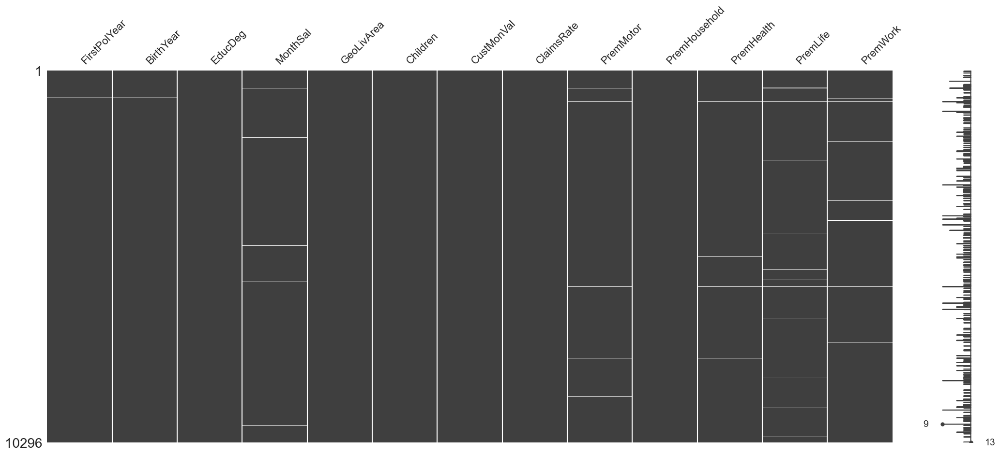

In [29]:
msno.matrix(df_exp)
plt.show()

In [30]:
df_exp.duplicated().sum()

3

There are 3 duplicates.

In [31]:
df_exp.describe().T

,count,mean,std,min,25%,50%,75%,max
FirstPolYear,10266.0,1991.062634,511.267913,1974.00,1980.00,1986.00,1992.0000,53784.00
BirthYear,10279.0,1968.007783,19.709476,1028.00,1953.00,1968.00,1983.0000,2001.00
MonthSal,10260.0,2506.667057,1157.449634,333.00,1706.00,2501.50,3290.2500,55215.00
GeoLivArea,10295.0,2.709859,1.266291,1.00,1.00,3.00,4.0000,4.00
Children,10275.0,0.706764,0.455268,0.00,0.00,1.00,1.0000,1.00
CustMonVal,10296.0,177.892605,1945.811505,-165680.42,-9.44,186.87,399.7775,11875.89
ClaimsRate,10296.0,0.742772,2.916964,0.00,0.39,0.72,0.9800,256.20
PremMotor,10262.0,300.470252,211.914997,-4.11,190.59,298.61,408.3000,11604.42
PremHousehold,10296.0,210.431192,352.595984,-75.00,49.45,132.80,290.0500,25048.80
PremHealth,10253.0,171.580833,296.405976,-2.11,111.80,162.81,219.8200,28272.00


In [32]:
metric_features = ['FirstPolYear','BirthYear','MonthSal','CustMonVal','ClaimsRate','PremMotor','PremHousehold','PremHealth',
                  'PremLife','PremWork']
cat_features = ['GeoLivArea','Children','EducDeg_enc']

### 2.2. Exploring each variable from the dataset

#### Boxplot of every variable 

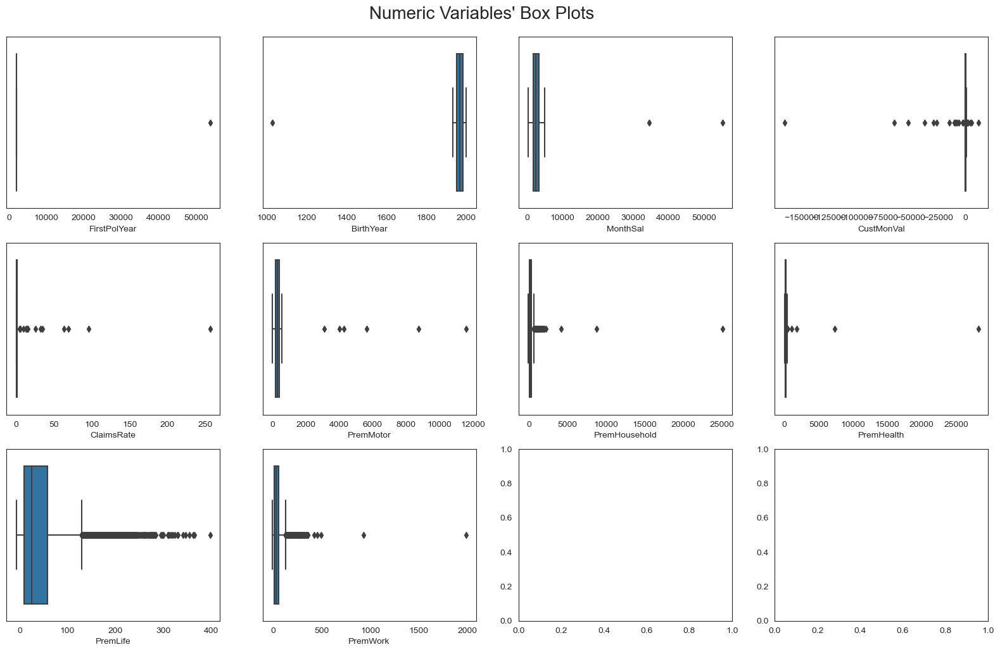

In [33]:
# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(3, math.ceil(len(metric_features) / 3), figsize=(20, 12))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=df_exp[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title,fontsize=20,y=0.92)

plt.show()

#### Histogram of every variable

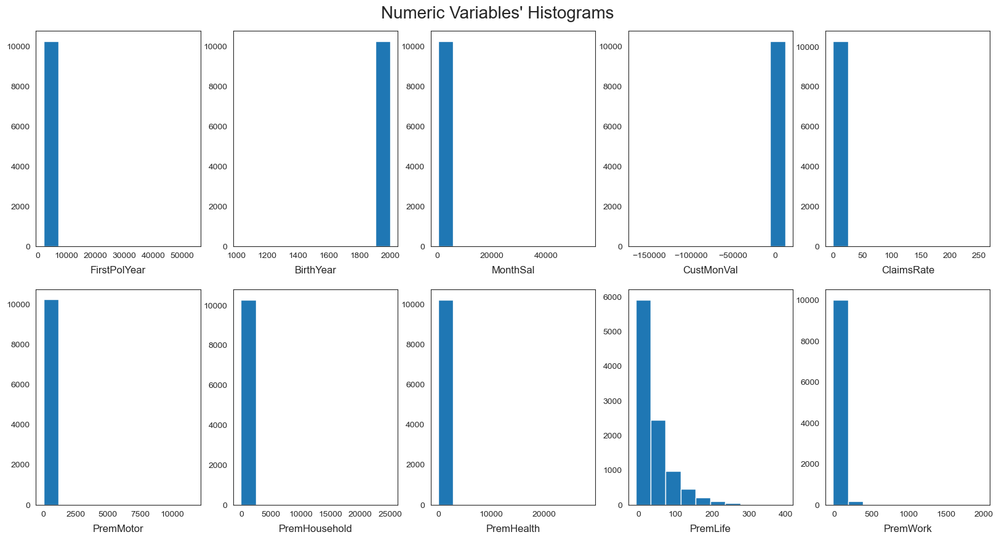

In [34]:
# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, math.ceil(len(metric_features) / 2), figsize=(20, 10))

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    ax.hist(df_exp[feat])
    ax.set_title(feat, y=-0.15)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title,fontsize=20,y=0.92)

plt.show()

- __`First policy year`__

In [35]:
print(sorted(df_exp['FirstPolYear'].drop_duplicates().values))

[1974.0, 1975.0, 1976.0, 1977.0, 1978.0, 1979.0, 1980.0, 1981.0, 1982.0, 1983.0, 1984.0, 1985.0, 1986.0, 1987.0, 1988.0, 1989.0, 1990.0, 1991.0, 1992.0, 1993.0, 1994.0, 1995.0, 1996.0, 1997.0, 1998.0, nan, 53784.0]


We can see that we have missing values and also a year which can not be correct, 53784. Let's see the value counts for those two weirder values.

In [36]:
print('Nr of NaN:',df_exp['FirstPolYear'].isna().sum(),'\nNr of values with weird year:',df_exp['FirstPolYear'].value_counts().loc[53784.0])

Nr of NaN: 30 
Nr of values with weird year: 1


__Decision__: When we do preprocessing later on, treat this observation as having a missing value in first policy year.

In [37]:
df_exp.loc[df_exp['FirstPolYear'] == 53784.0,'FirstPolYear'] = np.nan

In [38]:
print(sorted(df_exp['FirstPolYear'].drop_duplicates().values))

[1974.0, 1975.0, 1976.0, 1977.0, 1978.0, 1979.0, 1980.0, 1981.0, 1982.0, 1983.0, 1984.0, 1985.0, 1986.0, 1987.0, 1988.0, 1989.0, 1990.0, 1991.0, 1992.0, 1993.0, 1994.0, 1995.0, 1996.0, 1997.0, 1998.0, nan]


In [39]:
print('Nr of NaN:',df_exp['FirstPolYear'].isna().sum())

Nr of NaN: 31


- __Birth Year__

In [40]:
print(sorted(df_exp['BirthYear'].drop_duplicates().values))

[1028.0, 1935.0, 1936.0, 1937.0, 1938.0, 1939.0, 1940.0, 1941.0, 1942.0, 1943.0, 1944.0, 1945.0, 1946.0, 1947.0, 1948.0, 1949.0, 1950.0, 1951.0, 1952.0, 1953.0, 1954.0, 1955.0, 1956.0, 1957.0, 1958.0, 1959.0, 1960.0, 1961.0, 1962.0, 1963.0, 1964.0, 1965.0, 1966.0, 1967.0, 1968.0, 1969.0, 1970.0, 1971.0, 1972.0, 1973.0, 1974.0, 1975.0, 1976.0, 1977.0, 1978.0, 1979.0, 1980.0, 1981.0, 1982.0, 1983.0, 1984.0, 1985.0, 1986.0, 1987.0, 1988.0, 1989.0, 1990.0, 1991.0, 1992.0, 1993.0, 1994.0, 1995.0, 1996.0, 1997.0, 1998.0, 1999.0, 2000.0, nan, 2001.0]


Someone born in 1028, not possible. Typo or wrong observation?

In [41]:
df_exp[df_exp['BirthYear'] == 1028]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
7196.0,1993.0,1028.0,b'3 - BSc/MSc',2830.0,4.0,0.0,146.02,0.77,428.97,192.8,108.91,1.89,23.67


In [42]:
print('Nr of NaN:',df_exp['BirthYear'].isna().sum())

Nr of NaN: 17


__Decision__: Treat this observation as having a missing value in Birth Year.

In [43]:
df_exp.loc[df_exp['BirthYear'] == 1028, 'BirthYear'] = np.nan

In [44]:
print('Nr of NaN:', df_exp['BirthYear'].isna().sum())

Nr of NaN: 18


- __Education Degree__

It's our only categorical variable. It seems like it can bee ordinal encoded.

In [45]:
print(df_exp['EducDeg'].drop_duplicates().values)

[b'2 - High School' b'1 - Basic' b'3 - BSc/MSc' b'4 - PhD' nan]


In [46]:
df_exp['EducDeg'].value_counts()

b'3 - BSc/MSc'        4799
b'2 - High School'    3510
b'1 - Basic'          1272
b'4 - PhD'             698
Name: EducDeg, dtype: int64

In [47]:
print('Nr of NaN:',df_exp['EducDeg'].isna().sum())

Nr of NaN: 17


In [48]:
print(list(df_exp['EducDeg'].isna()[df_exp['EducDeg'].isna()==True].index))

[897.0, 1708.0, 2450.0, 2729.0, 2771.0, 3057.0, 4424.0, 6536.0, 6561.0, 7322.0, 7471.0, 8082.0, 8174.0, 8304.0, 9137.0, 9313.0, 9611.0]


In [49]:
print(list(df_exp['BirthYear'].isna()[df_exp['BirthYear'].isna()==True].index))

[420.0, 756.0, 1874.0, 1929.0, 2562.0, 2706.0, 3182.0, 3284.0, 3761.0, 5040.0, 5191.0, 6873.0, 7138.0, 7196.0, 7758.0, 7968.0, 8924.0, 9007.0]


It's a coincidence that the number of NaNs in Birth Year and in EducDeg is the same, above I just checked if they were the same (and therefore if there was any relation of the missing birth year and education degree).

- __Monthly Salary__

In [50]:
print('Nr of NaN:',df_exp['MonthSal'].isna().sum())

Nr of NaN: 36


From the boxplot, there seem to be two outlier values, which can be errors or Bill Gates effect.

In [51]:
print(sorted(df_exp['MonthSal'].drop_duplicates().values)[-3:])

[5021.0, 34490.0, 55215.0]


Yeah, it goes from 5000 monthly salary to 30k. Let's check those clients.

In [52]:
df_exp[(df_exp['MonthSal']==34490.0) | (df_exp['MonthSal']==55215.0) ]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
5883.0,1995.0,1956.0,b'2 - High School',55215.0,4.0,1.0,122.25,0.79,281.83,147.25,130.58,84.46,66.68
8262.0,1981.0,1991.0,b'2 - High School',34490.0,4.0,0.0,608.89,0.28,57.01,358.95,195.26,113.80,161.14


Nothing seems out of the ordinary with these clients (they even only have high school education).

- __Living Area__

In [53]:
df_exp['GeoLivArea'].drop_duplicates().values

array([ 1.,  4.,  3.,  2., nan])

In [54]:
print('Nr of NaN:',df_exp['GeoLivArea'].isna().sum())

Nr of NaN: 1


In [55]:
df_exp[df_exp['GeoLivArea'].isna()]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
297.0,NaN,1955.0,b'4 - PhD',3591.0,NaN,NaN,-49.11,1.04,447.64,-25.0,130.58,0.89,12.89


This specific entry has nans in first policy year, area and children.

- __Children__

In [56]:
df_exp['Children'].drop_duplicates().values

array([ 1.,  0., nan])

In [57]:
print('Nr of NaN:',df_exp['Children'].isna().sum())

Nr of NaN: 21


- __Customer Monetary Value__

In [58]:
print('Nr of NaN:',df_exp['CustMonVal'].isna().sum())

Nr of NaN: 0


This feature has many outliers, as we can see in its boxplot.

In [59]:
print(sorted(df_exp['CustMonVal'].drop_duplicates().values)[-5:])

[2054.07, 2314.21, 4328.5, 5596.84, 11875.89]


In [60]:
print(sorted(df_exp['CustMonVal'].drop_duplicates().values)[:20])

[-165680.42, -64891.0, -52382.76, -37327.08, -28945.4, -26130.45, -14714.08, -10198.91, -10107.37, -8719.04, -7851.17, -6115.85, -2642.91, -2082.83, -490.2, -416.73, -406.07, -402.96, -386.18, -382.4]


I mean, makes sense that there are some very costly clients (if the acquisition cost is very high). But it may not make sense for segmentation to keep them in mind, as they will be a minority.

- __Claims Rate__

In [61]:
print('Nr of NaN:',df_exp['ClaimsRate'].isna().sum())

Nr of NaN: 0


If above one, the company is losing money on that client.

In [62]:
df_exp[(df_exp['ClaimsRate'] > 1)]['ClaimsRate'].count()/df_exp.shape[0]

0.17317404817404816

A2Z is losing money in 17% of its customers.

- __All the Premiums__

All premiums seem to have a lot of outliers.

In [63]:
print('Nr of NaN:',df_exp['PremMotor'].isna().sum())

Nr of NaN: 34


In [64]:
print('Nr of NaN:',df_exp['PremHousehold'].isna().sum())

Nr of NaN: 0


In [65]:
print('Nr of NaN:',df_exp['PremHealth'].isna().sum())

Nr of NaN: 43


In [66]:
print('Nr of NaN:',df_exp['PremLife'].isna().sum())

Nr of NaN: 104


In [67]:
print('Nr of NaN:',df_exp['PremWork'].isna().sum())

Nr of NaN: 86


### 2.3. Correlation

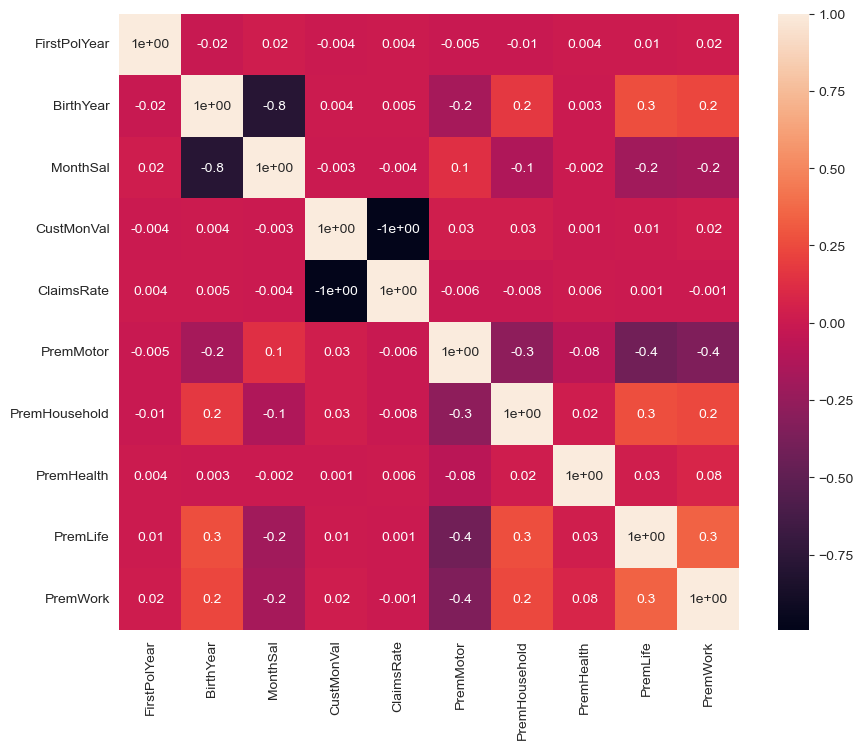

In [68]:
plt.figure(figsize= (10,8))
sns.heatmap(data = df_exp[metric_features].corr(), annot = True, fmt='.1')

plt.show()

Claims Rate is 100% correlated with CMV.

### 2.4. Checking for incoherencies

In [69]:
df_exp[df_exp.drop(['BirthYear','PremLife'],axis=1).duplicated()]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
1874.0,1995.0,NaN,b'1 - Basic',517.0,1.0,1.0,-238.93,1.19,63.68,692.90,98.13,151.14,126.47
8014.0,1987.0,1987.0,b'2 - High School',1912.0,4.0,1.0,290.61,0.58,202.37,177.25,306.39,63.90,-0.11
8122.0,1977.0,1974.0,b'2 - High School',2204.0,4.0,1.0,-22.11,1.00,214.93,88.90,266.94,39.23,42.12
9554.0,1986.0,1952.0,b'2 - High School',3900.0,4.0,0.0,-119.35,1.10,163.03,481.75,224.82,94.35,18.56
9631.0,1993.0,1961.0,b'1 - Basic',2952.0,4.0,1.0,-36.89,1.02,354.40,216.70,116.80,NaN,11.89


#### Let's search for people that don't have any insurance premiums or have only NaNs on them.


In [70]:
df_exp.loc[(df_exp['PremHousehold'] == 0) & (df_exp['PremMotor'].isna()) & (df_exp['PremHealth'].isna()) & (df_exp['PremLife'].isna()) & (df_exp['PremWork'].isna()),:].shape[0]

12

In [71]:
df_exp.loc[(df_exp['PremHousehold'] == 0) & (df_exp['PremMotor'].isna()) & (df_exp['PremHealth'].isna()) & (df_exp['PremLife'].isna()) & (df_exp['PremWork'].isna()),:].index

Float64Index([ 863.0, 1134.0, 3166.0, 4023.0, 4114.0, 4272.0, 5984.0, 6440.0,
              6615.0, 8586.0, 9399.0, 9789.0],
             dtype='float64', name='CustID')

In [72]:
print('PremMotor:\nNr of NaN:',df_exp['PremMotor'].isna().sum(), '\nNr of zeros:',(df['PremMotor'] == 0).sum(),'\n')

print('PremHousehold:\nNr of NaN:',df_exp['PremHousehold'].isna().sum(), '\nNr of zeros:',(df['PremHousehold'] == 0).sum(),'\n')

print('PremHealth:\nNr of NaN:',df_exp['PremHealth'].isna().sum(), '\nNr of zeros:',(df['PremHealth'] == 0).sum(),'\n')

print('PremLife:\nNr of NaN:',df_exp['PremLife'].isna().sum(), '\nNr of zeros:',(df['PremLife'] == 0).sum(),'\n')

print('PremWork:\nNr of NaN:',df_exp['PremWork'].isna().sum(), '\nNr of zeros:',(df['PremWork'] == 0).sum(),'\n')

PremMotor:
Nr of NaN: 34 
Nr of zeros: 0 

PremHousehold:
Nr of NaN: 0 
Nr of zeros: 60 

PremHealth:
Nr of NaN: 43 
Nr of zeros: 0 

PremLife:
Nr of NaN: 104 
Nr of zeros: 0 

PremWork:
Nr of NaN: 86 
Nr of zeros: 0 



In [73]:
df_exp.loc[(df_exp['PremHousehold'] == 0) & (df_exp['PremMotor'].isna()) & (df_exp['PremHealth'].isna()) & (df_exp['PremLife'].isna()) & (df_exp['PremWork'].isna()),:]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
863.0,1987.0,1981.0,b'3 - BSc/MSc',2127.0,1.0,1.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN
1134.0,1974.0,1952.0,b'3 - BSc/MSc',3560.0,2.0,0.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN
3166.0,1995.0,1981.0,b'2 - High School',1813.0,4.0,1.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN
4023.0,1995.0,1988.0,b'3 - BSc/MSc',1296.0,3.0,1.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN
4114.0,1991.0,1993.0,b'2 - High School',1073.0,1.0,1.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN
4272.0,1983.0,1988.0,b'3 - BSc/MSc',1458.0,1.0,1.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN
5984.0,1986.0,1959.0,b'3 - BSc/MSc',2745.0,3.0,0.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN
6440.0,1991.0,1956.0,b'3 - BSc/MSc',2375.0,2.0,1.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN
6615.0,1995.0,1997.0,b'1 - Basic',1231.0,1.0,1.0,-25.0,0.0,NaN,0.0,NaN,NaN,NaN


12 people who don't have any kind of values in their premiums besides 0 on House Hold premium. One other thing to notice here is that every premium but household premium has "NaN" but doesn't have any zeroes, which is weird because it is unlikely that everyone has every premium but Household. So, probably, the NaNs in the other premiums are mostly people who don't have any premium of that category. All of them have CustMonVal -25 and ClaimsRate 0 as well.

#### Let's check for people who had their first policy before they were born, which we will assume is impossible.

In [74]:
df_exp[df_exp['FirstPolYear']<df_exp['BirthYear']]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
2.0,1981.0,1995.0,b'2 - High School',677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
14.0,1983.0,2000.0,b'1 - Basic',1043.0,3.0,1.0,-75.12,1.06,44.34,342.85,127.69,267.94,94.46
19.0,1981.0,1982.0,b'1 - Basic',1414.0,3.0,1.0,230.38,0.71,313.17,373.40,121.80,14.78,72.57
23.0,1976.0,1986.0,b'2 - High School',1495.0,1.0,1.0,-89.79,1.08,209.04,308.95,192.48,64.79,54.90
41.0,1994.0,1995.0,b'2 - High School',1177.0,4.0,1.0,121.36,0.84,52.01,455.65,135.47,146.36,148.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10269.0,1987.0,1988.0,b'3 - BSc/MSc',1414.0,3.0,1.0,50.46,0.90,129.58,167.80,184.48,165.92,75.46
10274.0,1989.0,1992.0,b'2 - High School',1035.0,1.0,1.0,293.51,0.58,235.71,195.60,103.13,170.92,58.12
10285.0,1980.0,1987.0,b'3 - BSc/MSc',1504.0,4.0,1.0,-1.55,0.96,390.63,29.45,179.70,-6.00,NaN


This is likely just an error of the dataset. There are almost 2000 rows where this happens. It is likely that one of those columns is wrong. But it looks like it is birth year which is wrong, as we'll see below, because:

- ####  There are minors with children:

In [75]:
df_exp.loc[(df_exp['BirthYear'] > 1998) & (df_exp['Children'] == 1),:].shape[0]

87

- #### Minors with salaries above portugal's minimum wage in 2016 (so full time jobs):

In [76]:
df_exp.loc[(df_exp['BirthYear'] > 1998) & (df_exp['MonthSal'] > 530),:].shape[0]

104

- #### Minors with house insurance

In [77]:
df_exp.loc[(df_exp['BirthYear'] > 1998) & (df_exp['PremHousehold'] != 0),:].shape[0]

116

- #### Let's check for minors with more than High School in education

In [78]:
df_exp.loc[(df_exp['BirthYear'] > 1998), 'EducDeg'].drop_duplicates().values

array([b'1 - Basic'], dtype=object)

With all of this, it really looks like the BirthYear column must have those 2000 values wrong. We may not be able to trust this feature, so it is likely that we will remove it.

#### Check for people who pay more insurance than their salary (insurance is anual)

In [79]:
df_exp.loc[(df['MonthSal']*12) <= (df_exp['PremMotor'] + df_exp['PremHousehold'] + df_exp['PremHealth']+df_exp['PremLife']+df_exp['PremWork']),:]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
9150.0,1985.0,1994.0,b'2 - High School',987.0,3.0,1.0,804.05,0.97,26.34,829.05,28272.0,65.68,138.25


Just 1 person. However this just looks like an outlier in health premium, it'll probably be eliminated later.

#### People who don't have a salary but are in the database and have work insurance

In [80]:
df.loc[(df['MonthSal'] == 0),:].shape[0]

0

## 3. Data Pre-processing

In [81]:
df_prep = df.copy()

### 3.1. Ordinal Encoding the Education Variable

In [82]:
df_prep['EducDeg'].unique()

array([b'2 - High School', b'1 - Basic', b'3 - BSc/MSc', b'4 - PhD', nan],
      dtype=object)

In [83]:
educations = df_prep['EducDeg'].unique()

new_educ = [2, 1, 3, 4, np.nan]

dic_educ = {}

for i in range(len(educations)):
    
    dic_educ[educations[i]] = new_educ[i]

df_prep['EducDeg_enc'] = df_prep["EducDeg"].replace(dic_educ)

In [84]:
df_prep = df_prep.drop('EducDeg', axis=1)

In [85]:
df_prep.loc[:,'EducDeg_enc'].drop_duplicates().values

array([ 2.,  1.,  3.,  4., nan])

### 3.2. Dealing with duplicates, outliers and incoherencies

#### Birth Year incoherency

__Decision:__ The BirthYear column has too many incoherent values, so it seems like a good idea to drop it. This is because:

- There are 1997 birth years which are after the first policy year, which doesn't make sense, because a person can't have insurance before they are born;
- There are 87 people which are not yet 18 years old who already have children, which could be possible but unlikely. The fact that some of them have salaries and house insurance and so on just helps to prove that this is likely a mistake;
- There are 104 minors with Monthly salaries above Portugal's minimum wage in 2016 (618.33€), which also could be possible but is really unlikely, as these teenagers would have to work full time while also attending school, because in Portugal until you are 18 it is mandatory to be a student. They could, however, be studying at night, so full time work from 9 to 17 and then night at school. Difficult, but possible.
- There are 116 minors with house insurance, which technically could happen if they are orfans and get the house from their parents but is a really unusual situation;
- When analysing the correlation between features, we saw that this column had a high correlation with the monthly salary. This is not relevant if the column is in fact wrong, but if it wasn't, we would be assured we wouldn't be losing that much information.

In [86]:
df_prep.drop('BirthYear',axis=1,inplace=True)

In [87]:
metric_features = ['FirstPolYear','MonthSal','CustMonVal','ClaimsRate','PremMotor','PremHousehold','PremHealth',
                  'PremLife','PremWork']
cat_features = ['GeoLivArea','Children','EducDeg_enc']

#### Dropping duplicates

In [88]:
df_prep.drop_duplicates(inplace=True)

#### Changing the FirstPolYear wrong year to a missing value

In [89]:
df_prep.loc[df_prep['FirstPolYear'] == 53784.0,'FirstPolYear'] = np.nan

#### Missing values in the Premium features

We decided to impute the premiums' nans with 0, because it makes much more sense that the NaNs in all those premiums are just missing values in terms of "there is no value", hence 0, than for every client to have all premiums except for the Household one which is the only one with zeros.

In [90]:
df_prep['PremMotor'] = df_prep['PremMotor'].fillna(0)
df_prep['PremHealth'] = df_prep['PremHealth'].fillna(0)
df_prep['PremLife'] = df_prep['PremLife'].fillna(0)
df_prep['PremWork'] = df_prep['PremWork'].fillna(0)

#### Dropping Clients with all Premiums 0

In [91]:
df_prep.shape[0]

10292

In [92]:
df_prep.loc[(df_prep['PremHousehold'] == 0) & \
            (df_prep['PremMotor']== 0) & \
            (df_prep['PremHealth']== 0) & \
            (df_prep['PremLife']== 0)\
            & (df_prep['PremWork']== 0),:].shape[0]

12

In [93]:
df_prep.drop(df_prep.loc[(df_prep['PremHousehold'] == 0) & \
            (df_prep['PremMotor']== 0) & \
            (df_prep['PremHealth']== 0) & \
            (df_prep['PremLife']== 0)\
            & (df_prep['PremWork']== 0),:].index,inplace=True)
df_prep.shape[0]

10280

#### Outliers

In [94]:
df_out = df_prep.copy()

- Let's check first with IQR the number of outliers on each individual feature.

In [95]:
q25 = df_out.quantile(.25)
q75 = df_out.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 1.5 * iqr
lower_lim = q25 - 1.5 * iqr

for feature in metric_features:
#     we did imputing before so we dont have to worry about nans
    filters2 = []

    llim = lower_lim[feature]
    ulim = upper_lim[feature]
    filters2.append(df_out[feature].between(llim, ulim))

    filters2 = pd.Series(np.all(filters2, 0))
    df_2 = df_out[filters2.values]
    print('Percentage of data kept after removing outliers in feature {0}:'.format(feature), np.round(df_2.shape[0] / df_out.shape[0], 4))
    if len(filters2.value_counts().values) > 1:
        print((filters2.value_counts().values[1]),'outliers in', feature,'\n')
    else: 
        print('\n')
        
q25 = df_out.quantile(.25)
q75 = df_out.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 1.5 * iqr
lower_lim = q25 - 1.5 * iqr

filters2 = []
for metric in metric_features:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters2.append(df_out[metric].between(llim, ulim))

filters2 = pd.Series(np.all(filters2, 0))
df_2 = df_out[filters2.values]
print('Percentage of data kept after removing all outliers:', np.round(df_2.shape[0] / df_out.shape[0], 4))

Percentage of data kept after removing outliers in feature FirstPolYear: 0.997
31 outliers in FirstPolYear 

Percentage of data kept after removing outliers in feature MonthSal: 0.9963
38 outliers in MonthSal 

Percentage of data kept after removing outliers in feature CustMonVal: 0.9893
110 outliers in CustMonVal 

Percentage of data kept after removing outliers in feature ClaimsRate: 0.9985
15 outliers in ClaimsRate 

Percentage of data kept after removing outliers in feature PremMotor: 0.9994
6 outliers in PremMotor 

Percentage of data kept after removing outliers in feature PremHousehold: 0.9385
632 outliers in PremHousehold 

Percentage of data kept after removing outliers in feature PremHealth: 0.9975
26 outliers in PremHealth 

Percentage of data kept after removing outliers in feature PremLife: 0.9368
650 outliers in PremLife 

Percentage of data kept after removing outliers in feature PremWork: 0.9385
632 outliers in PremWork 

Percentage of data kept after removing all outli

We can see that for some features it doesn't seem like it would affect the data much if we just removed them, but there are too many outliers in some of them (`PremHouseHold`, `PremLife`, `PremWork`) to remove all of them. Furthermore, if we just removed every outlier we have, we would keep only 85% of our original dataset, which is very little.

Seeing this, we will commit to do manual thresholds for the removal of datapoints according to their value in a certain feature. By doing this, we will embrace that we will have outliers in our analysis, but by doing a visual analysis of the boxplots for each value we'll try to keep only the outliers which seem not to be too far a part (subjective value) or isolated from the rest of the data. So, if our outliers aren't that isolated from the rest, they will probably not be harmful to our segmentation. More than that, the absurd values will be removed and incoherent ones already have, so these outliers are just values which are higher or lower because of the client's characteristics.

So, the following thresholds were found by observing each variables' boxplot behaviour and cutting the values from which they start to be more far apart and more isolated from the rest. We really didn't want to cut too many, because we we would later do dbscan and that would get rid of the more dangerous outliers. This is just a first layer of removing really far values from each feature or values that just don't make sense.

In [96]:
filters1 = (
    ((df_prep['FirstPolYear'] < 2017) | df_prep['FirstPolYear'].isna()) #cant be after 2016
    &    
    ((df_prep['MonthSal'] < 30000) | df_prep['MonthSal'].isna()) #keep the nans!
    &
    (((abs(df_prep['CustMonVal']) < 10000))| df_prep['CustMonVal'].isna())
    &
    ((df_prep['ClaimsRate'] < 200)| df_prep['ClaimsRate'].isna())
    &
    ((df_prep['PremMotor'] < 2000)| df_prep['PremMotor'].isna())
    &
    ((df_prep['PremHousehold'] < 10000)| df_prep['PremHousehold'].isna())
    &
    ((df_prep['PremHealth'] < 10000)| df_prep['PremHealth'].isna())
    &
    ((df_prep['PremWork'] < 750)| df_prep['PremWork'].isna())
)

In [97]:
df_filt = df_prep[filters1]
print('Percentage of data kept after removing outliers:', np.round(df_filt.shape[0] / df_prep.shape[0], 4))

Percentage of data kept after removing outliers: 0.998


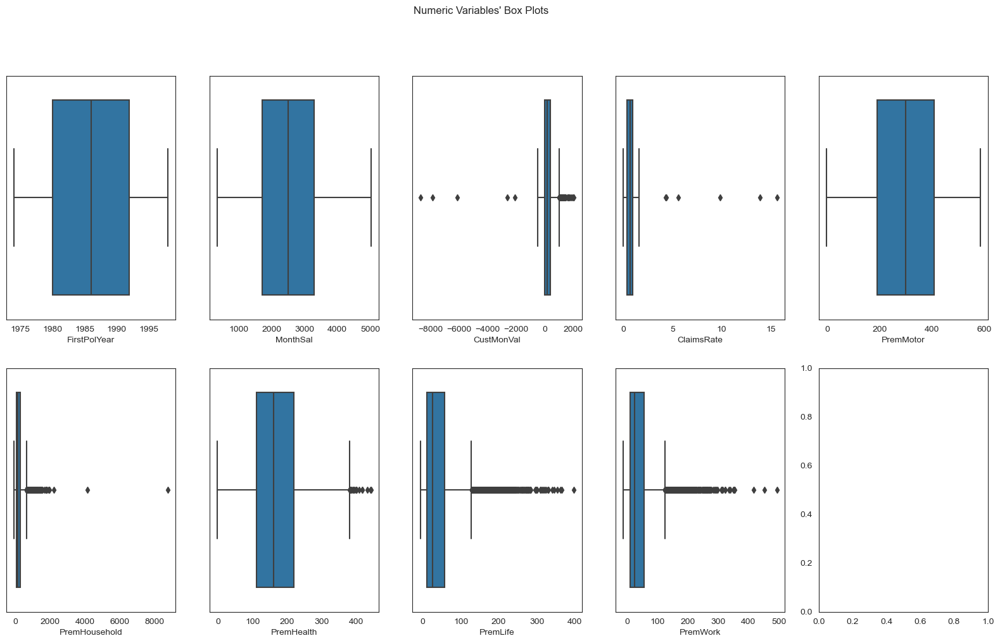

In [98]:
# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, math.ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=df_filt[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

plt.show()

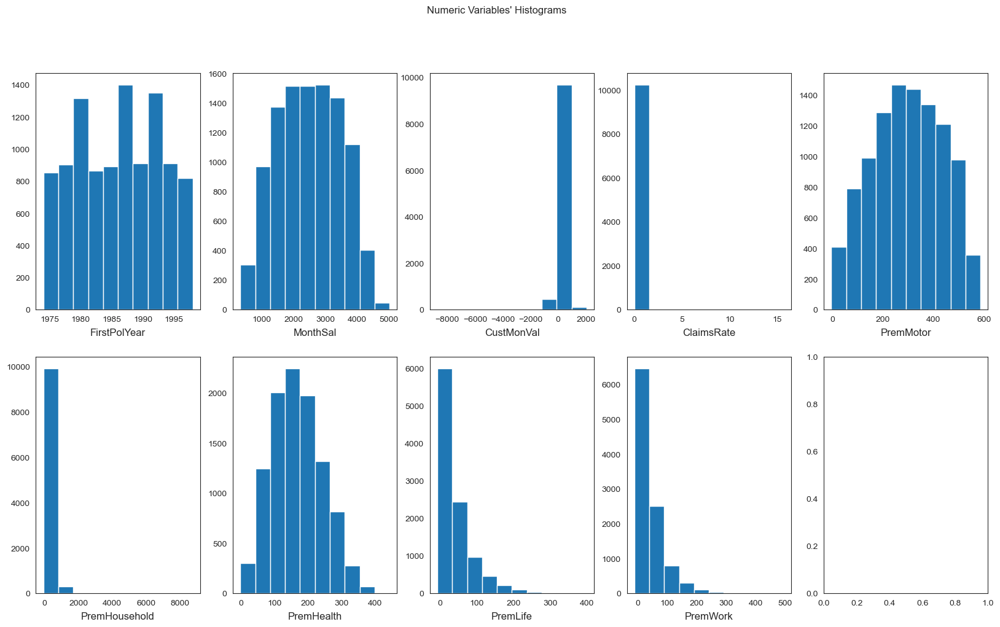

In [99]:
# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, math.ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    ax.hist(df_filt[feat])
    ax.set_title(feat, y=-0.13)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title)

plt.show()

### 3.3. Imputing

In [100]:
df_filt.isnull().sum()

FirstPolYear     31
MonthSal         36
GeoLivArea        1
Children         21
CustMonVal        0
ClaimsRate        0
PremMotor         0
PremHousehold     0
PremHealth        0
PremLife          0
PremWork          0
EducDeg_enc      17
dtype: int64

Because we'll use a distance based imputer, we'll scale the data first, because we want all features to have the same importance when choosing the nearest neighbour. We'll also just use metric features for this, as a distance between categories does not make sense.

In [101]:
scaler = MinMaxScaler()

In [102]:
df_filt_scaled_metric = pd.DataFrame(scaler.fit_transform(df_filt.loc[:,metric_features]),
                              columns = df_filt.loc[:,metric_features].columns, 
                              index = df_filt.loc[:,metric_features].index)

In [103]:
df_filt_scaled = df_filt_scaled_metric.join(df_filt[cat_features])

Checking the minimum and maximun values to see if they change:

In [104]:
df_filt_scaled[(df_filt_scaled['MonthSal'] == df_filt_scaled['MonthSal'].min())]

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,GeoLivArea,Children,EducDeg_enc
CustID,,,,,,,,,,,,
4036.0,0.166667,0.0,0.827955,0.044089,0.200261,0.030556,0.688316,0.235529,0.084094,2.0,1.0,2.0
4276.0,0.000000,0.0,0.835896,0.040895,0.133881,0.043003,0.642111,0.247323,0.220016,4.0,1.0,1.0
4882.0,0.291667,0.0,0.808086,0.063259,0.186687,0.071358,0.207789,0.506440,0.210136,3.0,1.0,2.0


In [105]:
df_filt_scaled[(df_filt_scaled['MonthSal'] == df_filt_scaled['MonthSal'].max())]

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,GeoLivArea,Children,EducDeg_enc
CustID,,,,,,,,,,,,
7511.0,0.208333,1.0,0.807013,0.063898,0.41033,0.035772,0.53871,0.116802,0.120767,1.0,0.0,2.0


In [106]:
index_min_year_before = df_filt_scaled[(df_filt_scaled['FirstPolYear'] == df_filt_scaled['FirstPolYear'].min())].index
df_filt_scaled[(df_filt_scaled['FirstPolYear'] == df_filt_scaled['FirstPolYear'].min())]

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,GeoLivArea,Children,EducDeg_enc
CustID,,,,,,,,,,,,
26.0,0.0,0.734428,0.844263,0.026198,0.658120,0.020243,0.351147,0.060597,0.054890,2.0,0.0,4.0
293.0,0.0,0.604522,0.796966,0.070288,0.292094,0.077457,0.492011,0.250062,0.051156,4.0,1.0,2.0
321.0,0.0,0.499573,0.844418,0.019808,0.741656,0.006789,0.331416,0.036738,0.052914,4.0,1.0,3.0
343.0,0.0,0.756186,0.851578,0.010224,0.843110,0.006727,0.188058,0.049075,0.029421,4.0,1.0,4.0
355.0,0.0,0.225896,0.819856,0.053674,0.230058,0.047908,0.375126,0.431582,0.106935,4.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
9899.0,0.0,0.433874,0.865966,0.005112,0.898359,0.019677,0.112637,0.044140,0.039301,3.0,0.0,4.0
9955.0,0.0,0.092790,0.770651,0.099042,0.043745,0.023954,0.066431,0.455983,0.716499,4.0,1.0,1.0
10162.0,0.0,0.332338,0.827406,0.044728,0.450121,0.026907,0.518979,0.157661,0.072239,4.0,1.0,3.0


In [107]:
index_max_year_before = df_filt_scaled[(df_filt_scaled['FirstPolYear'] == df_filt_scaled['FirstPolYear'].max())].index
df_filt_scaled[(df_filt_scaled['FirstPolYear'] == df_filt_scaled['FirstPolYear'].max())]

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,GeoLivArea,Children,EducDeg_enc
CustID,,,,,,,,,,,,
24.0,1.0,0.541169,0.836257,0.040895,0.383741,0.045769,0.562937,0.135727,0.090022,4.0,1.0,2.0
66.0,1.0,0.731015,0.821611,0.049840,0.476711,0.028355,0.591905,0.034271,0.011638,1.0,0.0,3.0
280.0,1.0,0.864548,0.827252,0.050479,0.169905,0.069723,0.430816,0.332322,0.202233,1.0,0.0,1.0
507.0,1.0,0.727389,0.805002,0.065176,0.151613,0.071172,0.695553,0.131063,0.072021,1.0,0.0,1.0
628.0,1.0,0.550768,0.813294,0.057508,0.688290,0.018608,0.344405,0.060868,0.066746,1.0,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...
9260.0,1.0,0.190486,0.801237,0.069649,0.573261,0.018987,0.179315,0.191389,0.190595,2.0,0.0,2.0
9393.0,1.0,0.420862,0.801443,0.069649,0.280403,0.020559,0.355395,0.465038,0.142284,4.0,1.0,2.0
9563.0,1.0,0.117961,0.936474,0.005751,0.062037,0.139639,0.203542,0.046065,0.489231,1.0,1.0,1.0


In [108]:
imputer_cat = KNNImputer(n_neighbors = 1) 
imputer_num = KNNImputer()

imputer_cat.fit(df_filt_scaled)
imputer_num.fit(df_filt_scaled)

df_filt_scaled_cat = pd.DataFrame(imputer_cat.transform(df_filt_scaled), 
                          columns =df_filt_scaled.columns,
                          index = df_filt_scaled.index).loc[:,['FirstPolYear','GeoLivArea','Children','EducDeg_enc']]

df_filt_scaled_metric = pd.DataFrame(imputer_num.transform(df_filt_scaled), columns = df_filt_scaled.columns,
                          index = df_filt_scaled.index).drop(['FirstPolYear','GeoLivArea','Children','EducDeg_enc'],axis=1)

Imputing for cat has to be 1 neighbour because the mean for categoricals doesn't make sense. It also is for discrete column First Policy Year because with scaling the mean of the neighbours will be a decimal number that won't correspond to a discrete year.

In [109]:
df_filt_scaled[(df_filt_scaled['MonthSal'] == df_filt_scaled['MonthSal'].min())]

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,GeoLivArea,Children,EducDeg_enc
CustID,,,,,,,,,,,,
4036.0,0.166667,0.0,0.827955,0.044089,0.200261,0.030556,0.688316,0.235529,0.084094,2.0,1.0,2.0
4276.0,0.000000,0.0,0.835896,0.040895,0.133881,0.043003,0.642111,0.247323,0.220016,4.0,1.0,1.0
4882.0,0.291667,0.0,0.808086,0.063259,0.186687,0.071358,0.207789,0.506440,0.210136,3.0,1.0,2.0


In [110]:
df_filt_scaled[(df_filt_scaled['MonthSal'] == df_filt_scaled['MonthSal'].max())]

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,GeoLivArea,Children,EducDeg_enc
CustID,,,,,,,,,,,,
7511.0,0.208333,1.0,0.807013,0.063898,0.41033,0.035772,0.53871,0.116802,0.120767,1.0,0.0,2.0


In [111]:
index_min_year_after = df_filt_scaled[(df_filt_scaled['FirstPolYear'] == df_filt_scaled['FirstPolYear'].min())].index
df_filt_scaled[(df_filt_scaled['FirstPolYear'] == df_filt_scaled['FirstPolYear'].min())]

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,GeoLivArea,Children,EducDeg_enc
CustID,,,,,,,,,,,,
26.0,0.0,0.734428,0.844263,0.026198,0.658120,0.020243,0.351147,0.060597,0.054890,2.0,0.0,4.0
293.0,0.0,0.604522,0.796966,0.070288,0.292094,0.077457,0.492011,0.250062,0.051156,4.0,1.0,2.0
321.0,0.0,0.499573,0.844418,0.019808,0.741656,0.006789,0.331416,0.036738,0.052914,4.0,1.0,3.0
343.0,0.0,0.756186,0.851578,0.010224,0.843110,0.006727,0.188058,0.049075,0.029421,4.0,1.0,4.0
355.0,0.0,0.225896,0.819856,0.053674,0.230058,0.047908,0.375126,0.431582,0.106935,4.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
9899.0,0.0,0.433874,0.865966,0.005112,0.898359,0.019677,0.112637,0.044140,0.039301,3.0,0.0,4.0
9955.0,0.0,0.092790,0.770651,0.099042,0.043745,0.023954,0.066431,0.455983,0.716499,4.0,1.0,1.0
10162.0,0.0,0.332338,0.827406,0.044728,0.450121,0.026907,0.518979,0.157661,0.072239,4.0,1.0,3.0


In [112]:
index_max_year_after = df_filt_scaled[(df_filt_scaled['FirstPolYear'] == df_filt_scaled['FirstPolYear'].max())].index
df_filt_scaled[(df_filt_scaled['FirstPolYear'] == df_filt_scaled['FirstPolYear'].max())]

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,GeoLivArea,Children,EducDeg_enc
CustID,,,,,,,,,,,,
24.0,1.0,0.541169,0.836257,0.040895,0.383741,0.045769,0.562937,0.135727,0.090022,4.0,1.0,2.0
66.0,1.0,0.731015,0.821611,0.049840,0.476711,0.028355,0.591905,0.034271,0.011638,1.0,0.0,3.0
280.0,1.0,0.864548,0.827252,0.050479,0.169905,0.069723,0.430816,0.332322,0.202233,1.0,0.0,1.0
507.0,1.0,0.727389,0.805002,0.065176,0.151613,0.071172,0.695553,0.131063,0.072021,1.0,0.0,1.0
628.0,1.0,0.550768,0.813294,0.057508,0.688290,0.018608,0.344405,0.060868,0.066746,1.0,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...
9260.0,1.0,0.190486,0.801237,0.069649,0.573261,0.018987,0.179315,0.191389,0.190595,2.0,0.0,2.0
9393.0,1.0,0.420862,0.801443,0.069649,0.280403,0.020559,0.355395,0.465038,0.142284,4.0,1.0,2.0
9563.0,1.0,0.117961,0.936474,0.005751,0.062037,0.139639,0.203542,0.046065,0.489231,1.0,1.0,1.0


In [113]:
print(np.unique(index_min_year_before==index_min_year_after))
print(np.unique(index_max_year_before==index_max_year_after))

[ True]
[ True]


The maximum and minimum does not change on the variables we've imputed values on.

In [114]:
df_filt_scaled = df_filt_scaled_metric.join(df_filt_scaled_cat)

In [115]:
df_filt_scaled.isnull().sum()

MonthSal         0
CustMonVal       0
ClaimsRate       0
PremMotor        0
PremHousehold    0
PremHealth       0
PremLife         0
PremWork         0
FirstPolYear     0
GeoLivArea       0
Children         0
EducDeg_enc      0
dtype: int64

### 3.4. Checking multidimensional outliers

#### Let's use density based clustering to check for outliers in the context of the whole set of features and not individual features

In [116]:
df_dbscan = df_filt_scaled.copy()

In [117]:
len(metric_features)*2

18

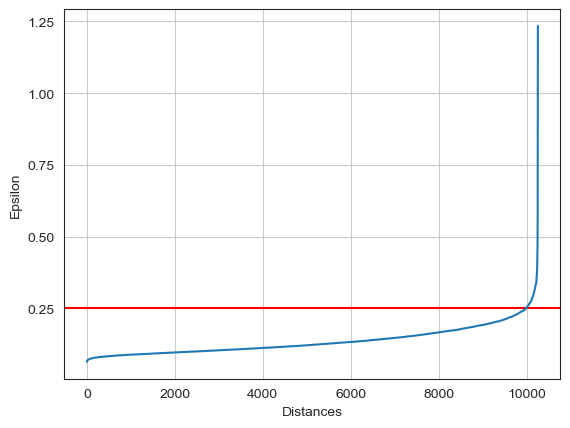

In [118]:
# K-distance graph to find out the right eps value in DBSCAN
neigh = NearestNeighbors(n_neighbors=18)
neigh.fit(df_dbscan[metric_features])
distances, _ = neigh.kneighbors(df_dbscan[metric_features])
distances = np.sort(distances[:, -1])
plt.axhline(y = 0.25, color = 'r', linestyle = '-')
plt.yticks([0,0.25,0.5,0.75,1,1.25])
plt.plot(distances)
plt.ylabel('Epsilon')
plt.xlabel('Distances')
plt.grid()
plt.show()

The right epsilon is about 0.25. The right min_samples is usually 2 x dimensions = 18

In [119]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=0.25, min_samples=18, n_jobs=4)
dbscan_labels = dbscan.fit_predict(df_filt_scaled[metric_features])

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 2


In [120]:
# Concatenating the labels to df
df_dbscan_labeled = pd.concat([df_dbscan, pd.Series(dbscan_labels, index=df_dbscan.index, name="dbscan_labels")], axis=1)

In [121]:
# df_dbscan_labeled

In [122]:
# Detecting noise (potential outliers)
len(df_dbscan_labeled.loc[df_dbscan_labeled['dbscan_labels'] == -1])

51

In [123]:
round(len(df_dbscan_labeled.loc[df_dbscan_labeled['dbscan_labels'] == -1])/len(df_dbscan),3)

0.005

There are 51 multivariable outliers, so around 0.6% of our data. Removing them, we'll keep 99% of the data, which is good.

In [124]:
(len(df_dbscan)-51)/len(df)

0.9914529914529915

In [125]:
df_treated = df_filt_scaled.drop(df_dbscan_labeled.loc[df_dbscan_labeled['dbscan_labels'] == -1].index,axis=0)

In [126]:
df_filt_unscaled = df_filt.drop(df_dbscan_labeled.loc[df_dbscan_labeled['dbscan_labels'] == -1].index,axis=0)

In [127]:
len(df_treated)/len(data)

0.9914529914529915

In [128]:
#scaling again since we excluded some points
scaler = MinMaxScaler()
df_treated = pd.DataFrame(scaler.fit_transform(df_treated.loc[:,metric_features]),
                              columns = df_treated.loc[:,metric_features].columns, 
                              index = df_treated.loc[:,metric_features].index)

### 3.5. Feature Engineering

In [129]:
df_eng = df_treated.copy()

- As the `ClaimsRate` is the ratio between the amount paid by the insurance company and the premiums (which are the anual prices the customers pay for their insurance), we could get a feature that would tell us if the company is currently (in the last 2 years, this is) losing money on this client (so ClaimsRate above 1, which means the amount paid by the company is greater than the amount paid by the customer).

- Also using `ClaimsRate`, we can actually get how much the company spent in the past 2 years in a customer, using the total premiums paid by the costumer and this feature, this can actually be important to see the characteristics of customers with whom the company spends more. This also implies a feature with the Total Premiums for each customer, which is also good to see which customers are paying more money to the company.

In [130]:
#inversing scaling to create variables with real values
scaler = MinMaxScaler()
scaler.fit_transform(df_filt_unscaled[metric_features])
df_eng_unscaled_metric = pd.DataFrame(scaler.inverse_transform(df_eng.loc[:,metric_features]),
                              columns = df_eng.loc[:,metric_features].columns, 
                              index = df_eng.loc[:,metric_features].index)

In [131]:
df_eng_unscaled = df_eng_unscaled_metric.join(df_filt_scaled[cat_features])

In [132]:
df_eng_unscaled['PremTotal'] = df_eng_unscaled['PremMotor']+ df_eng_unscaled['PremHousehold']+ df_eng_unscaled['PremHealth']+ df_eng_unscaled['PremLife']+ df_eng_unscaled['PremWork']

- Using `MonthSal` we can get the average `Yearly Salary`, and with that we can get the ratio between`PremTotal`and this, so we get an idea of how much a costumer spends of his salary in insurance in a year.

In [133]:
df_eng_unscaled['RatioPremSalary'] = df_eng_unscaled['PremTotal']/df_eng_unscaled['MonthSal']*12

In [134]:
df_eng_unscaled['sqrt_RatioPremSalary'] = np.sqrt(df_eng_unscaled['PremTotal']/df_eng_unscaled['MonthSal']*12)

In [135]:
df_eng_unscaled['LosingMoney2Year'] = (df_eng_unscaled['ClaimsRate'] > 1).values.astype(int)

In [136]:
df_eng_unscaled['CompanySpend2Year'] = df_eng_unscaled['PremTotal']*2*df_eng_unscaled['ClaimsRate']

- Just alike, we could check if a customer brought profit in all the years he's been with a company, seeing if `CustMonVal`, or Lifetime Value is greater than 0 for people who brought profit. __Note: this feature is really similar with the LosingMoney2Year one, because it is likely that customers who brought profit to the company in the last 2 years are the ones who did it over their time with the company.__ Probably one of those features is not needed.

In [137]:
df_eng_unscaled['ProfitableCust'] = (df_eng_unscaled['CustMonVal'] > 0).values.astype(int)

In [138]:
(df_eng_unscaled['ProfitableCust'] == df_eng_unscaled['LosingMoney2Year']).value_counts()

False    9241
True      967
dtype: int64

- Another binary feature telling us if there was a premium reversal or not from the last year in any of the premiums (there are not any people who have their total premium negative) - __idea: is it worth it to separate premium reversals into categories or do we just put 1 if there any of the premiums have been reversed?__

In [139]:
df_eng_unscaled['Reversal'] = ((df_eng_unscaled['PremHousehold'] < 0) | (df_eng_unscaled['PremMotor'] < 0)\
                        | (df_eng_unscaled['PremHealth'] < 0) | (df_eng_unscaled['PremLife'] < 0) \
                        | (df_eng_unscaled['PremWork'] < 0)).values.astype(int)

In [140]:
df_eng_unscaled.Reversal.value_counts()

0    7991
1    2217
Name: Reversal, dtype: int64

There are a lot of people with their premiums (work or life or whatever) reversed.

__Note: Repeat the feature exploration for the new features__

In [141]:
metric_features = ['FirstPolYear','MonthSal','CustMonVal','ClaimsRate','PremMotor','PremHousehold','PremHealth',
                  'PremLife','PremWork','PremTotal','CompanySpend2Year', 'RatioPremSalary', 'sqrt_RatioPremSalary']
cat_features = ['GeoLivArea','Children','EducDeg_enc','LosingMoney2Year','ProfitableCust','Reversal']

In [142]:
scaler = MinMaxScaler()

In [143]:
df_eng_scaled_metric = pd.DataFrame(scaler.fit_transform(df_eng_unscaled.loc[:,metric_features]),
                              columns = df_eng_unscaled.loc[:,metric_features].columns, 
                              index = df_eng_unscaled.loc[:,metric_features].index)

In [144]:
df_eng_scaled = df_eng_scaled_metric.join(df_eng_unscaled.loc[:,cat_features])

In [145]:
df_eng_scaled.head()

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,PremTotal,CompanySpend2Year,RatioPremSalary,sqrt_RatioPremSalary,GeoLivArea,Children,EducDeg_enc,LosingMoney2Year,ProfitableCust,Reversal
CustID,,,,,,,,,,,,,,,,,,,
1.0,0.458333,0.393345,0.342622,0.240741,0.644732,0.077490,0.333663,0.149447,0.079233,0.236313,0.126667,0.050774,0.142863,1.0,1.0,2.0,0,1,0
2.0,0.291667,0.073379,0.119690,0.691358,0.138411,0.246444,0.266984,0.557499,0.323981,0.367097,0.497884,0.292997,0.480726,4.0,1.0,2.0,1,0,0
3.0,0.708333,0.414676,0.396472,0.172840,0.356778,0.150265,0.284716,0.258301,0.304481,0.276305,0.101194,0.055323,0.152539,3.0,0.0,1.0,0,1,0
4.0,0.666667,0.163396,0.169378,0.611111,0.316614,0.059378,0.704047,0.117156,0.110636,0.201735,0.290195,0.106877,0.246593,4.0,1.0,3.0,0,0,0
5.0,0.500000,0.305034,0.192111,0.555556,0.581559,0.061611,0.415084,0.071334,0.146591,0.216956,0.276357,0.062699,0.167630,4.0,1.0,3.0,0,1,0


### 3.6. Feature Selection

In [146]:
new_metric_features = ['PremTotal','CompanySpend2Year','RatioPremSalary','sqrt_RatioPremSalary']

In [147]:
df_eng_scaled[metric_features].skew()

FirstPolYear           -0.021065
MonthSal                0.005739
CustMonVal              0.852419
ClaimsRate             -0.235961
PremMotor              -0.086181
PremHousehold           1.868024
PremHealth              0.297395
PremLife                2.023604
PremWork                2.004580
PremTotal               1.764900
CompanySpend2Year       0.649581
RatioPremSalary         3.983328
sqrt_RatioPremSalary    2.224845
dtype: float64

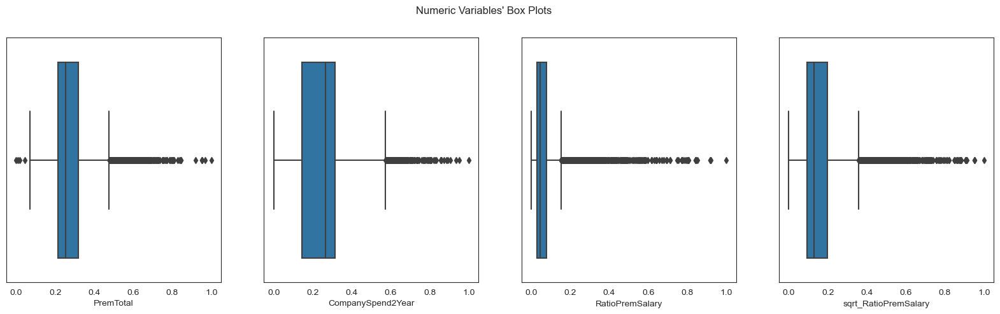

In [148]:
# Prepare figure. Create individual axes where each box plot will be placed
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1,4, figsize=(20, 5))
,
axes = [ax1, ax2, ax3, ax4]

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes, new_metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=df_eng_scaled[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

plt.show()

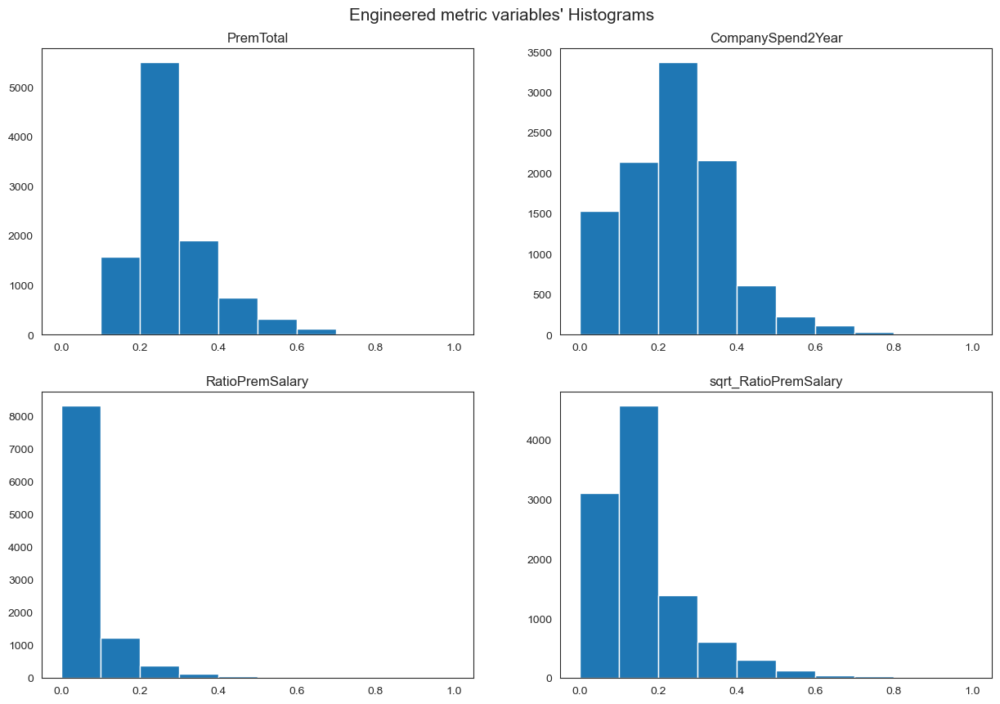

In [149]:
# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):


for ax, feat in zip(axes.flatten(), new_metric_features): # Notice the zip() function and flatten() method
    ax.hist(df_eng_scaled[feat])
    ax.set_title(feat)
# Add a centered title to the figure:
title = "Engineered metric variables' Histograms"

plt.suptitle(title,fontsize=15,y=0.93)

plt.show()

Our dataset, before feature selection, after all the treatment, looks like this:

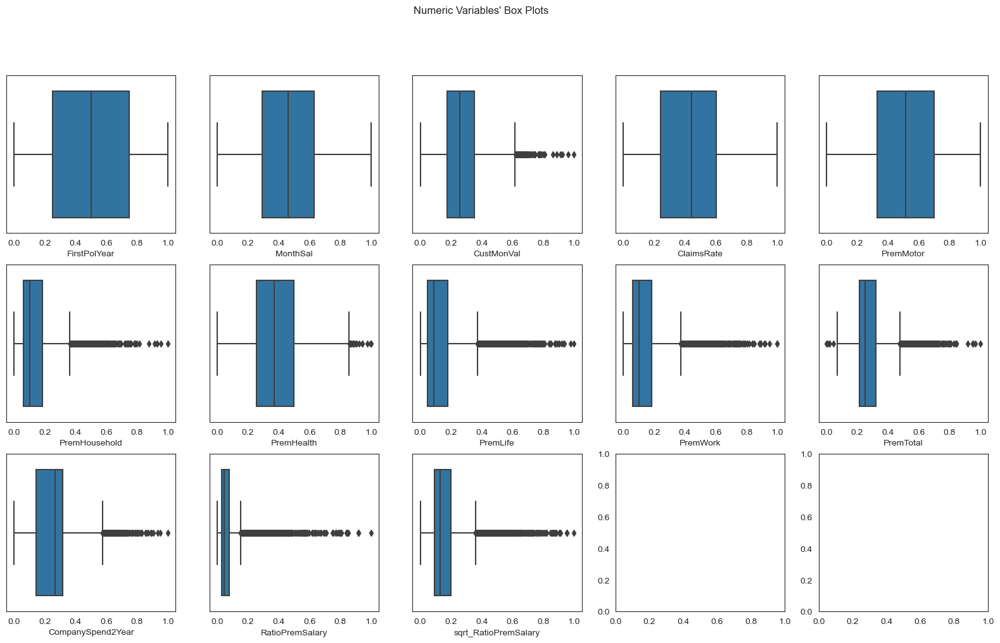

In [150]:
# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(3, math.ceil(len(metric_features) / 3), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=df_eng_scaled[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

plt.show()

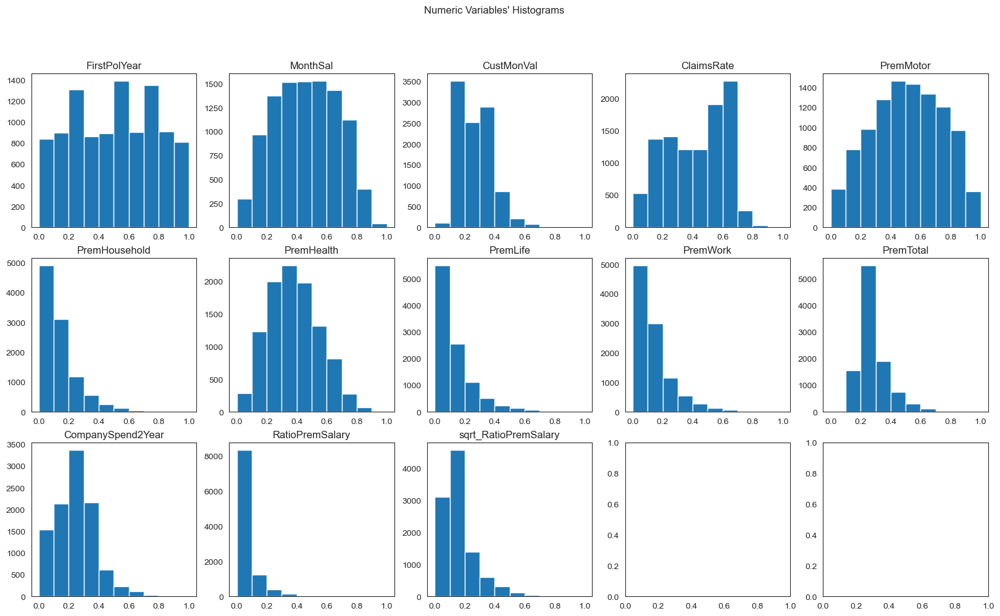

In [151]:
# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(3, math.ceil(len(metric_features) / 3), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    ax.hist(df_eng_scaled[feat])
    ax.set_title(feat)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title)

plt.show()

In [152]:
df_eng_scaled.drop('RatioPremSalary',axis=1,inplace=True)
metric_features.remove('RatioPremSalary')

In [153]:
df_eng_scaled

,FirstPolYear,MonthSal,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,PremTotal,CompanySpend2Year,sqrt_RatioPremSalary,GeoLivArea,Children,EducDeg_enc,LosingMoney2Year,ProfitableCust,Reversal
CustID,,,,,,,,,,,,,,,,,,
1.0,0.458333,0.393345,0.342622,0.240741,0.644732,0.077490,0.333663,0.149447,0.079233,0.236313,0.126667,0.142863,1.0,1.0,2.0,0,1,0
2.0,0.291667,0.073379,0.119690,0.691358,0.138411,0.246444,0.266984,0.557499,0.323981,0.367097,0.497884,0.480726,4.0,1.0,2.0,1,0,0
3.0,0.708333,0.414676,0.396472,0.172840,0.356778,0.150265,0.284716,0.258301,0.304481,0.276305,0.101194,0.152539,3.0,0.0,1.0,0,1,0
4.0,0.666667,0.163396,0.169378,0.611111,0.316614,0.059378,0.704047,0.117156,0.110636,0.201735,0.290195,0.246593,4.0,1.0,3.0,0,0,0
5.0,0.500000,0.305034,0.192111,0.555556,0.581559,0.061611,0.415084,0.071334,0.146591,0.216956,0.276357,0.167630,4.0,1.0,3.0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,0.416667,0.609002,0.176726,0.592593,0.675089,0.062439,0.395352,0.046431,0.073446,0.223522,0.300552,0.084803,2.0,0.0,4.0,0,0,0
10293.0,0.125000,0.447526,0.788674,0.000000,0.233638,0.557284,0.326674,0.055036,0.321239,0.644036,0.000000,0.262077,3.0,0.0,1.0,0,1,0
10294.0,0.833333,0.551408,0.404931,0.129630,0.691870,0.104257,0.324426,0.054427,0.046322,0.252663,0.071349,0.106991,1.0,1.0,3.0,0,1,0


#### Checking Correlation

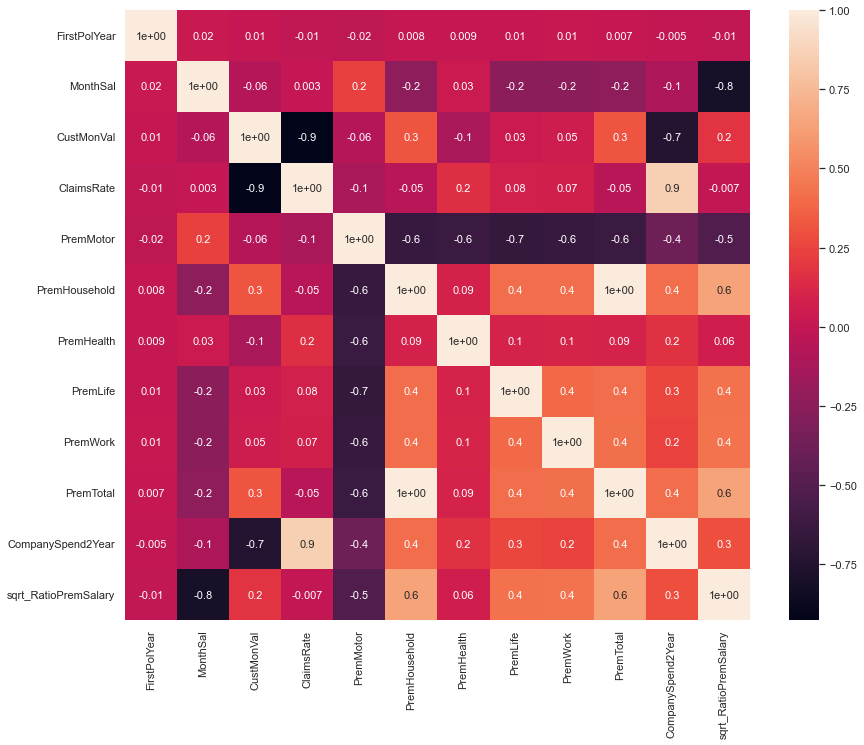

In [412]:
plt.figure(figsize= (14,11))
sns.heatmap(data = df_eng_scaled[metric_features].corr(), annot = True, fmt='.1',annot_kws={'size': 11})

plt.show()

#### Scatterplot of every feature

<Figure size 1008x792 with 0 Axes>

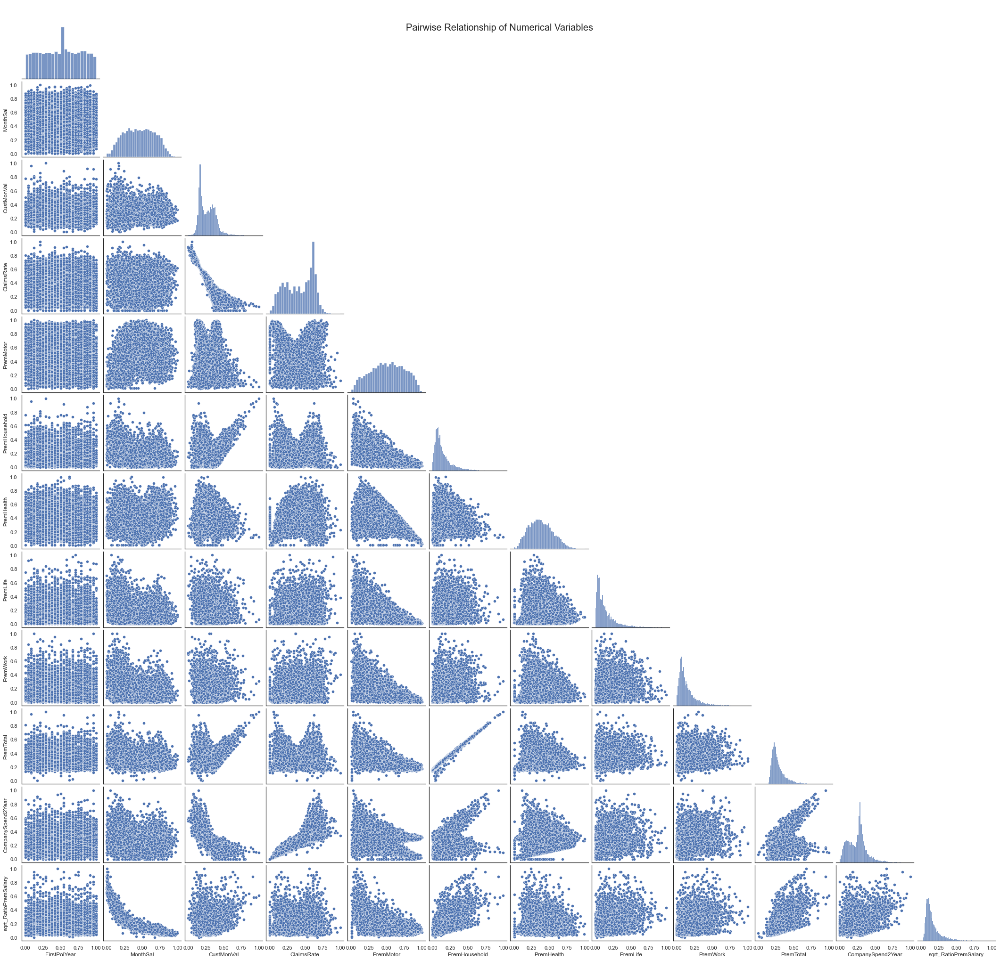

In [413]:
plt.figure(figsize= (14,11))

# Setting pairplot
sns.pairplot(df_eng_scaled[metric_features], diag_kind="hist",corner=True)

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20,y=0.93)
plt.show()

In [159]:
df_featsel = df_eng_scaled.copy()

#### Let's use SOM to finalize the numerical part of feature selection, so when we do dimensionality reduction to then colour by category we aren't using bad numerical features on the datapoints

In [415]:
import sompy
from sompy.visualization.mapview import View2D
from sompy.visualization.bmuhits import BmuHitsView
from sompy.visualization.hitmap import HitMapView

# we import here because it is causing warnings on matplotlib. When using, import again as after using it will be deleted 

In [416]:
df_som = df_featsel.copy()

In [417]:
# This som implementation does not have a random seed parameter
# We're going to set it up ourselves
np.random.seed(42)

sm = sompy.SOMFactory().build(
    df_som[metric_features].values, 
    mapsize=[8, 12],  # NEEDS TO BE A LIST
    initialization='random', 
    neighborhood='gaussian',
    training='batch',
    lattice='hexa',
    component_names=metric_features
)
sm.train(n_job=-1, verbose='info', train_rough_len=100, train_finetune_len=100)

 Training...
 random_initialization took: 0.001000 seconds
 Rough training...
 radius_ini: 4.000000 , radius_final: 1.000000, trainlen: 100

 epoch: 1 ---> elapsed time:  0.057000, quantization error: 6.397049

 epoch: 2 ---> elapsed time:  0.055000, quantization error: 3.159837

 epoch: 3 ---> elapsed time:  0.062000, quantization error: 3.088278

 epoch: 4 ---> elapsed time:  0.082000, quantization error: 3.044111

 epoch: 5 ---> elapsed time:  0.062000, quantization error: 3.024147

 epoch: 6 ---> elapsed time:  0.066000, quantization error: 3.004198

 epoch: 7 ---> elapsed time:  0.056000, quantization error: 2.986394

 epoch: 8 ---> elapsed time:  0.059000, quantization error: 2.977656

 epoch: 9 ---> elapsed time:  0.055000, quantization error: 2.972240

 epoch: 10 ---> elapsed time:  0.060000, quantization error: 2.966016

 epoch: 11 ---> elapsed time:  0.054000, quantization error: 2.959832

 epoch: 12 ---> elapsed time:  0.060000, quantization error: 2.955727

 epoch: 13 ---> 

- Component Planes

In [418]:
len(metric_features)

12

In [419]:
plt.rcParams['figure.dpi'] = 72

In [420]:
weights = sm.codebook.matrix 

In [421]:
###################################
### Visualizing Component Planes ##
###################################

def plot_component_planes(weights,
                          features,
                          M=3, N=4, 
                          figsize=(20,20),
                          figlayout=(3,4),
                          title="Component Planes",
                          cmap=cm.magma
                         ):
    
    xx, yy = np.meshgrid(np.arange(N), np.arange(M))
    xx = xx.astype(float)
    yy = yy.astype(float)

    xx[::-2] -= 0.5

    xx = xx
    yy = yy
    
    
    weights_ = np.flipud(np.flip(weights.reshape((M,N,len(features))),axis=1))

    fig = plt.figure(figsize=figsize, constrained_layout=True)
    subfigs = fig.subfigures(figlayout[0], figlayout[1], wspace=.15)
    
    ## Normalize color scale to range of all values
    colornorm = mpl_colors.Normalize(vmin=np.min(weights), 
                                         vmax=np.max(weights))

    for cpi, sf in zip(range(len(metric_features)), subfigs.flatten()):

        sf.suptitle(features[cpi], y=0.95, fontsize=14)

        axs = sf.subplots(1,1, )
        axs.set_aspect('equal')

        ## Normalize color scale to range of values in each component
        colornorm = mpl_colors.Normalize(vmin=np.min(weights_[:,:,cpi]), 
                                         vmax=np.max(weights_[:,:,cpi]))

        # iteratively add hexagons
        for i in range(weights_.shape[0]):
            for j in range(weights_.shape[1]):
                wy = yy[(i, j)] * np.sqrt(3) / 2
                hexagon = RegularPolygon((xx[(i, j)], wy), 
                                     numVertices=6, 
                                     radius=.99 / np.sqrt(3),
                                     facecolor=cmap(colornorm(weights_[i, j, cpi])), 
                                     alpha=1, 
                                     linewidth=.5,
                                     edgecolor=cmap(colornorm(weights_[i, j, cpi]))
                                    )
                axs.add_patch(hexagon)


        ## only run this block if matplotlib >= 3.6.x
        mplv = [int(i) for i in mplver.split('.')]
        if mplv[1] >= 6:
            ## Add colorbar
            divider = make_axes_locatable(axs)

            ax_cb = divider.append_axes("right", size="7%")#, pad="2%")

            ## Create a Mappable object
            cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
            cmap_sm.set_array([])

            ## Create custom colorbar 
            cb1 = colorbar.Colorbar(ax_cb,
                                    orientation='vertical', 
                                    alpha=1,
                                    mappable=cmap_sm
                                    )
            #cb1.ax.get_yaxis().labelpad = 16

            ## Add colorbar to plot
            sf.add_axes(ax_cb)



        ## Remove axes for hex plot
        axs.margins(.05)
        axs.axis("off")


    fig.suptitle(title, fontsize=16)
    plt.show()

In [422]:
print("matplotlib version is:" , mplver)

matplotlib version is: 3.5.2


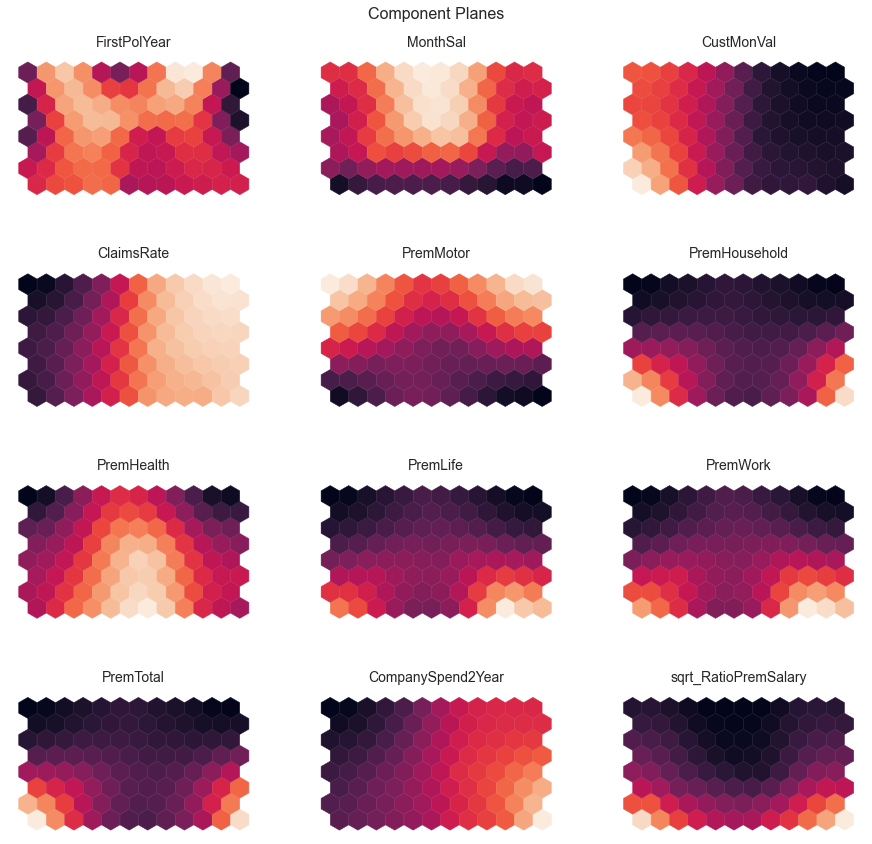

In [423]:
plot_component_planes(weights=sm.codebook.matrix,features=metric_features,
                      M=8,N=12,
                      figsize=(12,12),figlayout=(4,3),
                      title="Component Planes",
                      cmap=sns.color_palette("rocket", as_cmap=True))


All these numerical features seem to show some discriminative power. However, once more, Claims Rate and CustMonVal seem to have the same relationship with the data (even if symetric). So, adding this to the fact that their correlation is really high, one of them will be removed from the dataset. Removal of CustMonVal. We remove this one instead of ClaimsRate (first because of their correlation) because an engineered feature ("ProfitableCust") was made with it, so we are still going to keep information about the lifetime value of a customer in that categorical way, while eliminating a direct relationship between those two variables. This way we seem to reduce noise while not damaging our process.

Besides that, the ratio between premiums and salary seem to give the same information. Because the latter also has information about the total premium, it seems to be more useful for us. Adding to dat, the total premium also has high correlation with household premium and also seems to give almost exactly the same information as it, so it should also be removed.

So, we'll remove the numerical features: MonthlySal, PremTotal and CustMonVal.

- U-matrix

Analyse these plots from the following perspectives: Clusters of units and Potential outliers (units which are very distant from its neighbors and have low frequency)

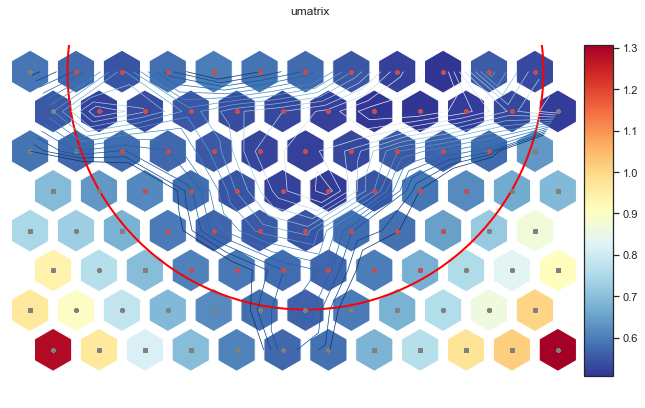

In [424]:
# Here you have U-matrix
u = sompy.umatrix.UMatrixView(9, 9, 'umatrix', show_axis=True, text_size=8, show_text=True)

UMAT = u.show(
    sm, 
    distance=2,
    row_normalized=False,
    show_data=True, 
    contour=True, # Visualize isomorphic curves
    blob=True
)

- Hit-map: show the **frequency** of each Unit in the output map

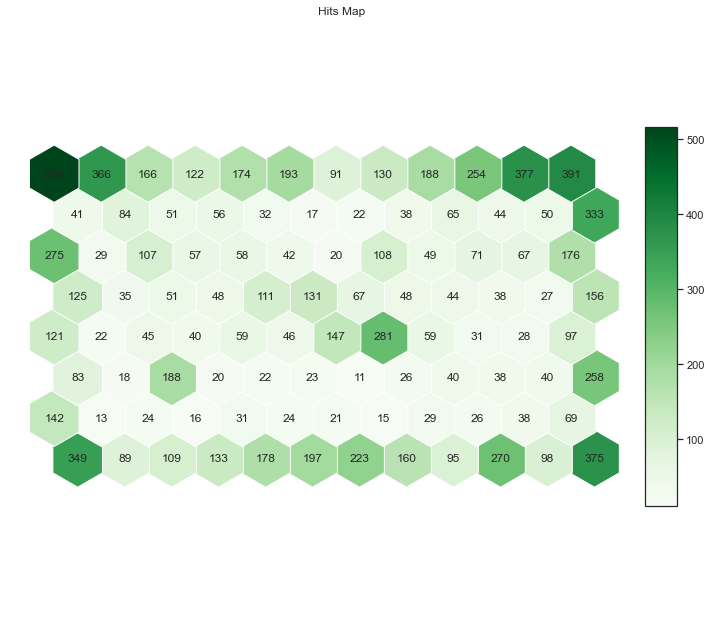

In [425]:
vhts  = BmuHitsView(12,12,"Hits Map")
vhts.show(sm, anotate=True, onlyzeros=False, labelsize=12, cmap="Greens")
plt.show()

In [426]:
del sompy, View2D, BmuHitsView, HitMapView

In [154]:
metric_features.remove('CustMonVal')

In [155]:
metric_features.remove('MonthSal')

In [156]:
metric_features.remove('PremTotal')

In [157]:
metric_features.remove('CompanySpend2Year')

In [160]:
df_featsel_num_done = df_featsel.drop(['CustMonVal','MonthSal','PremTotal', 'CompanySpend2Year'],axis=1)

In [161]:
df_featsel_num_done

,FirstPolYear,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,sqrt_RatioPremSalary,GeoLivArea,Children,EducDeg_enc,LosingMoney2Year,ProfitableCust,Reversal
CustID,,,,,,,,,,,,,,
1.0,0.458333,0.240741,0.644732,0.077490,0.333663,0.149447,0.079233,0.142863,1.0,1.0,2.0,0,1,0
2.0,0.291667,0.691358,0.138411,0.246444,0.266984,0.557499,0.323981,0.480726,4.0,1.0,2.0,1,0,0
3.0,0.708333,0.172840,0.356778,0.150265,0.284716,0.258301,0.304481,0.152539,3.0,0.0,1.0,0,1,0
4.0,0.666667,0.611111,0.316614,0.059378,0.704047,0.117156,0.110636,0.246593,4.0,1.0,3.0,0,0,0
5.0,0.500000,0.555556,0.581559,0.061611,0.415084,0.071334,0.146591,0.167630,4.0,1.0,3.0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,0.416667,0.592593,0.675089,0.062439,0.395352,0.046431,0.073446,0.084803,2.0,0.0,4.0,0,0,0
10293.0,0.125000,0.000000,0.233638,0.557284,0.326674,0.055036,0.321239,0.262077,3.0,0.0,1.0,0,1,0
10294.0,0.833333,0.129630,0.691870,0.104257,0.324426,0.054427,0.046322,0.106991,1.0,1.0,3.0,0,1,0


#### Scatterplots but coloured with the value in the categorical features

- __Children__:

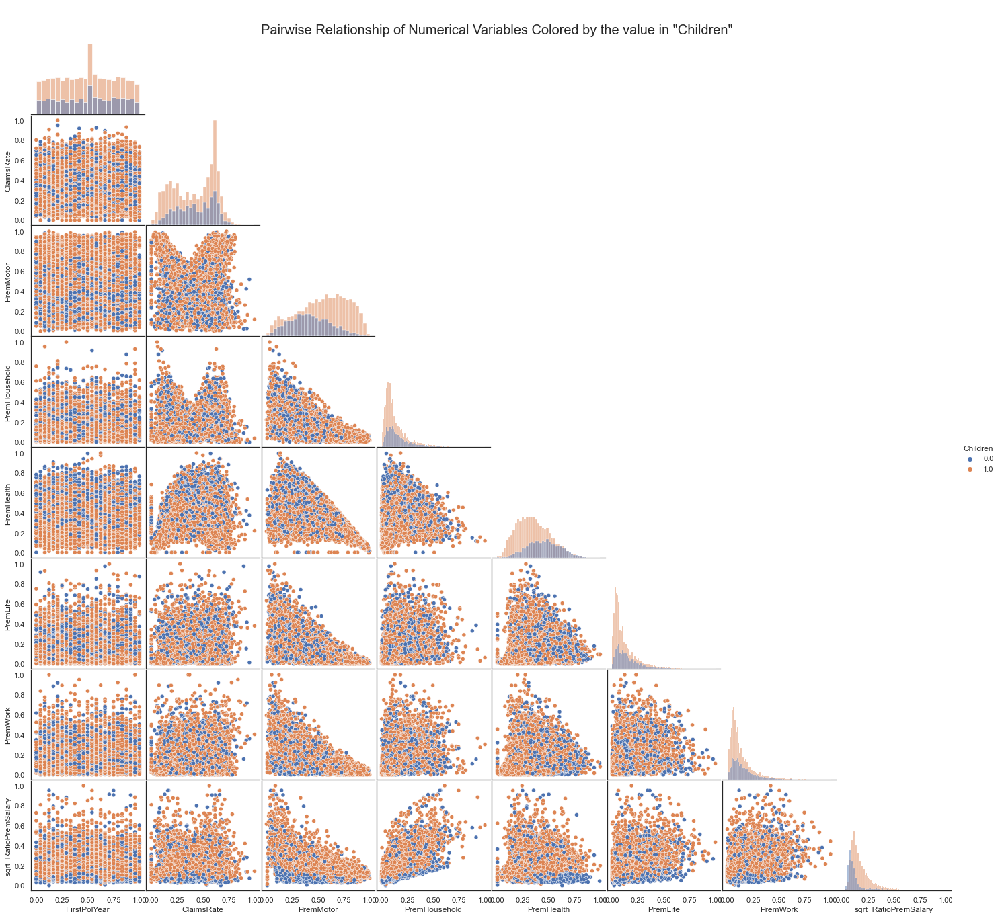

In [433]:
# Setting pairplot
sns.pairplot(df_featsel_num_done[metric_features + ['Children']], diag_kind="hist", hue='Children',corner=True)

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables Colored by the value in \"Children\"", fontsize=20,y=0.93)

plt.show()

- __GeoLivArea__:

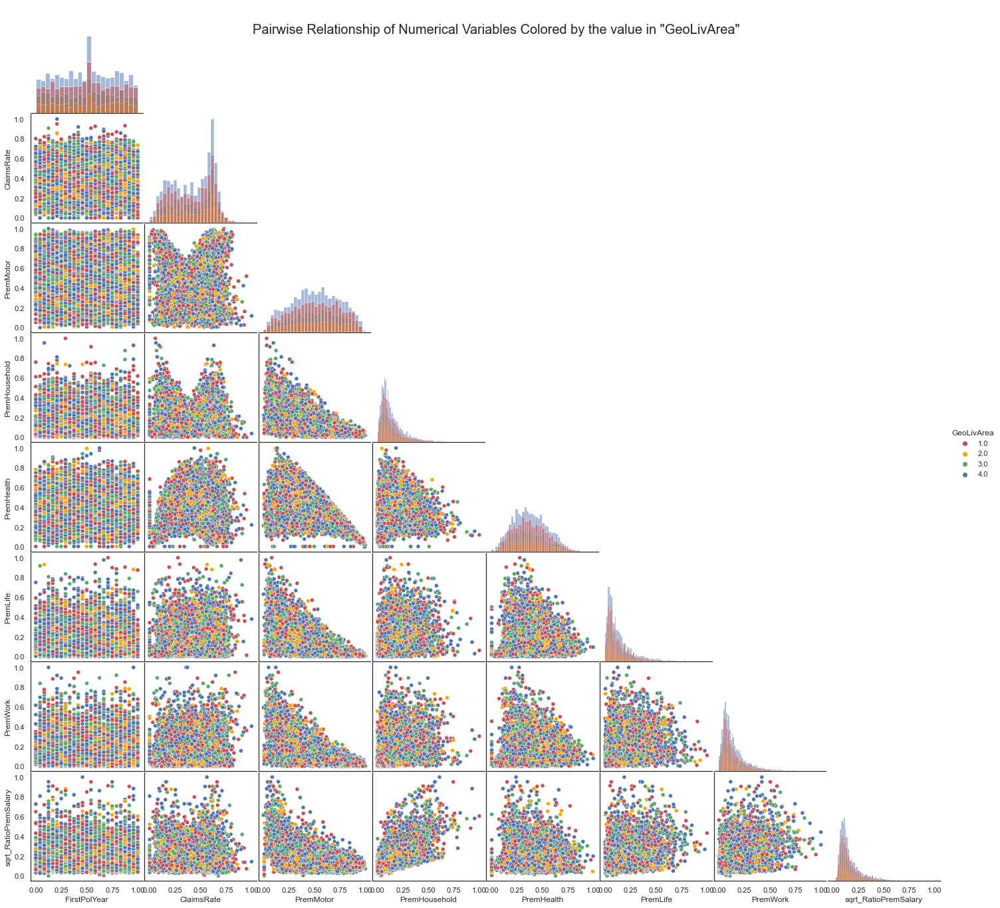

In [434]:
# Setting pairplot
sns.pairplot(df_featsel_num_done[metric_features + ['GeoLivArea']], diag_kind="hist", hue='GeoLivArea',
            palette = ['r','orange','g','b'],corner=True)

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables Colored by the value in \"GeoLivArea\"", fontsize=20,y=0.93)

plt.show()

Can't tell anything. This variable doesn't seem like it has discriminative power. Not even the houosehold premium is influenced by region.

- __EducDeg__:

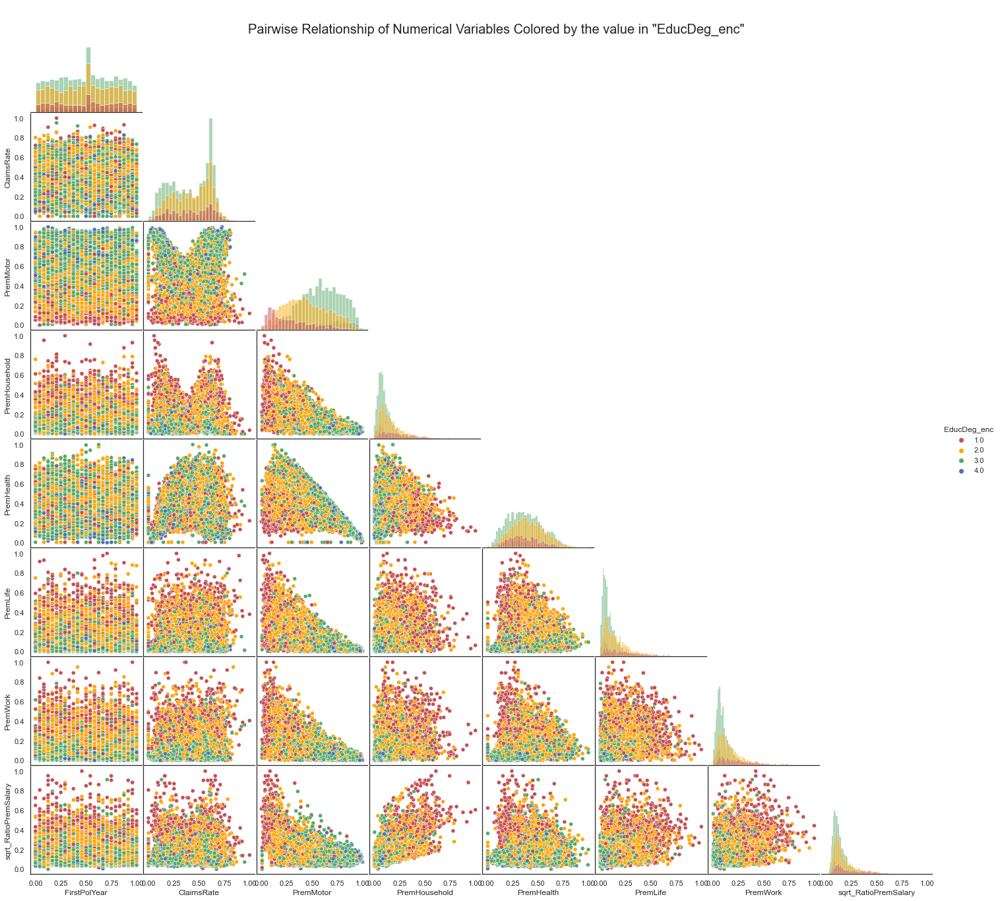

In [435]:
# Setting pairplot
sns.pairplot(df_featsel_num_done[metric_features + ['EducDeg_enc']], diag_kind="hist", hue='EducDeg_enc', 
             palette = ['r','orange','g','b'],corner=True)

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables Colored by the value in \"EducDeg_enc\"", fontsize=20,y=0.93)

plt.show()

Curiously, the higher the education, the higher the spend on Motor insurance, it seems. Even for the same monthly salary, the same happens. But the reverse of that happens with the Work, Life and Household insurance.

- __LosingMoney2Year__:

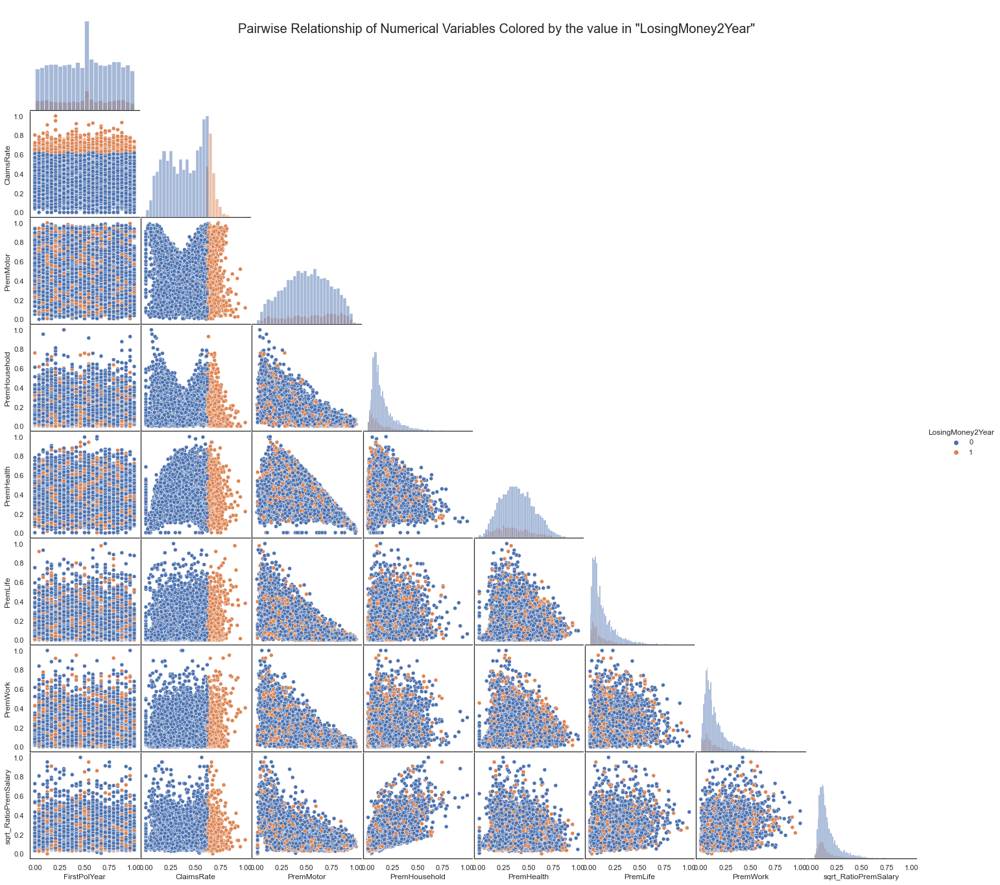

In [436]:
# Setting pairplot
sns.pairplot(df_featsel_num_done[metric_features + ['LosingMoney2Year']], diag_kind="hist", hue='LosingMoney2Year',corner=True)

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables Colored by the value in \"LosingMoney2Year\"", fontsize=20,y=0.93)

plt.show()

Can't tell any differences because the ones where there seems to be discrimination are the features witch either are the ones used to create this categorical feature or very correlated with that one.

- __ProfitableCust__:

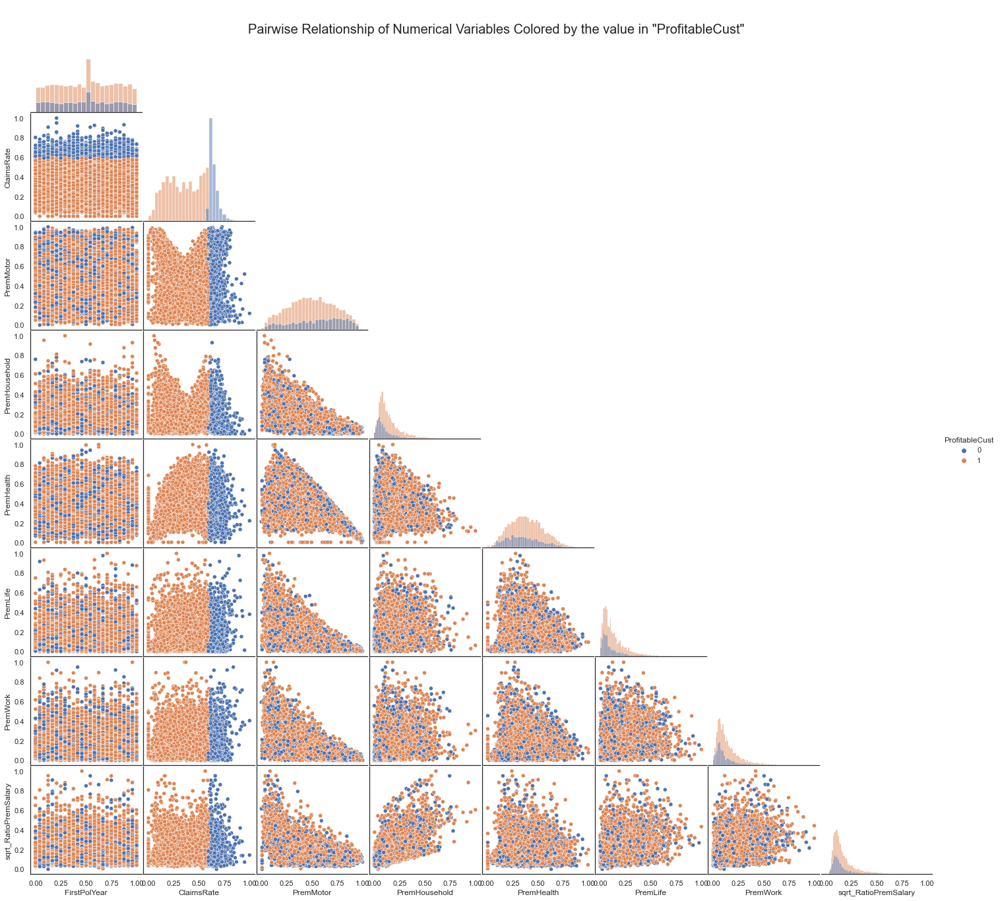

In [437]:
# Setting pairplot
sns.pairplot(df_featsel_num_done[metric_features + ['ProfitableCust']], diag_kind="hist", hue='ProfitableCust',corner=True)

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables Colored by the value in \"ProfitableCust\"", fontsize=20,y=0.93)

plt.show()

Yeah those 2 features are really really similar. Let's remove the LosingMoney2Year one, because the other tells us those 2 years implicitly and goes to all years the customer's been with the insurance company.

- __Reversal__:

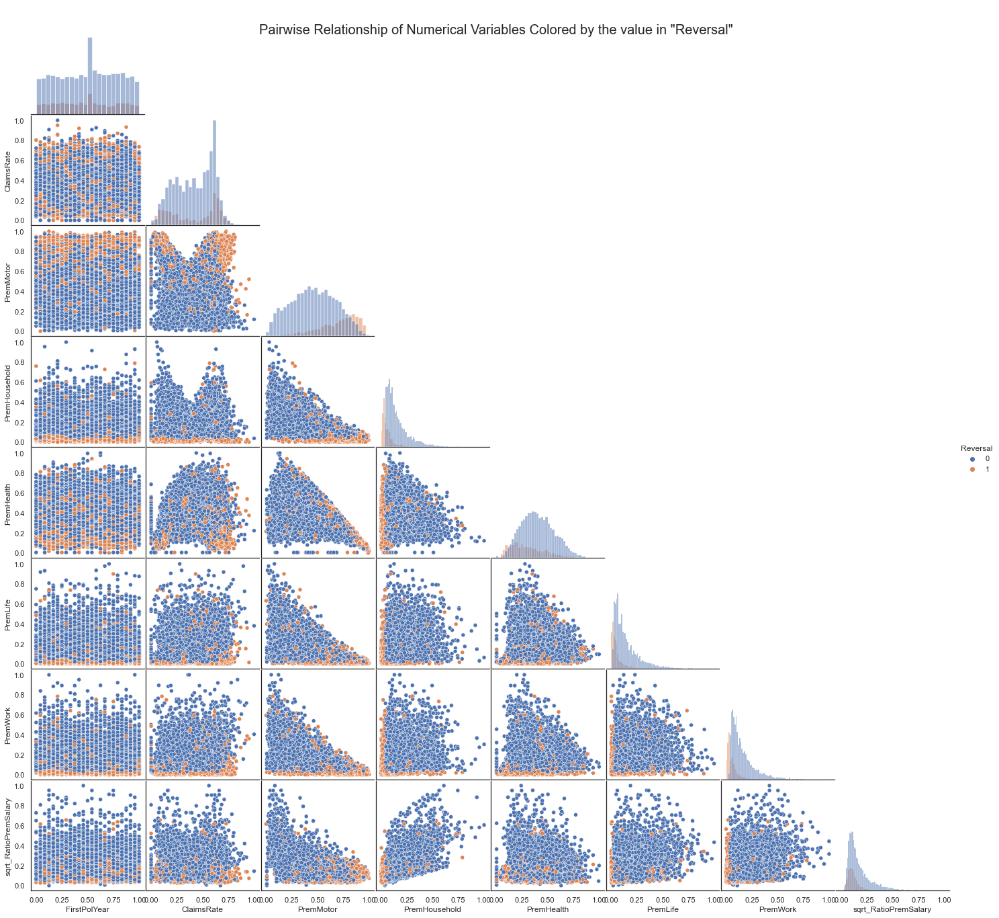

In [438]:
# Setting pairplot
sns.pairplot(df_featsel_num_done[metric_features + ['Reversal']], diag_kind="hist", hue='Reversal',corner=True)

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables Colored by the value in \"Reversal\"", fontsize=20,y=0.93)

plt.show()

From this analysis, we can already exclude LosingMoney2Year, because it basically tells us the same as ProfitableCust. CompanySpend2Year is also perfectly correlated with CustMonVal and ClaimsRate so we won't use it.

In [162]:
df_featsel = df_featsel_num_done.drop(['LosingMoney2Year'],axis=1)

In [163]:
cat_features.remove('LosingMoney2Year')

In [164]:
cat_features

['GeoLivArea', 'Children', 'EducDeg_enc', 'ProfitableCust', 'Reversal']

#### Using TSNE to check these coloured datapoints but all the variables together to see if the categorical features have discriminative power.

In [165]:
df_tsne = df_featsel.copy()

In [172]:
tsne = TSNE(random_state=42,learning_rate=10,init='pca',perplexity = 30)

Careful: TSNE should not be done with categorical or discrete variables, so beyond the categorical we also can not include the FirstPolYear.

In [173]:
tsne_feat = metric_features[:]

In [ ]:
tsne_arr = tsne.fit_transform(df_tsne.loc[:,  tsne_feat])

C:\Users\Pedro\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


In [ ]:
df_tsne['tsne1'] = [tsne_arr[i][0] for i in range(len(tsne_arr))]
df_tsne['tsne2'] = [tsne_arr[i][1] for i in range(len(tsne_arr))]

In [ ]:
df_tsne

In [ ]:
cat_features

In [ ]:
plt.style.use('default')

In [ ]:


# Initialise the subplot function using number of rows and columns

colors = ['darkgreen','darkblue','darkred','orange']
figure, axis = plt.subplots(2, 3,figsize=(20, 13))
figure.suptitle('TSNE plots coloured by the categorical variables', fontsize=16, y=0.93)

axis[0, 0].scatter(df_tsne['tsne1'],df_tsne['tsne2'],c=df_tsne.loc[:, 'GeoLivArea'],alpha=0.7) 
axis[0, 0].set_title('GeoLivArea')
axis[0, 1].scatter(df_tsne['tsne1'],df_tsne['tsne2'],c=df_tsne.loc[:, 'Children'],alpha=0.7)
axis[0, 1].set_title('Children')
axis[0, 2].scatter(df_tsne['tsne1'],df_tsne['tsne2'],c=df_tsne.loc[:, 'EducDeg_enc'],alpha=0.7) 
axis[0, 2].set_title('EducDeg')

axis[1, 0].scatter(df_tsne['tsne1'],df_tsne['tsne2'],c=df_tsne.loc[:, 'ProfitableCust'],alpha=0.7)
axis[1, 0].set_title('ProfitableCust')
axis[1, 1].scatter(df_tsne['tsne1'],df_tsne['tsne2'],c=df_tsne.loc[:, 'Reversal'],alpha=0.7)
axis[1, 1].set_title('Reversal')

# Combine all the operations and display
plt.show()

We see that children, profitable customers and reversal seem to have different parts of the plot, while education a little less but also seems to have differences in position according to its label. GeoLivArea, one more time, seems to be all over the place.

Let's just try to change the perplexity: 

In [451]:
tsne50 = TSNE(random_state=42,learning_rate='auto',init='pca',perplexity = 10)

In [452]:
tsne50 = tsne50.fit_transform(df_tsne.loc[:, tsne_feat]) 

C:\Users\kikal\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:996: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


In [453]:
df_tsne['tsne1_50'] = [tsne50[i][0] for i in range(len(tsne50))]
df_tsne['tsne2_50'] = [tsne50[i][1] for i in range(len(tsne50))]

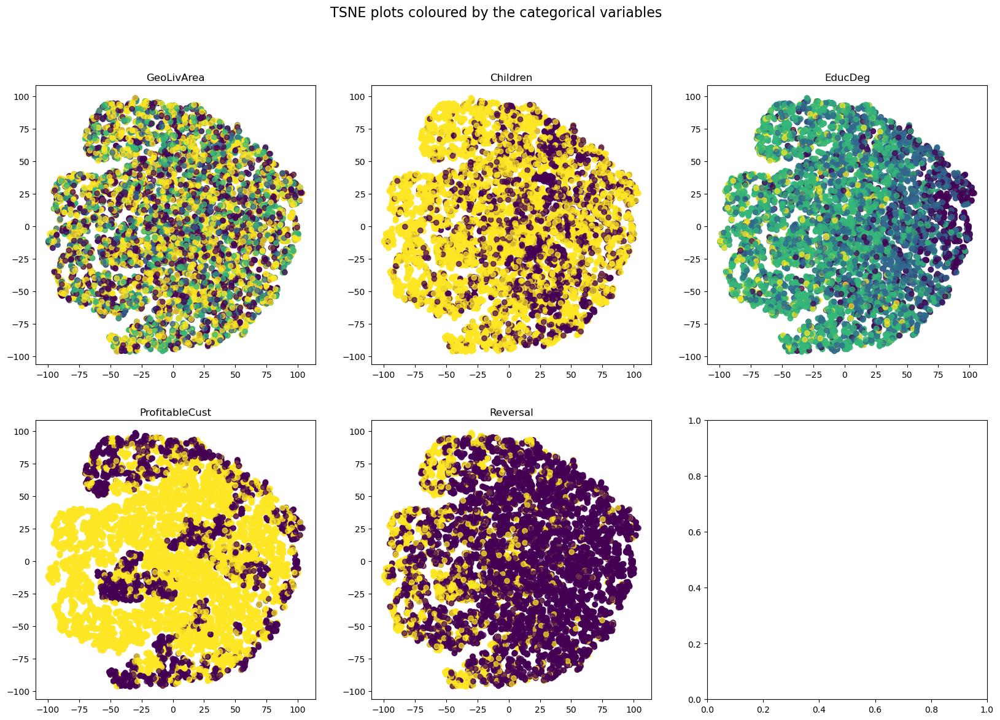

In [454]:
# All in one figure

# Initialise the subplot function using number of rows and columns

figure, axis = plt.subplots(2, 3,figsize=(20, 13))
figure.suptitle('TSNE plots coloured by the categorical variables', fontsize=16)

axis[0, 0].scatter(df_tsne['tsne1_50'],df_tsne['tsne2_50'],c=df_tsne.loc[:, 'GeoLivArea'],alpha=0.7) 
axis[0, 0].set_title('GeoLivArea')
axis[0, 1].scatter(df_tsne['tsne1_50'],df_tsne['tsne2_50'],c=df_tsne.loc[:, 'Children'],alpha=0.7)
axis[0, 1].set_title('Children')
axis[0, 2].scatter(df_tsne['tsne1_50'],df_tsne['tsne2_50'],c=df_tsne.loc[:, 'EducDeg_enc'],alpha=0.7) 
axis[0, 2].set_title('EducDeg')

axis[1, 0].scatter(df_tsne['tsne1_50'],df_tsne['tsne2_50'],c=df_tsne.loc[:, 'ProfitableCust'],alpha=0.7)
axis[1, 0].set_title('ProfitableCust')
axis[1, 1].scatter(df_tsne['tsne1_50'],df_tsne['tsne2_50'],c=df_tsne.loc[:, 'Reversal'],alpha=0.7)
axis[1, 1].set_title('Reversal')

# Combine all the operations and display
plt.show()

The conclusions seem to be the same as the previous plot.

#### Using UMAP now

In [455]:
tsne_feat

['FirstPolYear',
 'ClaimsRate',
 'PremMotor',
 'PremHousehold',
 'PremHealth',
 'PremLife',
 'PremWork',
 'sqrt_RatioPremSalary']

In [456]:
df_umap = df_tsne.copy()

In [457]:
umap_map = umap.UMAP(min_dist=0.5, n_neighbors=30)

In [458]:
umap_arr = umap_map.fit_transform(df_umap.loc[:, tsne_feat]) 

In [459]:
df_umap['umap1'] = [umap_arr[i][0] for i in range(len(umap_arr))]
df_umap['umap2'] = [umap_arr[i][1] for i in range(len(umap_arr))]

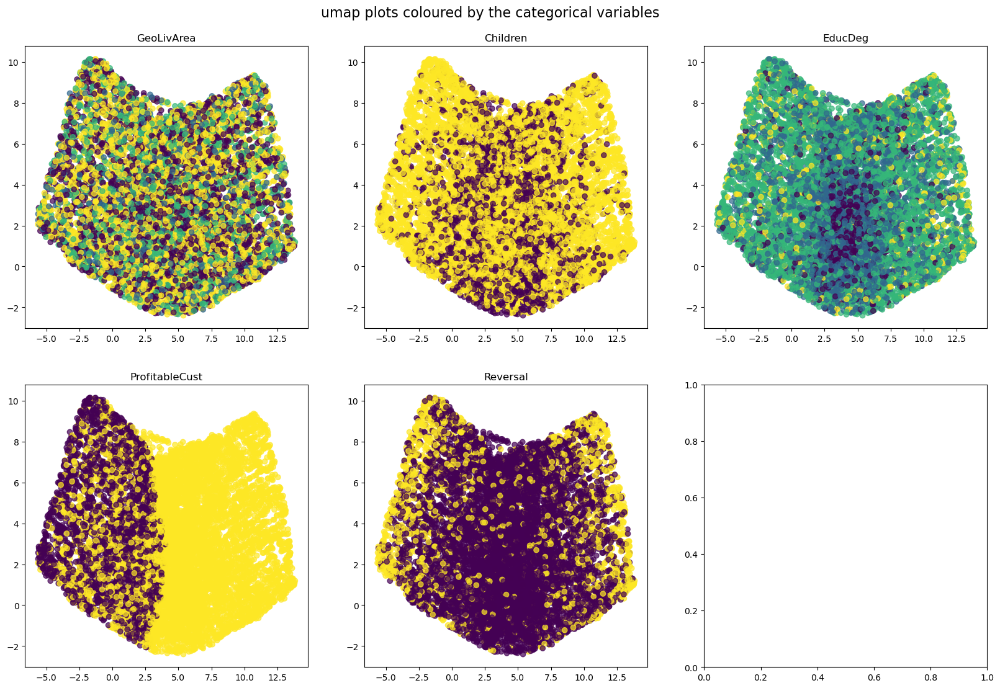

In [460]:
# All in one figure

# Initialise the subplot function using number of rows and columns

figure, axis = plt.subplots(2, 3,figsize=(20, 13))
figure.suptitle('umap plots coloured by the categorical variables', fontsize=16,y=0.93)

axis[0, 0].scatter(df_umap['umap1'],df_umap['umap2'],c=df_umap.loc[:, 'GeoLivArea'],alpha=0.7) 
axis[0, 0].set_title('GeoLivArea')
axis[0, 1].scatter(df_umap['umap1'],df_umap['umap2'],c=df_umap.loc[:, 'Children'],alpha=0.7)
axis[0, 1].set_title('Children')
axis[0, 2].scatter(df_umap['umap1'],df_umap['umap2'],c=df_umap.loc[:, 'EducDeg_enc'],alpha=0.7) 
axis[0, 2].set_title('EducDeg')

axis[1, 0].scatter(df_umap['umap1'],df_umap['umap2'],c=df_umap.loc[:, 'ProfitableCust'],alpha=0.7)
axis[1, 0].set_title('ProfitableCust')
axis[1, 1].scatter(df_umap['umap1'],df_umap['umap2'],c=df_umap.loc[:, 'Reversal'],alpha=0.7)
axis[1, 1].set_title('Reversal')

# Combine all the operations and display
plt.show()

We see that children, profitable customers and reversal seem to have different parts of the plot, while education a little less but also seems to have differences in position according to its label. GeoLivArea, one more time, seems to be all over the place.

__Decision__: Because of all the times that GeoLivArea has shown not to have any kind of discriminative power, this being in reduced datasets or individually plotted features, we have decided to remove it.

In [461]:
df_final = df_featsel_num_done.drop('GeoLivArea',axis=1)

In [462]:
df_final.columns

Index(['FirstPolYear', 'ClaimsRate', 'PremMotor', 'PremHousehold',
       'PremHealth', 'PremLife', 'PremWork', 'sqrt_RatioPremSalary',
       'Children', 'EducDeg_enc', 'LosingMoney2Year', 'ProfitableCust',
       'Reversal'],
      dtype='object')

In [463]:
metric_features

['FirstPolYear',
 'ClaimsRate',
 'PremMotor',
 'PremHousehold',
 'PremHealth',
 'PremLife',
 'PremWork',
 'sqrt_RatioPremSalary']

## 4. Clustering

In [464]:
df_cluster = df_final.copy()

In [465]:
print('These are the final selected features:', list(df_cluster.columns))

These are the final selected features: ['FirstPolYear', 'ClaimsRate', 'PremMotor', 'PremHousehold', 'PremHealth', 'PremLife', 'PremWork', 'sqrt_RatioPremSalary', 'Children', 'EducDeg_enc', 'LosingMoney2Year', 'ProfitableCust', 'Reversal']


In [466]:
cat_features = ['Children', 'EducDeg_enc', 'ProfitableCust', 'Reversal']
metric_features = ['FirstPolYear','ClaimsRate', 'PremMotor', 'PremHousehold', 
                   'PremHealth', 'PremLife', 'PremWork', 'sqrt_RatioPremSalary']

In [467]:
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst
    
def get_r2_scores(df, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2(df, labels)
    return r2_clust


In [468]:
def cluster_profiles(df, label_columns, figsize, title,palette, compar_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=palette, ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1], palette=palette)

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.4, top=0.8)
    plt.suptitle(title, fontsize=23)
    
    plt.show()

In [469]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

# Storing average silhouette metric

def get_silhouette (df,features, min_k=2, max_k =10):
    avg_silhouette = []
    for nclus in range(min_k,max_k):

        # Initialize the KMeans object with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=20, random_state=14)
        cluster_labels = kmclust.fit_predict(df[features])

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed clusters
        silhouette_avg = silhouette_score(df[features], cluster_labels)
        avg_silhouette.append(silhouette_avg)
        print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")



## 4.1. With the entire dataset

### 4.1 DBSCAN

In [470]:
metric_features

['FirstPolYear',
 'ClaimsRate',
 'PremMotor',
 'PremHousehold',
 'PremHealth',
 'PremLife',
 'PremWork',
 'sqrt_RatioPremSalary']

In [471]:
minpts = len(metric_features)*2
minpts

16

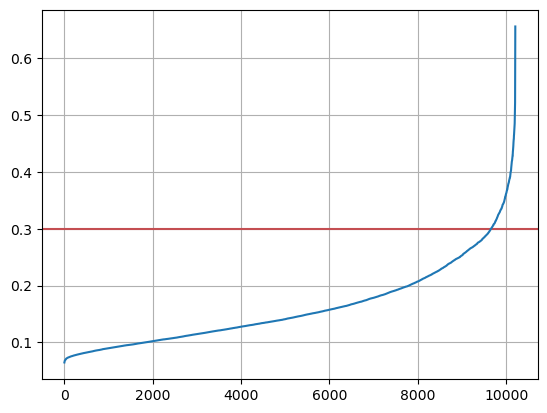

In [472]:
# K-distance graph to find out the right eps value in DBSCAN
neigh = NearestNeighbors(n_neighbors=minpts)
neigh.fit(df_final[metric_features])
distances, _ = neigh.kneighbors(df_final[metric_features])
distances = np.sort(distances[:, -1])
plt.axhline(y = 0.3, color = 'r', linestyle = '-')
plt.plot(distances)
plt.grid()
plt.show()

The right epsilon is about  . The right min_samples is usually 2 x dimensions = 

In [473]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=0.3, min_samples=minpts, n_jobs=4)
dbscan_labels = dbscan.fit_predict(df_final[metric_features])

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 2


In [474]:
# Concatenating the labels to df
df_cluster['dbscan_labels'] = dbscan_labels

In [475]:
df_cluster['dbscan_labels'].value_counts()

 0    10051
-1      157
Name: dbscan_labels, dtype: int64

The "outliers" seem to be a cluster.

### 4.1.1 K-Means and Hierarchical clustering

In [476]:
df_final.columns

Index(['FirstPolYear', 'ClaimsRate', 'PremMotor', 'PremHousehold',
       'PremHealth', 'PremLife', 'PremWork', 'sqrt_RatioPremSalary',
       'Children', 'EducDeg_enc', 'LosingMoney2Year', 'ProfitableCust',
       'Reversal'],
      dtype='object')

In [477]:
# Set up the clusterers
kmeans = KMeans(
    init='k-means++',
    n_init=20,
    random_state=42
)

hierarchical = AgglomerativeClustering(
    affinity='euclidean'
)

In [478]:
# Obtaining the R² scores for each cluster solution on demographic variables
r2_scores = {}
r2_scores['kmeans'] = get_r2_scores(df_final[metric_features], kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_final[metric_features], hierarchical.set_params(linkage=linkage)
    )

pd.DataFrame(r2_scores)

,kmeans,complete,average,single,ward
2,0.247818,0.052690,0.000665,0.000665,0.199720
3,0.385779,0.254801,0.003194,0.001354,0.312110
4,0.467637,0.273861,0.146246,0.001715,0.378310
5,0.526501,0.304825,0.154405,0.002056,0.436509
6,0.570611,0.394633,0.155017,0.002551,0.477531
7,0.604834,0.400399,0.162184,0.003018,0.514161
8,0.628786,0.406732,0.165774,0.003513,0.545641
9,0.647235,0.497704,0.166050,0.003833,0.570696


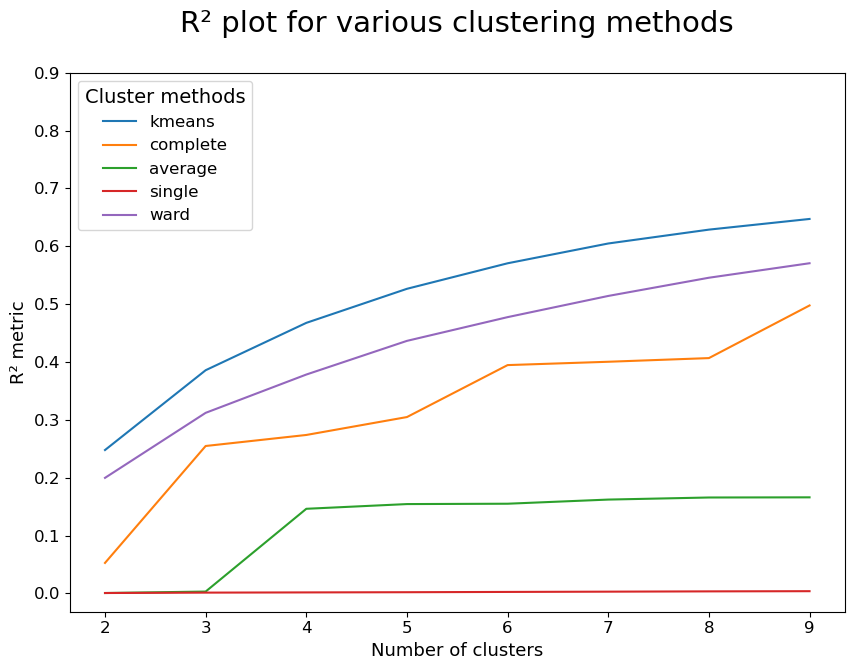

In [479]:
# Visualizing the R² scores for each cluster solution on demographic variables
pd.DataFrame(r2_scores).plot.line(figsize=(10,7))

plt.title("R² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=14, fontsize=12)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.xticks(np.arange(2,10), fontsize=12)
plt.yticks(np.arange(0,1,0.1), fontsize=12)
plt.show()

In [480]:
get_silhouette(df_final,metric_features)

For n_clusters = 2, the average silhouette_score is : 0.22450007617659018
For n_clusters = 3, the average silhouette_score is : 0.21413598588034483
For n_clusters = 4, the average silhouette_score is : 0.20138033739376934
For n_clusters = 5, the average silhouette_score is : 0.20008354379558696
For n_clusters = 6, the average silhouette_score is : 0.21173797634131356
For n_clusters = 7, the average silhouette_score is : 0.2192832486317876
For n_clusters = 8, the average silhouette_score is : 0.2174145837577736
For n_clusters = 9, the average silhouette_score is : 0.2135114261383956


In [481]:
kmeans_metric_2 = KMeans(
    n_clusters = 2,
    init='k-means++',
    n_init=20,
    random_state=42
)

kmeans_metric_labels_2 = kmeans_metric_2.fit_predict(df_final[metric_features])

df_cluster['kmeans_cluster_2'] = kmeans_metric_labels_2

In [482]:
#label frequencies
df_cluster['kmeans_cluster_2'].value_counts()

0    5198
1    5010
Name: kmeans_cluster_2, dtype: int64

### 4.1.2 Emergent SOM with K-Means Clustering on top

In [483]:
import sompy
from sompy.visualization.mapview import View2D
from sompy.visualization.bmuhits import BmuHitsView
from sompy.visualization.hitmap import HitMapView

# we import here because it is causing warnings on matplotlib. When using, import again as after using it will be deleted 

In [484]:
#setting the sim
np.random.seed(42)


sm = sompy.SOMFactory().build(
    df_final[metric_features].values, 
    mapsize=[50, 50], 
    initialization='random',
    neighborhood='gaussian',
    training='batch',
    lattice='hexa',
    component_names=metric_features
)
sm.train(n_job=-1, verbose='info', train_rough_len=300, train_finetune_len=300)

 Training...
 random_initialization took: 0.002000 seconds
 Rough training...
 radius_ini: 17.000000 , radius_final: 2.833333, trainlen: 300

 epoch: 1 ---> elapsed time:  0.477000, quantization error: 2.089158

 epoch: 2 ---> elapsed time:  0.583000, quantization error: 2.597309

 epoch: 3 ---> elapsed time:  0.785000, quantization error: 2.570088

 epoch: 4 ---> elapsed time:  1.200000, quantization error: 2.567725

 epoch: 5 ---> elapsed time:  1.213000, quantization error: 2.566783

 epoch: 6 ---> elapsed time:  1.247000, quantization error: 2.565512

 epoch: 7 ---> elapsed time:  0.807000, quantization error: 2.564838

 epoch: 8 ---> elapsed time:  0.821000, quantization error: 2.564351

 epoch: 9 ---> elapsed time:  0.884000, quantization error: 2.563781

 epoch: 10 ---> elapsed time:  0.786000, quantization error: 2.563287

 epoch: 11 ---> elapsed time:  0.766000, quantization error: 2.561881

 epoch: 12 ---> elapsed time:  0.828000, quantization error: 2.557873

 epoch: 13 --->

In [485]:
# Coordinates of the units in the input space
sm.codebook.matrix

array([[-0.139251, -0.126241, -1.734553, ...,  2.162321,  0.167916,
         3.401488],
       [-0.076588, -0.104725, -1.751624, ...,  2.80017 ,  0.164451,
         3.224376],
       [ 0.176005, -0.061407, -1.677124, ...,  2.642639,  0.258578,
         2.921213],
       ...,
       [-1.40039 ,  0.887702,  1.37837 , ..., -0.70086 , -0.757266,
        -0.411129],
       [-1.380346,  1.018671,  1.473113, ..., -0.742853, -0.770078,
        -0.502612],
       [-1.383448,  1.135967,  1.545729, ..., -0.765349, -0.752329,
        -0.549624]])

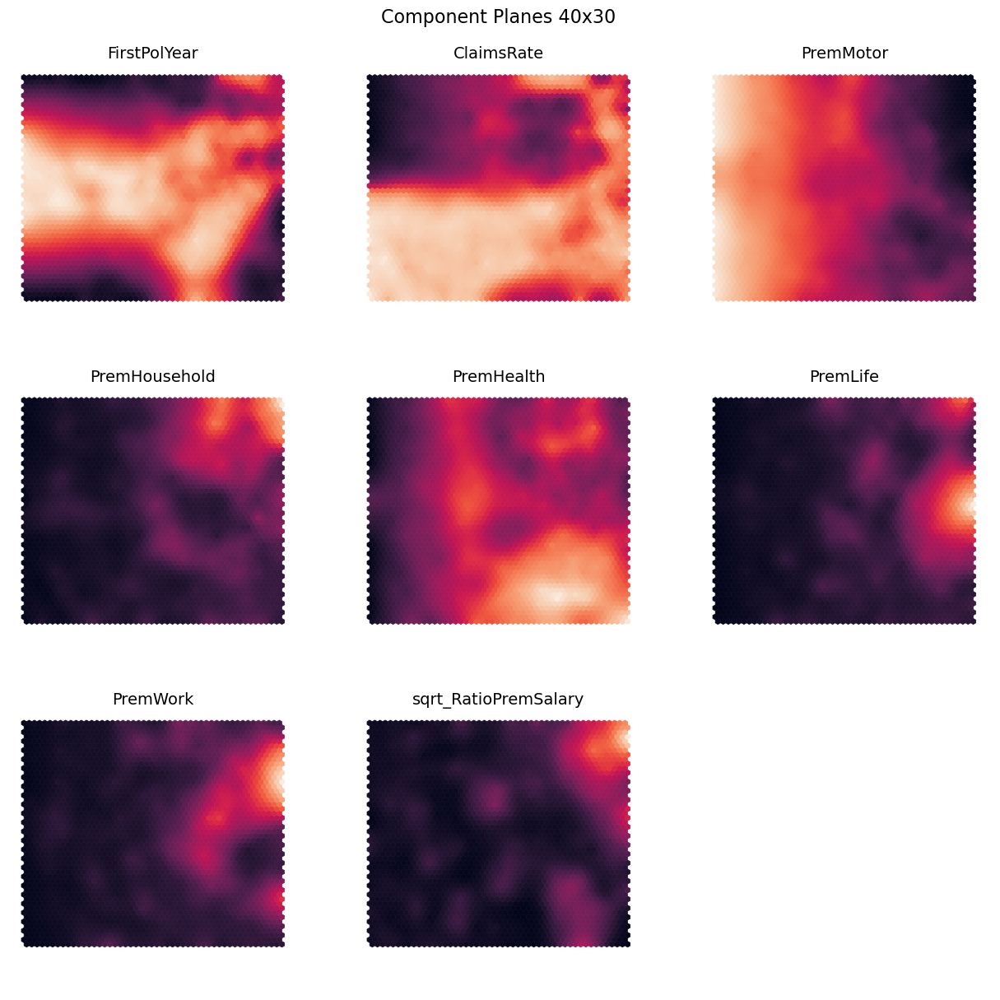

In [486]:
#### Use this if cell below does not work

plot_component_planes(weights=sm.codebook.matrix,features=metric_features,
                      M=50,N=50,
                      figsize=(12,12),figlayout=(3,3),
                      title="Component Planes 40x30",
                      cmap=sns.color_palette("rocket", as_cmap=True))


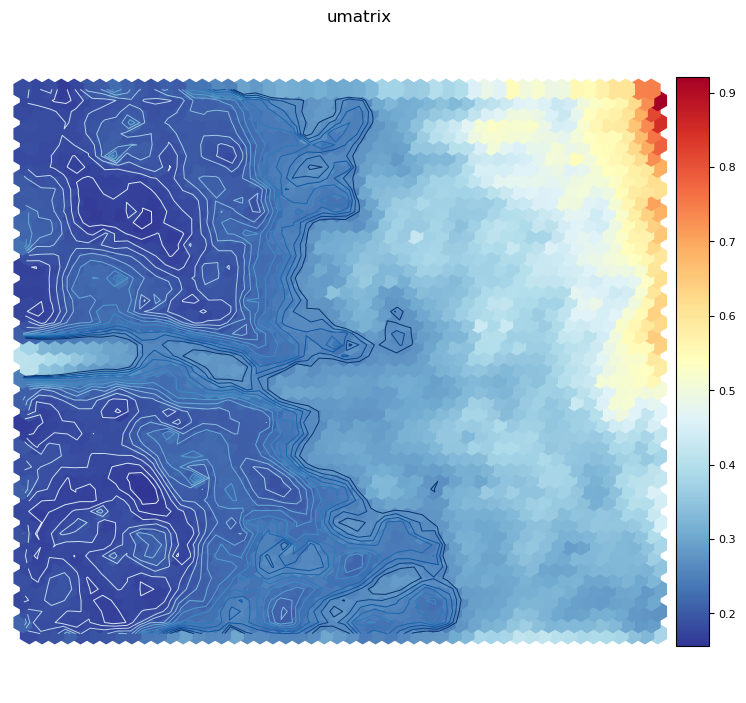

In [487]:
# U-matrix of the 50x50 grid
u = sompy.umatrix.UMatrixView(9, 9, 'umatrix', show_axis=True, text_size=8, show_text=True)

UMAT = u.show(
    sm, 
    distance=2, 
    row_normalized=False, 
    show_data=False, 
    contour=True # Visualize isomorphic curves
)

Now we can have a better idea of how the input space look like in terms of distances.

In [488]:
range_clusters = range(1, 10)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(sm.codebook.matrix)
    inertia.append(kmclust.inertia_)  # save the inertia of the given cluster solution


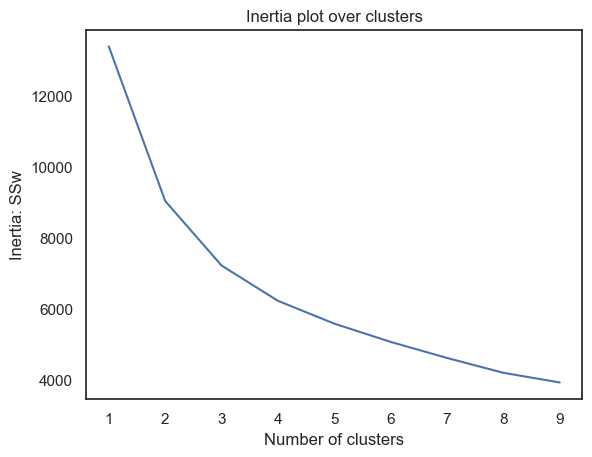

In [515]:
# The inertia plot
plt.plot(range_clusters, inertia)
plt.xticks(range_clusters)
plt.ylabel("Inertia: SSw", )
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters")
plt.show()

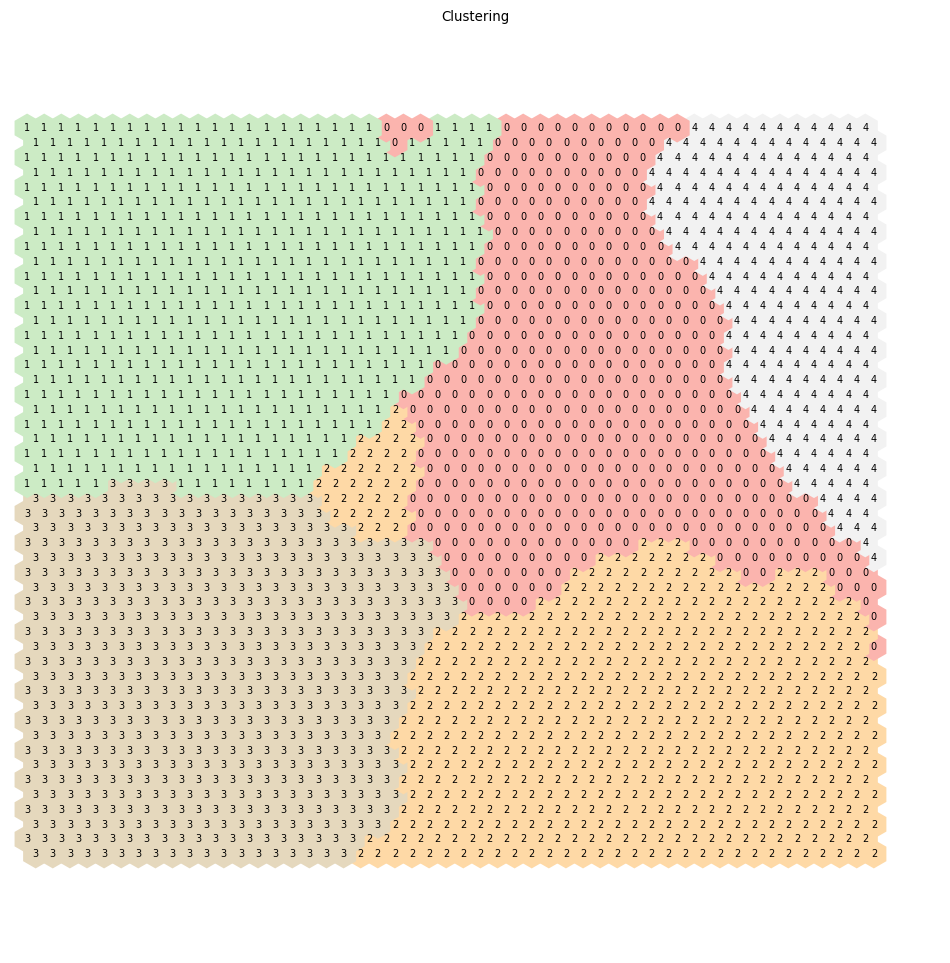

In [490]:
kmeans = KMeans(n_clusters=5, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels  # setting the cluster labels of sompy

hits = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

In [491]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

df_metric_nodes = pd.DataFrame(nodes, columns=metric_features)
df_metric_nodes['label'] = nodeclus_labels

df_metric_nodes

,FirstPolYear,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,sqrt_RatioPremSalary,label
0,-0.139251,-0.126241,-1.734553,3.969445,-0.745113,2.162321,0.167916,3.401488,4
1,-0.076588,-0.104725,-1.751624,3.482819,-0.821659,2.800170,0.164451,3.224376,4
2,0.176005,-0.061407,-1.677124,3.041129,-0.582224,2.642639,0.258578,2.921213,4
3,0.443749,-0.520866,-1.641938,2.685637,-0.415376,2.536798,0.403111,2.605129,4
4,0.639947,-0.794692,-1.597212,2.527038,-0.201379,2.163565,0.451453,2.286972,4
...,...,...,...,...,...,...,...,...,...
2495,-1.414355,0.885719,1.233009,-0.609561,-0.986957,-0.692887,-0.720714,-0.367771,3
2496,-1.410445,0.780129,1.281297,-0.504125,-1.137398,-0.674045,-0.741676,-0.378003,3
2497,-1.400390,0.887702,1.378370,-0.603581,-1.258857,-0.700860,-0.757266,-0.411129,3
2498,-1.380346,1.018671,1.473113,-0.718634,-1.357360,-0.742853,-0.770078,-0.502612,3


In [492]:
bmus_map = sm.find_bmu(np.array(df_final[metric_features]))[0]  # get bmus for each observation in df

In [493]:
df_final_som = df_final.copy()

In [494]:
df_bmus = pd.DataFrame(
    np.concatenate((df_final_som, np.expand_dims(bmus_map,1)), axis=1),
    index=df_final_som.index, columns=np.append(df_final_som.columns,"BMU")
)
df_bmus

,FirstPolYear,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,sqrt_RatioPremSalary,Children,EducDeg_enc,LosingMoney2Year,ProfitableCust,Reversal,BMU
CustID,,,,,,,,,,,,,,
1.0,0.458333,0.240741,0.644732,0.077490,0.333663,0.149447,0.079233,0.142863,1.0,2.0,0.0,1.0,0.0,1725.0
2.0,0.291667,0.691358,0.138411,0.246444,0.266984,0.557499,0.323981,0.480726,1.0,2.0,1.0,0.0,0.0,1673.0
3.0,0.708333,0.172840,0.356778,0.150265,0.284716,0.258301,0.304481,0.152539,0.0,1.0,0.0,1.0,0.0,1272.0
4.0,0.666667,0.611111,0.316614,0.059378,0.704047,0.117156,0.110636,0.246593,1.0,3.0,0.0,0.0,0.0,1775.0
5.0,0.500000,0.555556,0.581559,0.061611,0.415084,0.071334,0.146591,0.167630,1.0,3.0,0.0,1.0,0.0,1725.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,0.416667,0.592593,0.675089,0.062439,0.395352,0.046431,0.073446,0.084803,0.0,4.0,0.0,0.0,0.0,1725.0
10293.0,0.125000,0.000000,0.233638,0.557284,0.326674,0.055036,0.321239,0.262077,0.0,1.0,0.0,1.0,0.0,1172.0
10294.0,0.833333,0.129630,0.691870,0.104257,0.324426,0.054427,0.046322,0.106991,1.0,3.0,0.0,1.0,0.0,1075.0


In [495]:
df_final_som_nodes = df_bmus.merge(df_metric_nodes['label'], 'left', left_on="BMU", right_index=True)
df_final_som_nodes

,FirstPolYear,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,sqrt_RatioPremSalary,Children,EducDeg_enc,LosingMoney2Year,ProfitableCust,Reversal,BMU,label
CustID,,,,,,,,,,,,,,,
1.0,0.458333,0.240741,0.644732,0.077490,0.333663,0.149447,0.079233,0.142863,1.0,2.0,0.0,1.0,0.0,1725.0,2
2.0,0.291667,0.691358,0.138411,0.246444,0.266984,0.557499,0.323981,0.480726,1.0,2.0,1.0,0.0,0.0,1673.0,2
3.0,0.708333,0.172840,0.356778,0.150265,0.284716,0.258301,0.304481,0.152539,0.0,1.0,0.0,1.0,0.0,1272.0,0
4.0,0.666667,0.611111,0.316614,0.059378,0.704047,0.117156,0.110636,0.246593,1.0,3.0,0.0,0.0,0.0,1775.0,2
5.0,0.500000,0.555556,0.581559,0.061611,0.415084,0.071334,0.146591,0.167630,1.0,3.0,0.0,1.0,0.0,1725.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,0.416667,0.592593,0.675089,0.062439,0.395352,0.046431,0.073446,0.084803,0.0,4.0,0.0,0.0,0.0,1725.0,2
10293.0,0.125000,0.000000,0.233638,0.557284,0.326674,0.055036,0.321239,0.262077,0.0,1.0,0.0,1.0,0.0,1172.0,0
10294.0,0.833333,0.129630,0.691870,0.104257,0.324426,0.054427,0.046322,0.106991,1.0,3.0,0.0,1.0,0.0,1075.0,0


In [496]:
# Characterizing the final clusters
df_final_som_nodes.drop(columns='BMU').groupby('label').mean()

,FirstPolYear,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,sqrt_RatioPremSalary,Children,EducDeg_enc,LosingMoney2Year,ProfitableCust,Reversal
label,,,,,,,,,,,,,
0,0.643517,0.293375,0.372275,0.215300,0.353215,0.209495,0.248796,0.216874,0.660345,2.105172,0.061207,0.923707,0.074138
1,0.292817,0.147796,0.741970,0.086329,0.240158,0.062332,0.072259,0.131644,0.853072,2.780944,0.000000,1.000000,0.408727
2,0.388991,0.495120,0.414674,0.151820,0.498326,0.139642,0.140822,0.182567,0.656067,2.465785,0.187230,0.691427,0.145764
3,0.621751,0.526334,0.668743,0.087159,0.299494,0.090228,0.089789,0.116014,0.760409,2.694072,0.308398,0.531052,0.357445


Probabily cluster 2 was full of empty nodes.

In [497]:
r2(df_final_som_nodes,'label')

0.8751689780568719

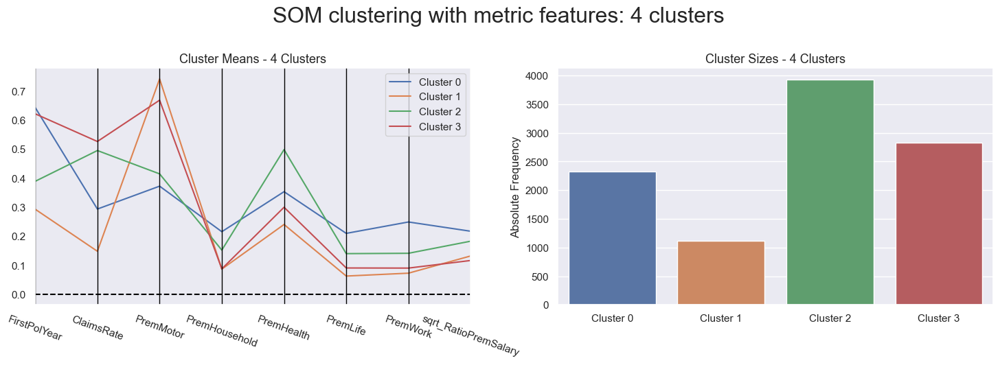

In [498]:
cluster_profiles(
    df = df_final_som_nodes[metric_features + ['label']], 
    label_columns = ['label'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'SOM clustering with metric features: 4 clusters'
)

In [499]:
del sompy, View2D, BmuHitsView, HitMapView

### 4.1.3 K-Prototypes

"The k-prototypes algorithm (Huang, 1997a)
integrates the k-means and k-modes processes to cluster data with mixed numeric and
categorical values. In the k-prototypes algorithm we define a dissimilarity measure that takes
into account both numeric and categorical attributes."
https://cse.hkust.edu.hk/~qyang/Teaching/537/Papers/huang98extensions.pdf

"Instead of calculating the within the sum of squares errors (WSSE) with Euclidian distance, K-Prototype provides the cost function that combines the calculation for numerical and categorical variables. We can look into the Elbow to determine the optimal number of clusters."
https://towardsdatascience.com/the-k-prototype-as-clustering-algorithm-for-mixed-data-type-categorical-and-numerical-fe7c50538ebb

In [500]:
df_final.head()

,FirstPolYear,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,sqrt_RatioPremSalary,Children,EducDeg_enc,LosingMoney2Year,ProfitableCust,Reversal
CustID,,,,,,,,,,,,,
1.0,0.458333,0.240741,0.644732,0.077490,0.333663,0.149447,0.079233,0.142863,1.0,2.0,0,1,0
2.0,0.291667,0.691358,0.138411,0.246444,0.266984,0.557499,0.323981,0.480726,1.0,2.0,1,0,0
3.0,0.708333,0.172840,0.356778,0.150265,0.284716,0.258301,0.304481,0.152539,0.0,1.0,0,1,0
4.0,0.666667,0.611111,0.316614,0.059378,0.704047,0.117156,0.110636,0.246593,1.0,3.0,0,0,0
5.0,0.500000,0.555556,0.581559,0.061611,0.415084,0.071334,0.146591,0.167630,1.0,3.0,0,1,0


Cluster initiation: 1
Cluster initiation: 2
Cluster initiation: 3
Cluster initiation: 4
Cluster initiation: 5
Cluster initiation: 6
Cluster initiation: 7
Cluster initiation: 8
Cluster initiation: 9


,Cluster,Cost
0,1,5358.766551
1,2,3606.665270
2,3,3024.104229
3,4,2715.170372
4,5,2542.623581
5,6,2359.616853
6,7,2213.462735
7,8,2095.985122
8,9,2035.812819


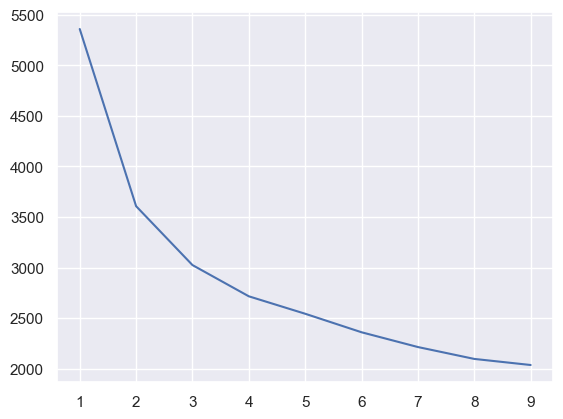

In [501]:
# We have to get the position of categorical columns, cant use the names in the algorithm
cat_cols = [df_final.columns.get_loc(col) for col in cat_features]

# Convert dataframe to matrix to help the algorithm run better
final_matrix = df_final.to_numpy()

# Choose optimal K using Elbow method WARNING takes a while to run (around 10 mins)
cost = []
for cluster in range(1, 10):
    kpt = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=cluster)
    kpt.fit_predict(final_matrix, categorical = cat_cols)
    cost.append(kpt.cost_)
    print('Cluster initiation: {}'.format(cluster))
# Converting the results into a dataframe and plotting them
df_cost = pd.DataFrame({'Cluster':range(1, 10), 'Cost':cost})

plt.plot(df_cost.iloc[:,0],df_cost.iloc[:,1])

df_cost

Text(0.5, 0, 'Number of clusters')

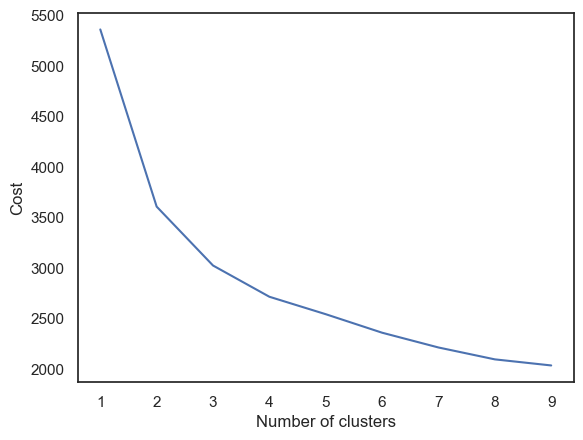

In [513]:
sns.set_style("white")
plt.plot(df_cost.iloc[:,0],df_cost.iloc[:,1])

plt.ylabel('Cost')
plt.xlabel('Number of clusters')

In [502]:
df_final.columns

Index(['FirstPolYear', 'ClaimsRate', 'PremMotor', 'PremHousehold',
       'PremHealth', 'PremLife', 'PremWork', 'sqrt_RatioPremSalary',
       'Children', 'EducDeg_enc', 'LosingMoney2Year', 'ProfitableCust',
       'Reversal'],
      dtype='object')

In [503]:
# Applying the right clustering (algorithm and number of clusters) for each perspective (elbow)
cat_cols = [df_final.columns.get_loc(col) for col in cat_features]

kpt_full_4 = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=4)

kpt_full_2 = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=2)

kpt_full_3 = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=3)

full_labels_4 = kpt_full_4.fit_predict(df_final,categorical=cat_cols)

full_labels_3 = kpt_full_3.fit_predict(df_final,categorical=cat_cols)

full_labels_2 = kpt_full_2.fit_predict(df_final,categorical=cat_cols)


df_cluster['kproto_cluster4'] = full_labels_4
df_cluster['kproto_cluster3'] = full_labels_3
df_cluster['kproto_cluster2'] = full_labels_2

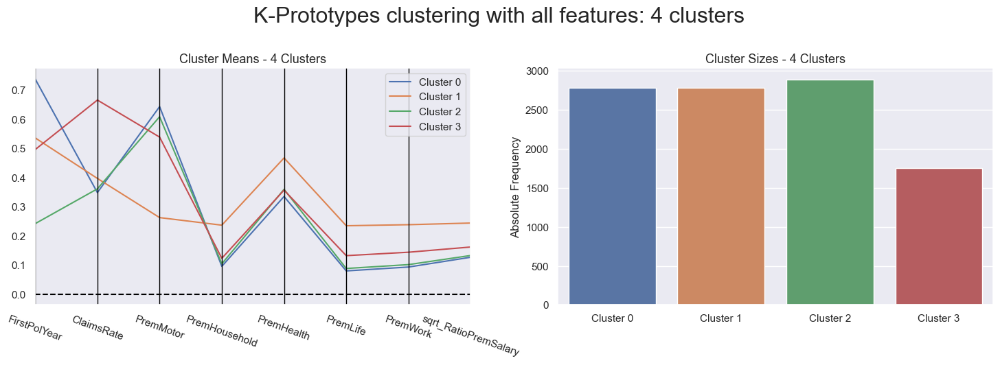

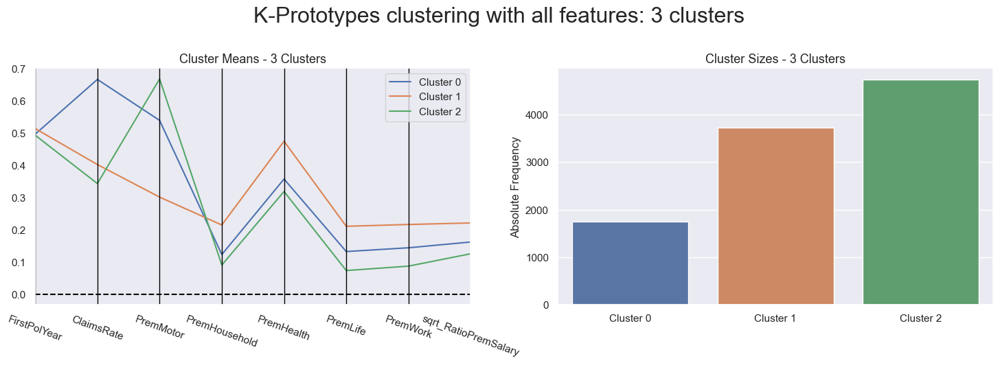

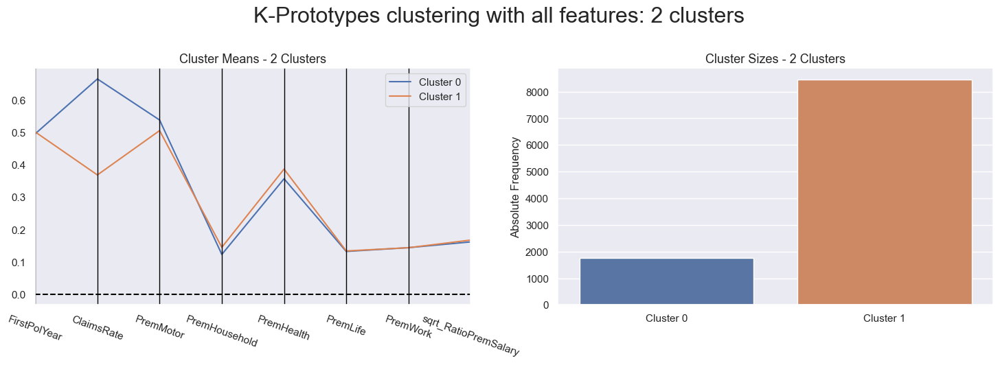

In [504]:
cluster_profiles(
    df = df_cluster[metric_features + ['kproto_cluster4']], 
    label_columns = ['kproto_cluster4'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'K-Prototypes clustering with all features: 4 clusters'
)


cluster_profiles(
    df = df_cluster[metric_features + ['kproto_cluster3']], 
    label_columns = ['kproto_cluster3'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'K-Prototypes clustering with all features: 3 clusters'
)


cluster_profiles(
    df = df_cluster[metric_features + ['kproto_cluster2']], 
    label_columns = ['kproto_cluster2'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'K-Prototypes clustering with all features: 2 clusters'
)

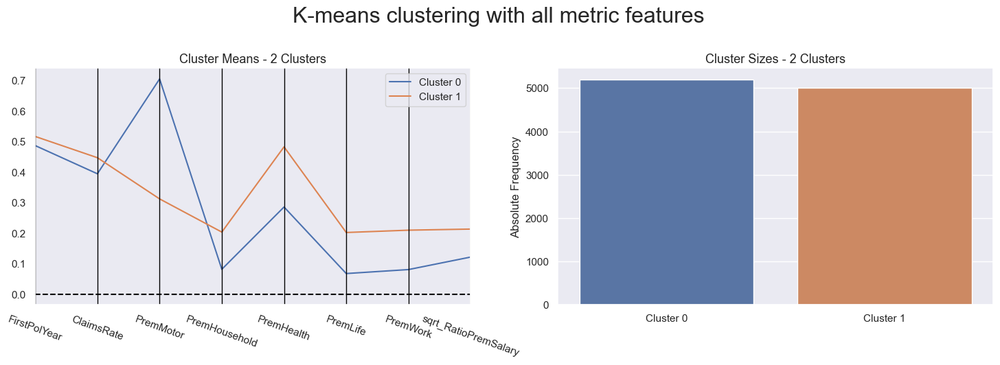

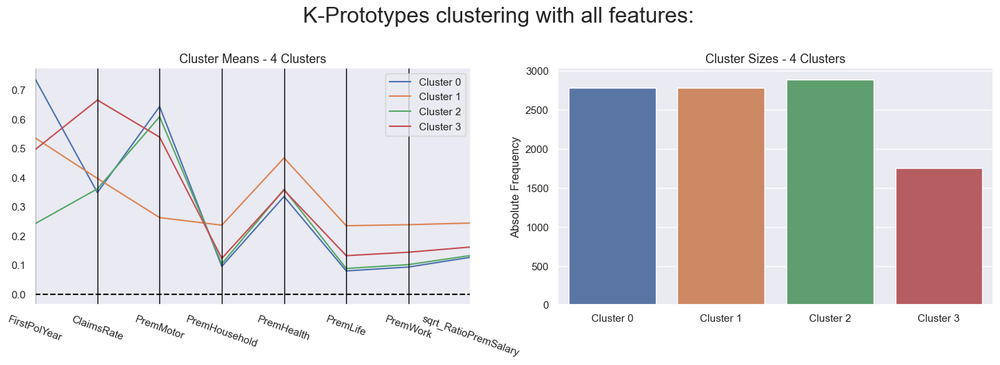

In [516]:
# Profilling each cluster

cluster_profiles(
    df = df_cluster[metric_features + ['kmeans_cluster_2']], 
    label_columns = ['kmeans_cluster_2'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'K-means clustering with all metric features'
)


cluster_profiles(
    df = df_cluster[metric_features + ['kproto_cluster4']], 
    label_columns = ['kproto_cluster4'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'K-Prototypes clustering with all features:'
)

In [517]:
print('The r^2 for 2 K-Means clusters is:', r2(df_cluster, df_cluster['kmeans_cluster_2']))

The r^2 for 2 K-Means clusters is: 0.1420215151059706


In [518]:
print('The r^2 for 4 K-Prototypes is:', r2(df_cluster, df_cluster['kproto_cluster4']))

The r^2 for 4 K-Prototypes is: 0.6293598030682956


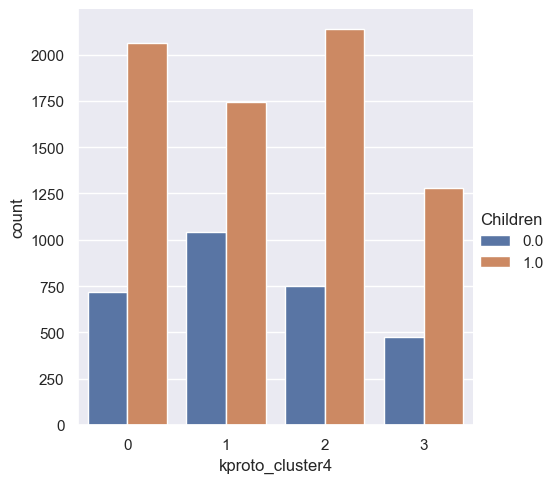

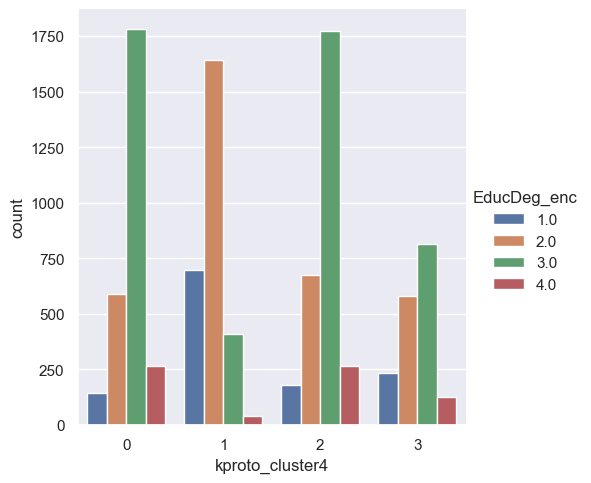

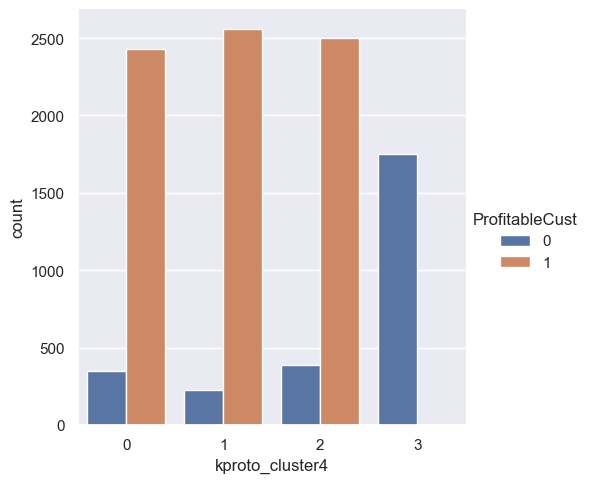

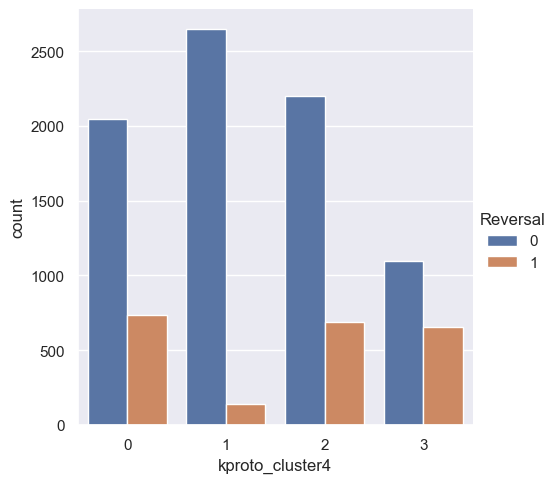

In [519]:
for feat in cat_features:
    sns.catplot(x ='kproto_cluster4', data=df_cluster, hue = feat, kind ='count',palette =["C0","C1","C2","C3"])
#    plt.legend(labels = ['No Disease', 'Disease'], loc = 'lower right',fontsize =10,borderpad = 0.2, handlelength = 1.2)

plt.show()

## 4.2. Separating different perspectives

In [520]:
demo = ['FirstPolYear', 'sqrt_RatioPremSalary','Children', 'EducDeg_enc']
value = ['ClaimsRate','PremMotor', 'PremHousehold', 'PremHealth',
         'PremLife', 'PremWork', 'ProfitableCust', 'Reversal']

In [521]:
metric_features

['FirstPolYear',
 'ClaimsRate',
 'PremMotor',
 'PremHousehold',
 'PremHealth',
 'PremLife',
 'PremWork',
 'sqrt_RatioPremSalary']

In [522]:
cat_features

['Children', 'EducDeg_enc', 'ProfitableCust', 'Reversal']

In [523]:
df_demo = df_final[demo].copy()
df_value= df_final[value].copy()

value_num = [i for i in df_value.columns if i in metric_features]
demo_num = [i for i in df_demo.columns if i in metric_features]

value_cat = [i for i in df_value.columns if i in cat_features]
demo_cat = [i for i in df_demo.columns if i in cat_features]

df_demo_num = df_demo[demo_num]
df_value_num = df_value[value_num]

In [524]:
df_value_num.columns

Index(['ClaimsRate', 'PremMotor', 'PremHousehold', 'PremHealth', 'PremLife',
       'PremWork'],
      dtype='object')

### 4.2.1. K-Means

#### 4.2.1.1 Demographic features

The only metric features in the demographic features are `FirstPolYear` and `sqrt_RatioPremSalary`. We do not need a fancy algorithm to check if they form clusters since it is a 2d space. Plotting them against one another is sufficient.

Text(0, 0.5, 'sqrt_RatioPremSalary')

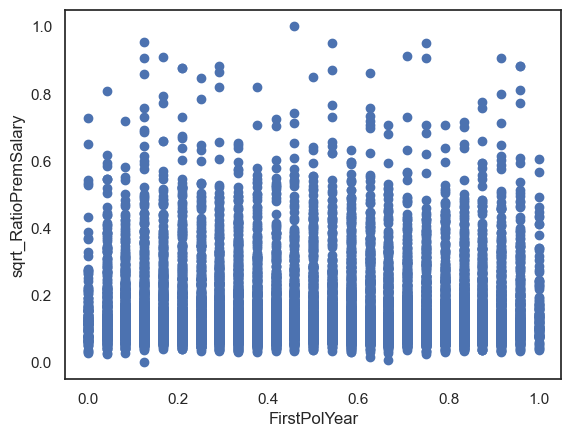

In [527]:
sns.set_style("white")
plt.scatter(df_final['FirstPolYear'], df_final['sqrt_RatioPremSalary'])
plt.xlabel('FirstPolYear')
plt.ylabel('sqrt_RatioPremSalary')

There is no evidence of potential clusters.

#### 4.2.1.2 Value features

In [528]:
df_value_num.head()

,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,
1.0,0.240741,0.644732,0.077490,0.333663,0.149447,0.079233
2.0,0.691358,0.138411,0.246444,0.266984,0.557499,0.323981
3.0,0.172840,0.356778,0.150265,0.284716,0.258301,0.304481
4.0,0.611111,0.316614,0.059378,0.704047,0.117156,0.110636
5.0,0.555556,0.581559,0.061611,0.415084,0.071334,0.146591


In [529]:
# Obtaining the R² scores for each cluster solution on demographic variables
r2_scores = {}
r2_scores['kmeans'] = get_r2_scores(df_value_num, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_value_num, hierarchical.set_params(linkage=linkage)
    )

pd.DataFrame(r2_scores)

,kmeans,complete,average,single,ward
2,0.366974,0.257266,0.027890,0.000601,0.349976
3,0.491946,0.303212,0.028273,0.000985,0.453683
4,0.594537,0.329363,0.032452,0.001548,0.552937
5,0.643952,0.372488,0.289307,0.003479,0.601263
6,0.678742,0.465446,0.291562,0.003686,0.635564
7,0.709050,0.472025,0.320065,0.004281,0.667666
8,0.726557,0.526882,0.322511,0.004884,0.689547
9,0.742639,0.531091,0.362854,0.005267,0.704168


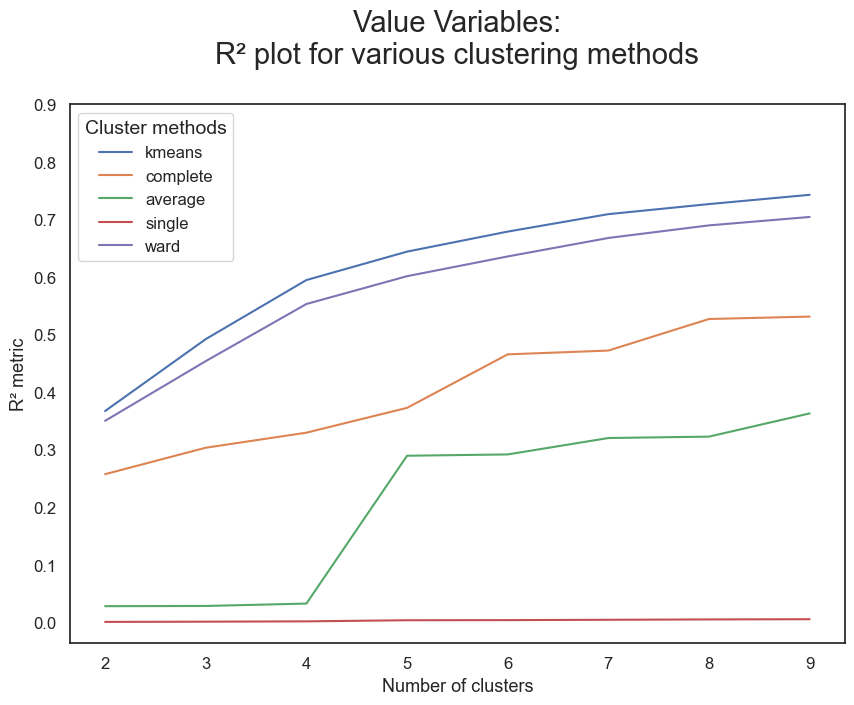

In [530]:
# Visualizing the R² scores for each cluster solution on demographic variables
pd.DataFrame(r2_scores).plot.line(figsize=(10,7))

plt.title("Value Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=14, fontsize=12)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.xticks(np.arange(2,10), fontsize=12)
plt.yticks(np.arange(0,1,0.1), fontsize=12)
plt.show()

In [531]:
get_silhouette(df_value_num, value_num)

For n_clusters = 2, the average silhouette_score is : 0.31802383559593733
For n_clusters = 3, the average silhouette_score is : 0.3101686545608038
For n_clusters = 4, the average silhouette_score is : 0.3186577927968525
For n_clusters = 5, the average silhouette_score is : 0.2987472852153
For n_clusters = 6, the average silhouette_score is : 0.28294478878193363
For n_clusters = 7, the average silhouette_score is : 0.285731542591858
For n_clusters = 8, the average silhouette_score is : 0.28769380912422104
For n_clusters = 9, the average silhouette_score is : 0.2665675286447809


In [532]:
kmeans_value4 = KMeans(
    n_clusters = 4,
    init='k-means++',
    n_init=20,
    random_state=42
)
kmeans_value4_labels = kmeans_value4.fit_predict(df_value_num)

df_cluster['kmeans_value4_cluster'] = kmeans_value4_labels


kmeans_value2 = KMeans(
    n_clusters = 2,
    init='k-means++',
    n_init=20,
    random_state=42
)
kmeans_value2_labels = kmeans_value2.fit_predict(df_value_num)

df_cluster['kmeans_value2_cluster'] = kmeans_value2_labels

In [533]:
r2(df_value_num, df_cluster['kmeans_value4_cluster'])

0.5945374457025631

In [534]:
r2(df_value_num, df_cluster['kmeans_value2_cluster'])

0.36697371755437436

In [535]:
r2(df_cluster, df_cluster['kmeans_value4_cluster'])

0.4305836847983634

In [536]:
r2(df_cluster, df_cluster['kmeans_value2_cluster'])

0.1529460766520796

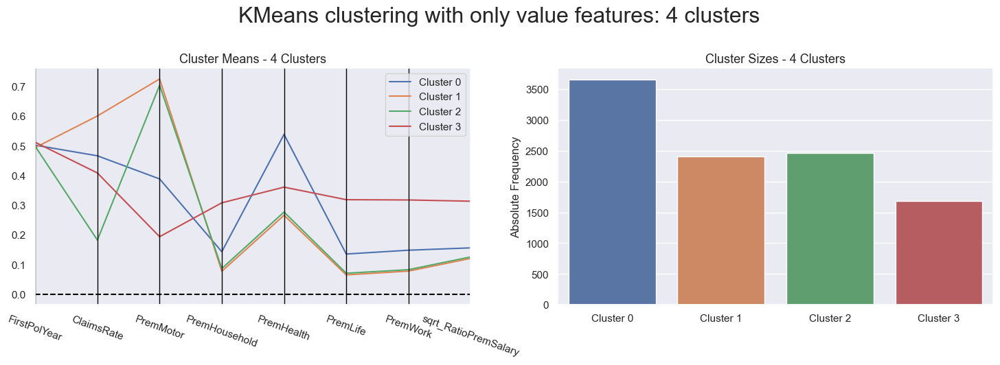

In [537]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_cluster[metric_features + ['kmeans_value4_cluster']], 
    label_columns = ['kmeans_value4_cluster'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'KMeans clustering with only value features: 4 clusters')

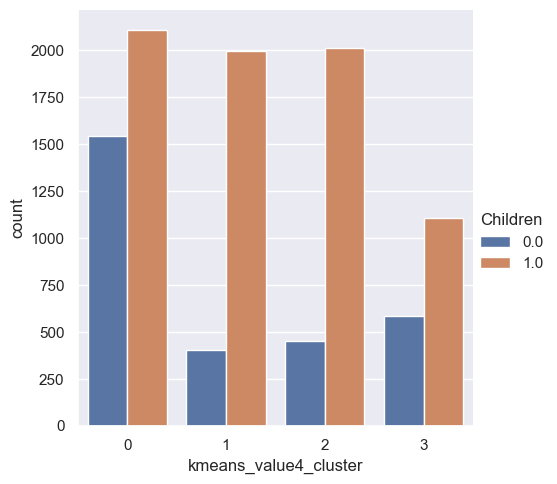

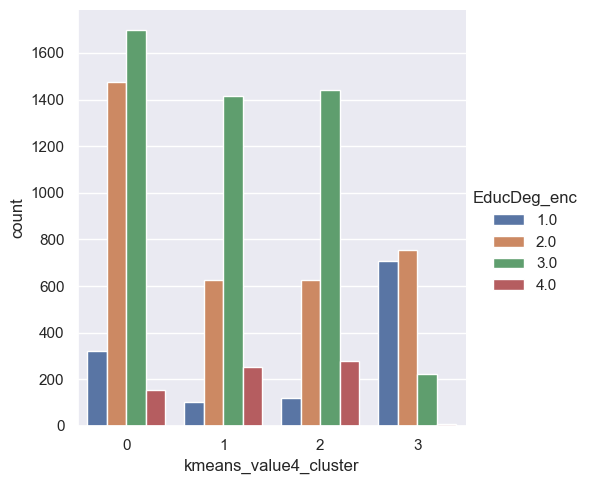

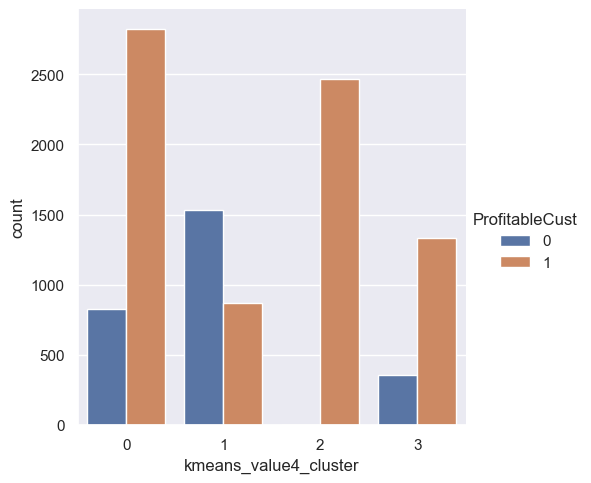

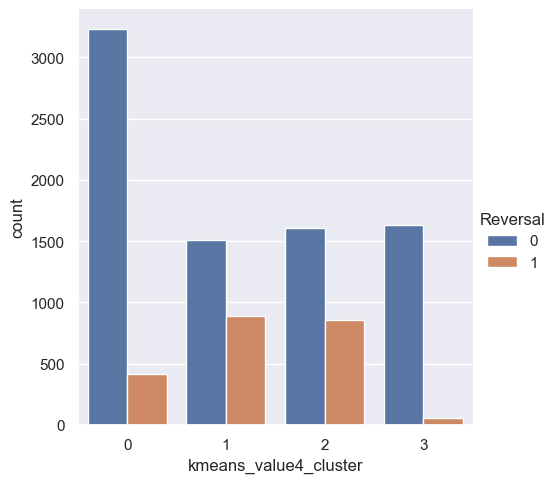

In [538]:
for feat in cat_features:
    sns.catplot(x ='kmeans_value4_cluster', data=df_cluster, hue = feat, kind ='count',palette =["C0","C1","C2","C3"])
#    plt.legend(labels = ['No Disease', 'Disease'], loc = 'lower right',fontsize =10,borderpad = 0.2, handlelength = 1.2)

plt.show()

### 4.2.2. K-Prototype

#### 4.2.2.1 Demographic features

Cluster initiation: 1
Cluster initiation: 2
Cluster initiation: 3
Cluster initiation: 4
Cluster initiation: 5
Cluster initiation: 6
Cluster initiation: 7
Cluster initiation: 8
Cluster initiation: 9


,Cluster,Cost
0,1,1730.375833
1,2,1153.941975
2,3,941.654153
3,4,787.014474
4,5,682.952000
5,6,599.011349
6,7,562.151266
7,8,480.288088
8,9,486.642821


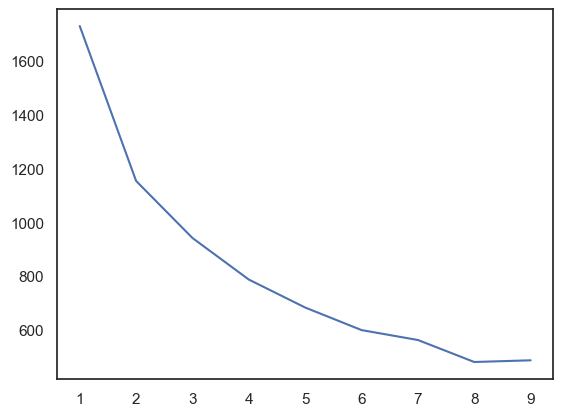

In [565]:
# We have to get the position of categorical columns, cant use the names in the algorithm
demo_cat_cols = [df_demo.columns.get_loc(col) for col in demo_cat]

# Convert dataframe to matrix to help the algorithm run better
final_matrix = df_demo.to_numpy()

# Choose optimal K using Elbow method WARNING takes a while to run (around 10 mins)
cost = []
for cluster in range(1, 10):
    kpt = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=cluster)
    kpt.fit_predict(final_matrix, categorical = demo_cat_cols)
    cost.append(kpt.cost_)
    print('Cluster initiation: {}'.format(cluster))
# Converting the results into a dataframe and plotting them
df_cost = pd.DataFrame({'Cluster':range(1, 10), 'Cost':cost})

plt.plot(df_cost.iloc[:,0],df_cost.iloc[:,1])

df_cost

Text(0.5, 0, 'Number of clusters')

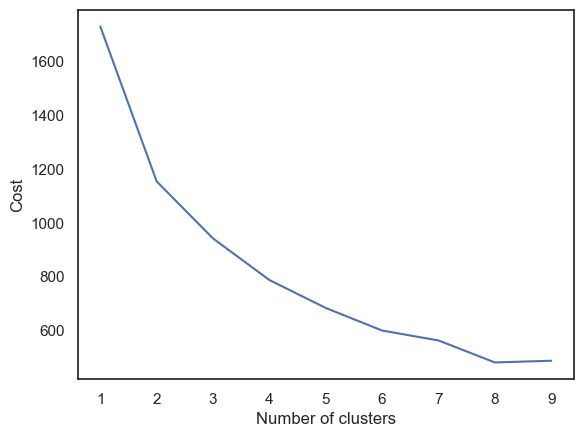

In [566]:
sns.set_style("white")
plt.plot(df_cost.iloc[:,0],df_cost.iloc[:,1])

plt.ylabel('Cost')
plt.xlabel('Number of clusters')

In [540]:
# We have to get the position of categorical columns, cant use the names in the algorithm
demo_cat_cols = [df_demo.columns.get_loc(col) for col in demo_cat]

In [541]:
# Applying the right clustering (algorithm and number of clusters) for each perspective (elbow)
kpt_demo_2 = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=2)

kpt_demo_labels_2 = kpt_demo_2.fit_predict(df_demo,categorical=demo_cat_cols)

In [542]:
kpt_demo_4 = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=4)

kpt_demo_labels_4 = kpt_demo_4.fit_predict(df_demo,categorical=demo_cat_cols)

In [543]:
df_cluster['kproto_demo2_cluster'] = kpt_demo_labels_2
df_cluster['kproto_demo4_cluster'] = kpt_demo_labels_4

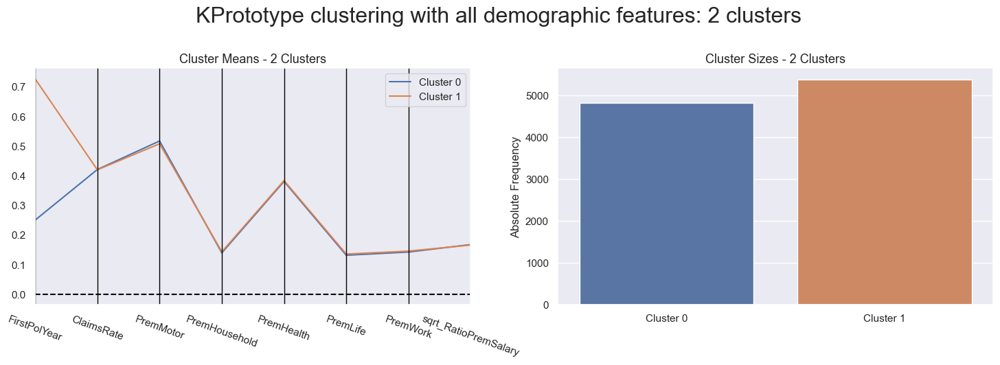

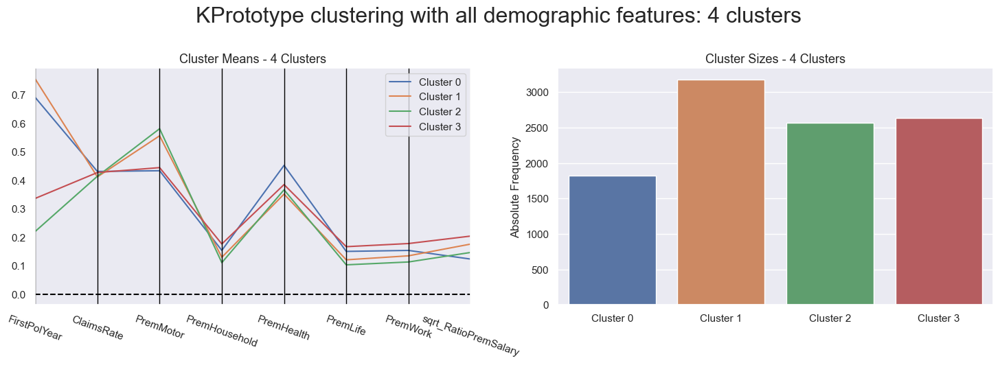

In [544]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_cluster[metric_features + ['kproto_demo2_cluster']], 
    label_columns = ['kproto_demo2_cluster'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'KPrototype clustering with all demographic features: 2 clusters'
)

# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_cluster[metric_features + ['kproto_demo4_cluster']], 
    label_columns = ['kproto_demo4_cluster'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'KPrototype clustering with all demographic features: 4 clusters'
)


#### 4.2.2.2 Value features

Cluster initiation: 1
Cluster initiation: 2
Cluster initiation: 3
Cluster initiation: 4
Cluster initiation: 5
Cluster initiation: 6
Cluster initiation: 7
Cluster initiation: 8
Cluster initiation: 9


,Cluster,Cost
0,1,2108.956453
1,2,1481.398050
2,3,1186.905755
3,4,1012.771154
4,5,900.225687
5,6,803.679866
6,7,737.215052
7,8,676.467118
8,9,633.534427


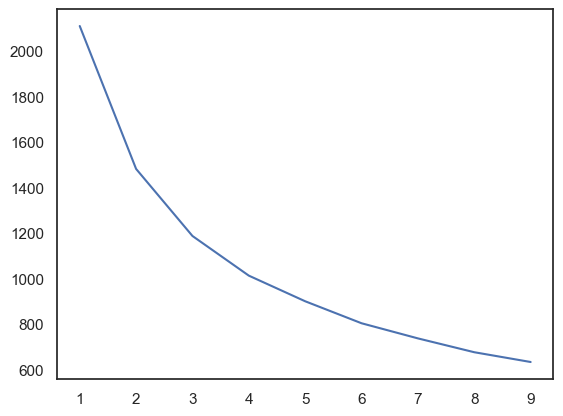

In [567]:
# We have to get the position of categorical columns, cant use the names in the algorithm
value_cat_cols = [df_value.columns.get_loc(col) for col in value_cat]

# Convert dataframe to matrix to help the algorithm run better
final_matrix = df_value.to_numpy()

# Choose optimal K using Elbow method WARNING takes a while to run (around 10 mins)
cost = []
for cluster in range(1, 10):
    kpt = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=cluster)
    kpt.fit_predict(final_matrix, categorical = value_cat_cols)
    cost.append(kpt.cost_)
    print('Cluster initiation: {}'.format(cluster))
# Converting the results into a dataframe and plotting them
df_cost = pd.DataFrame({'Cluster':range(1, 10), 'Cost':cost})

plt.plot(df_cost.iloc[:,0],df_cost.iloc[:,1])

df_cost

Text(0.5, 0, 'Number of clusters')

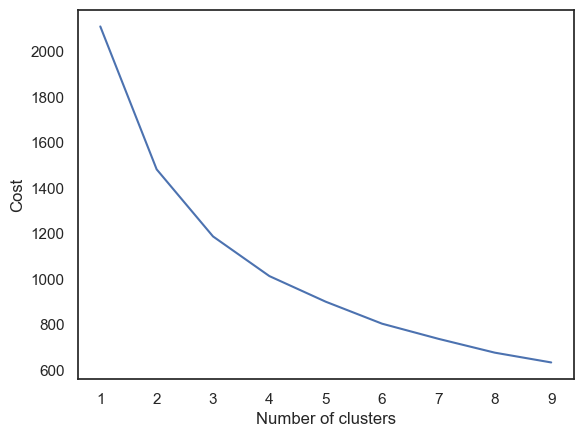

In [568]:
sns.set_style("white")
plt.plot(df_cost.iloc[:,0],df_cost.iloc[:,1])

plt.ylabel('Cost')
plt.xlabel('Number of clusters')

In [546]:
# Applying the right clustering (algorithm and number of clusters) for each perspective (elbow)
value_cat_cols = [df_value.columns.get_loc(col) for col in value_cat]

kpt_value_2 = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=2)
kpt_value_4 = KPrototypes(n_jobs = -1, init = 'Huang', random_state = 42, n_clusters=4)

kpt_value_labels_2 = kpt_value_2.fit_predict(df_value,categorical=value_cat_cols)
kpt_value_labels_4 = kpt_value_4.fit_predict(df_value,categorical=value_cat_cols)

In [547]:
df_cluster['kproto_value2_cluster'] = kpt_value_labels_2
df_cluster['kproto_value4_cluster'] = kpt_value_labels_4

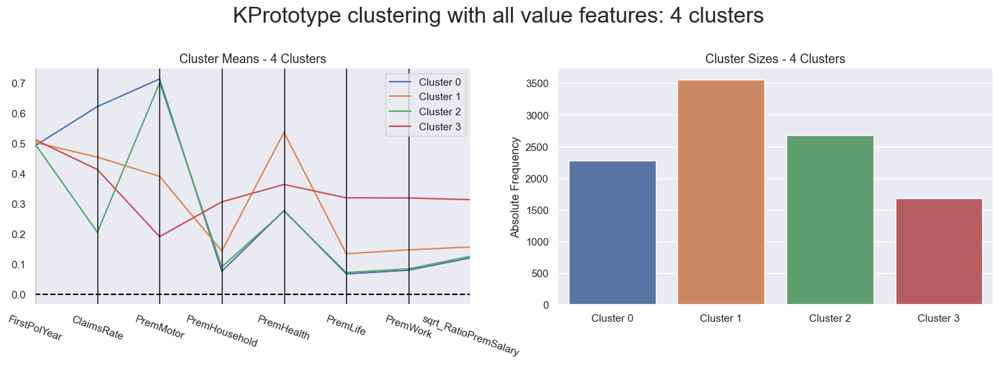

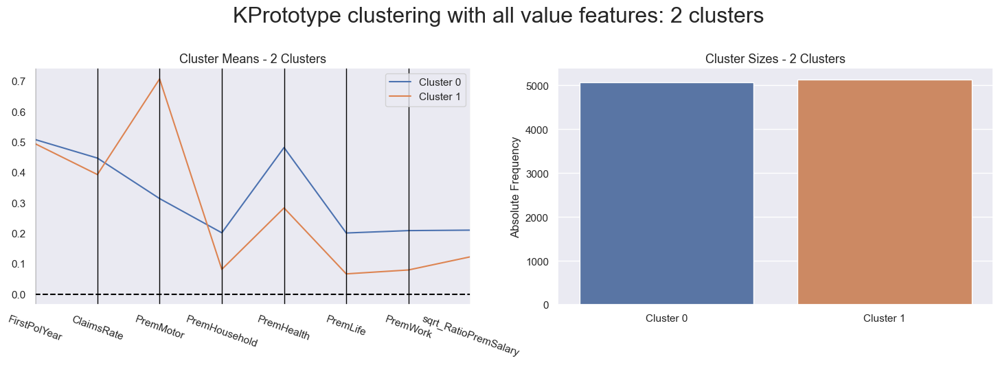

In [548]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_cluster[metric_features + ['kproto_value4_cluster']], 
    label_columns = ['kproto_value4_cluster'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'KPrototype clustering with all value features: 4 clusters'
)

# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_cluster[metric_features + ['kproto_value2_cluster']], 
    label_columns = ['kproto_value2_cluster'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3"],
    title = 'KPrototype clustering with all value features: 2 clusters'
)



In [549]:
print('The r^2 for 2 clusters is:', r2(df_cluster, df_cluster['kproto_value2_cluster']))
print('The r^2 for 4 clusters is:', r2(df_cluster, df_cluster['kproto_value4_cluster'])) #this is with the full dataset

The r^2 for 2 clusters is: 0.14189194268497873
The r^2 for 4 clusters is: 0.43546350679452783


In [550]:
# Count label frequencies (contigency table)
df_cluster[metric_features + cat_features + ['kmeans_value4_cluster', 'kproto_demo4_cluster']].groupby(['kmeans_value4_cluster', 'kproto_demo4_cluster'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('kproto_demo4_cluster', 'kmeans_value4_cluster', 0)

kmeans_value4_cluster,0,1,2,3
kproto_demo4_cluster,,,,
0,952,259,283,326
1,907,900,905,467
2,834,752,785,198
3,961,490,491,698


In [551]:
# Centroids of the concatenated cluster labels
df_cluster_centroids_4 = df_cluster.groupby(['kmeans_value4_cluster', 'kproto_demo4_cluster'])\
    [metric_features].mean()
df_cluster_centroids_4

FirstPolYear  ClaimsRate  \
kmeans_value4_cluster kproto_demo4_cluster                             
0                     0                         0.685487    0.466886   
                      1                         0.756248    0.465100   
                      2                         0.218125    0.459743   
                      3                         0.327133    0.472566   
1                     0                         0.674389    0.593212   
                      1                         0.748426    0.601015   
                      2                         0.224789    0.603814   
                      3                         0.344218    0.598173   
2                     0                         0.688899    0.207717   
                      1                         0.749171    0.172444   
                      2                         0.233917    0.180263   
                      3                         0.348014    0.188856   
3                     0                         0.721754    0.390555   
                      1                         0.781763    0.407725   
                      2                         0.155724    0.427360   
                      3                         0.334587    0.411909   

                                            PremMotor  PremHousehold  \
kmeans_value4_cluster kproto_demo4_cluster                             
0                     0                      0.380418       0.141835   
                      1                      0.399640       0.140627   
                      2                      0.402884       0.135411   
                      3                      0.372726       0.153107   
1                     0                      0.680464       0.079799   
                      1                      0.737963       0.075298   
                      2                      0.735676       0.072034   
                      3                      0.709957       0.086868   
2                     0                      0.649601       0.098642   
                      1                      0.719969       0.081036   
                      2                      0.716801       0.080405   
                      3                      0.685976       0.098067   
3                     0                      0.204243       0.294286   
                      1                      0.191607       0.305653   
                      2                      0.205413       0.271598   
                      3                      0.186564       0.325880   

                                            PremHealth  PremLife  PremWork  \
kmeans_value4_cluster kproto_demo4_cluster                                   
0                     0                       0.556466  0.132555  0.142490   
                      1                       0.525338  0.134165  0.149774   
                      2                       0.544323  0.122467  0.137937   
                      3                       0.527982  0.149718  0.160738   
1                     0                       0.306444  0.076716  0.081101   
                      1                       0.256314  0.060051  0.075970   
                      2                       0.265491  0.059896  0.069937   
                      3                       0.262409  0.074689  0.090333   
2                     0                       0.325462  0.083034  0.090692   
                      1                       0.266791  0.065595  0.079598   
                      2                       0.274282  0.064454  0.077508   
                      3                       0.270760  0.081555  0.090640   
3                     0                       0.373183  0.317547  0.297732   
                      1                       0.360328  0.317031  0.324489   
                      2                       0.366088  0.336484  0.311427   
                      3                       0.353501  0.314495  0.323550   

                                            s

In [552]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)
hclust_labels= hclust.fit_predict(df_cluster_centroids_4)

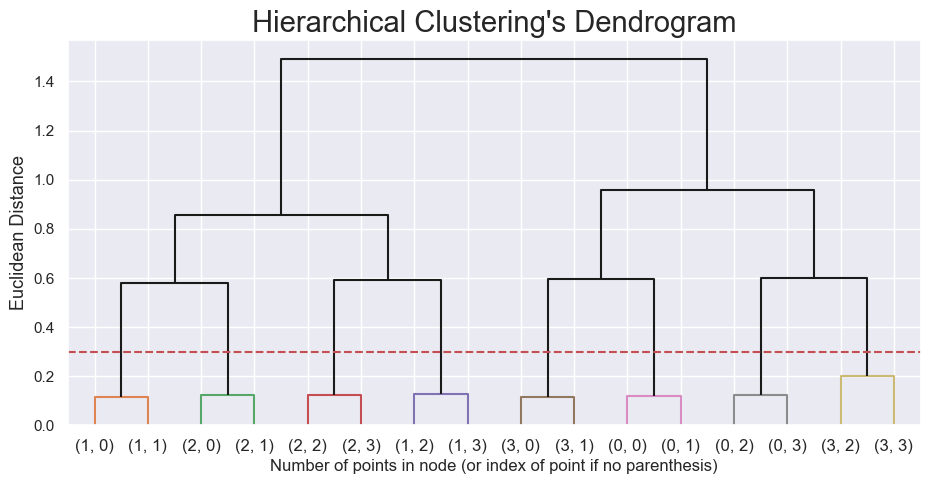

In [553]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 0.3
dendrogram(linkage_matrix, truncate_mode='level', labels=df_cluster_centroids_4.index, p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f"Hierarchical Clustering's Dendrogram", fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

In [554]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    n_clusters=8
)
hclust_labels_4 = hclust.fit_predict(df_cluster_centroids_4)
df_cluster_centroids_4['labels'] = hclust_labels_4

df_cluster_centroids_4

FirstPolYear  ClaimsRate  \
kmeans_value4_cluster kproto_demo4_cluster                             
0                     0                         0.685487    0.466886   
                      1                         0.756248    0.465100   
                      2                         0.218125    0.459743   
                      3                         0.327133    0.472566   
1                     0                         0.674389    0.593212   
                      1                         0.748426    0.601015   
                      2                         0.224789    0.603814   
                      3                         0.344218    0.598173   
2                     0                         0.688899    0.207717   
                      1                         0.749171    0.172444   
                      2                         0.233917    0.180263   
                      3                         0.348014    0.188856   
3                     0                         0.721754    0.390555   
                      1                         0.781763    0.407725   
                      2                         0.155724    0.427360   
                      3                         0.334587    0.411909   

                                            PremMotor  PremHousehold  \
kmeans_value4_cluster kproto_demo4_cluster                             
0                     0                      0.380418       0.141835   
                      1                      0.399640       0.140627   
                      2                      0.402884       0.135411   
                      3                      0.372726       0.153107   
1                     0                      0.680464       0.079799   
                      1                      0.737963       0.075298   
                      2                      0.735676       0.072034   
                      3                      0.709957       0.086868   
2                     0                      0.649601       0.098642   
                      1                      0.719969       0.081036   
                      2                      0.716801       0.080405   
                      3                      0.685976       0.098067   
3                     0                      0.204243       0.294286   
                      1                      0.191607       0.305653   
                      2                      0.205413       0.271598   
                      3                      0.186564       0.325880   

                                            PremHealth  PremLife  PremWork  \
kmeans_value4_cluster kproto_demo4_cluster                                   
0                     0                       0.556466  0.132555  0.142490   
                      1                       0.525338  0.134165  0.149774   
                      2                       0.544323  0.122467  0.137937   
                      3                       0.527982  0.149718  0.160738   
1                     0                       0.306444  0.076716  0.081101   
                      1                       0.256314  0.060051  0.075970   
                      2                       0.265491  0.059896  0.069937   
                      3                       0.262409  0.074689  0.090333   
2                     0                       0.325462  0.083034  0.090692   
                      1                       0.266791  0.065595  0.079598   
                      2                       0.274282  0.064454  0.077508   
                      3                       0.270760  0.081555  0.090640   
3                     0                       0.373183  0.317547  0.297732   
                      1                       0.360328  0.317031  0.324489   
                      2                       0.366088  0.336484  0.311427   
                      3                       0.353501  0.314495  0.323550   

                                            s

In [555]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper_4 = df_cluster_centroids_4['labels'].to_dict()


# Mapping the hierarchical clusters on the centroids to the observations
df_cluster['merged_clusters4'] = df_cluster.apply(
    lambda row: cluster_mapper_4[
        (row['kmeans_value4_cluster'], row['kproto_demo4_cluster'])
    ], axis=1
)

# Merged cluster centroids
df_cluster.groupby('merged_clusters4').mean()[metric_features]

,FirstPolYear,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,sqrt_RatioPremSalary
merged_clusters4,,,,,,,,
0,0.295061,0.415323,0.190730,0.313885,0.356283,0.319354,0.320871,0.331332
1,0.271907,0.601588,0.725529,0.077886,0.264275,0.065732,0.077984,0.123372
2,0.734813,0.180847,0.703207,0.085230,0.280767,0.069750,0.082241,0.122901
3,0.720011,0.466015,0.389797,0.141246,0.541279,0.133340,0.146044,0.144629
4,0.276486,0.466608,0.386739,0.144885,0.535574,0.137057,0.150144,0.167685
5,0.757093,0.400666,0.196801,0.300980,0.365613,0.317243,0.313489,0.292786
6,0.277821,0.183569,0.704940,0.087201,0.272927,0.071034,0.082561,0.127986
7,0.731881,0.599271,0.725114,0.076304,0.267517,0.063775,0.077117,0.117326


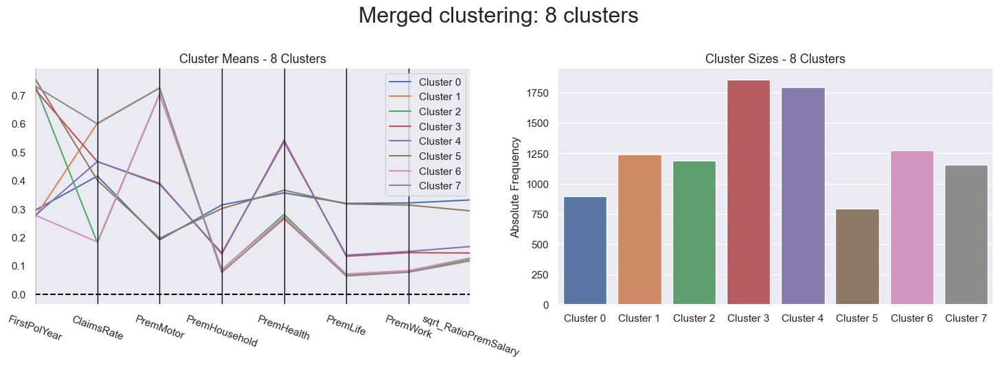

In [556]:
cluster_profiles(
    df = df_cluster[metric_features + ['merged_clusters4']], 
    label_columns = ['merged_clusters4'], 
    figsize = (18, 5),
    palette = ["C0", "C1","C2","C3", 'C4','C5','C6', 'C7'],
    title = 'Merged clustering: 8 clusters'
)


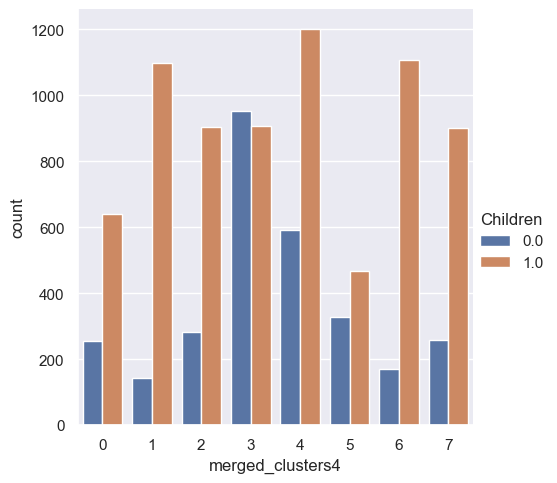

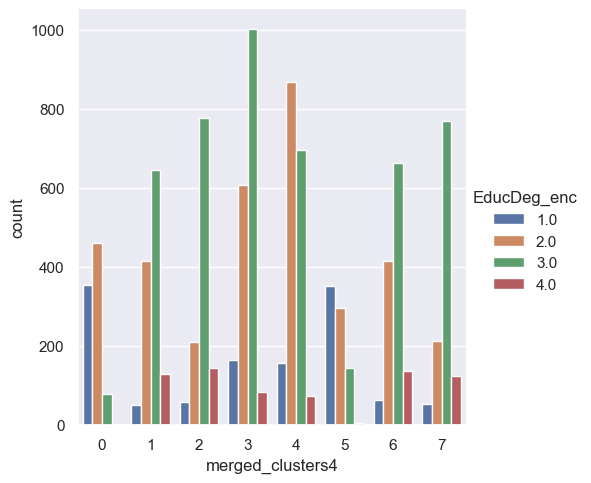

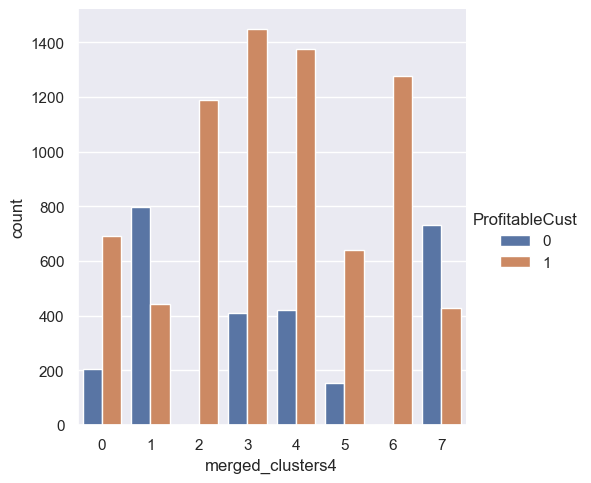

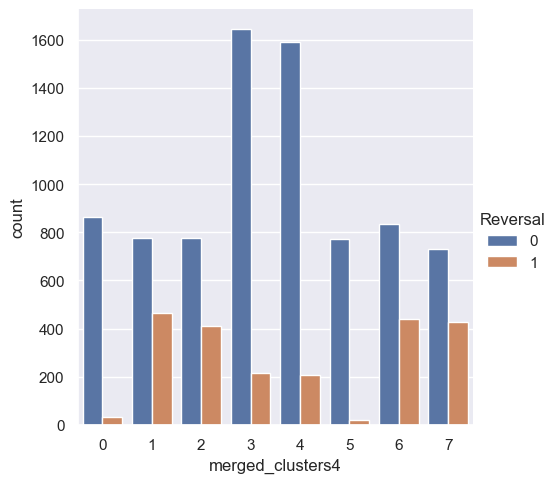

In [557]:
for feat in cat_features:
    sns.catplot(x ='merged_clusters4', data=df_cluster, hue = feat, kind ='count',palette =["C0","C1","C2","C3"])
#    plt.legend(labels = ['No Disease', 'Disease'], loc = 'lower right',fontsize =10,borderpad = 0.2, handlelength = 1.2)

plt.show()

C:\Users\kikal\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\kikal\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


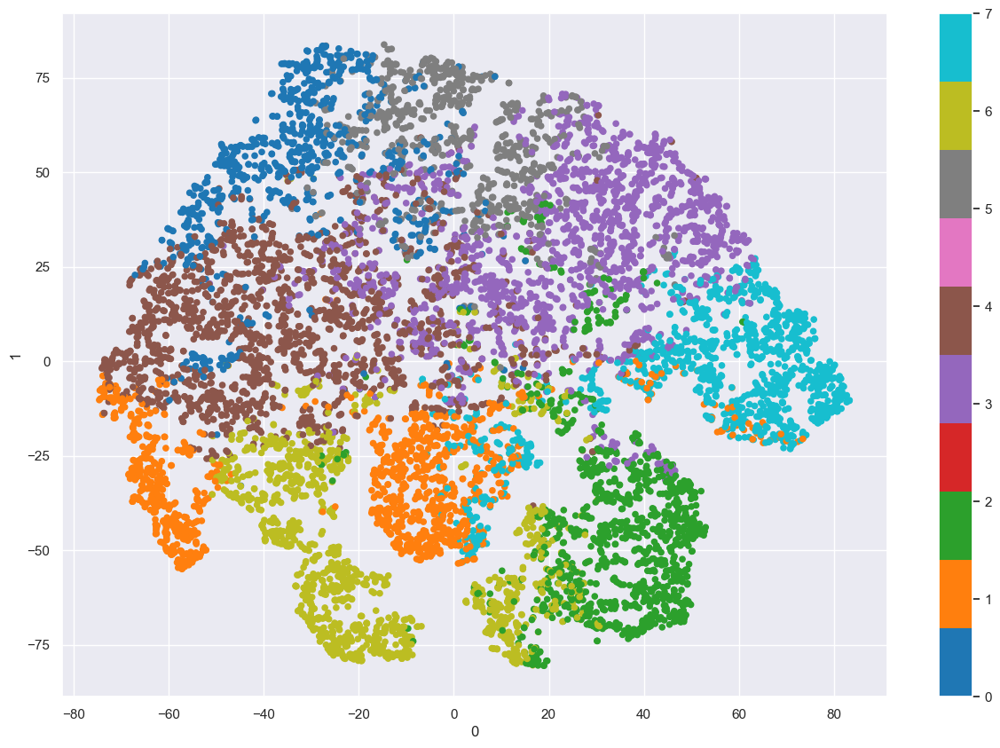

In [558]:
two_dim = TSNE(random_state=42).fit_transform(df_final[metric_features])
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=df_cluster['merged_clusters4'], colormap='tab10', figsize=(15,10))

plt.show()

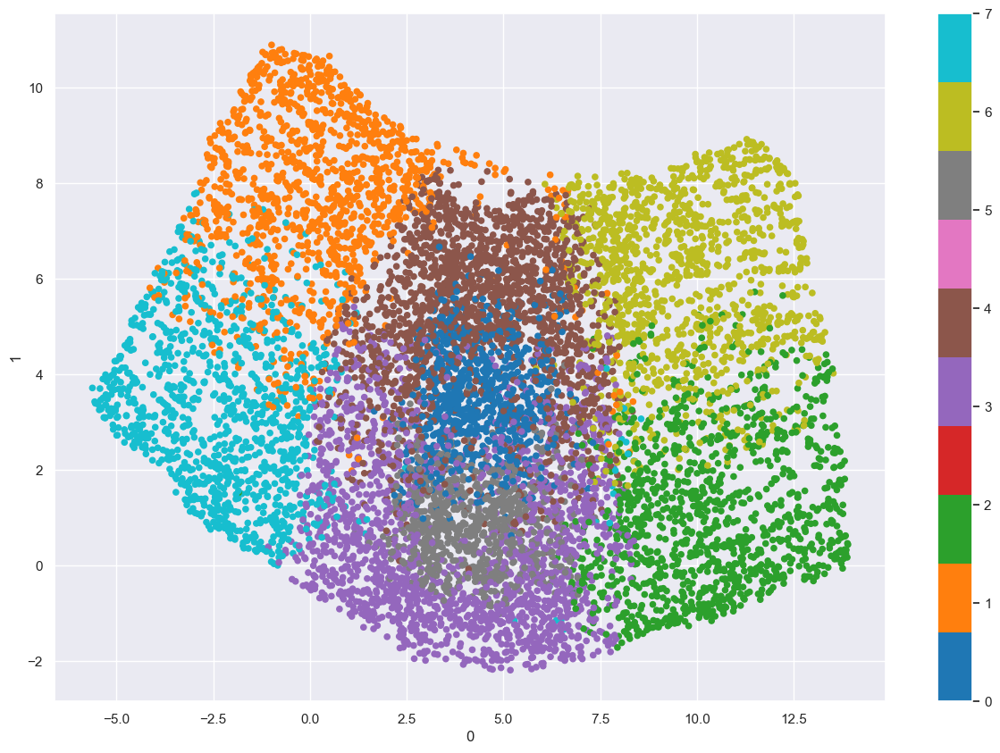

In [559]:
two_dim_umap = umap_map.fit_transform(df_final[metric_features])
pd.DataFrame(two_dim_umap).plot.scatter(x=0, y=1, c=df_cluster['merged_clusters4'], colormap='tab10', figsize=(15,10))

plt.show()

Decision Tree

In [560]:
# Preparing the data
X = df_cluster[metric_features + cat_features]
y = df_cluster.merged_clusters4

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth=4)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 81.19% of the customers correctly


In [561]:
# Assessing feature importance
pd.Series(dt.feature_importances_, index=X_train.columns)

FirstPolYear            0.427195
ClaimsRate              0.176186
PremMotor               0.284571
PremHousehold           0.000000
PremHealth              0.103069
PremLife                0.000000
PremWork                0.000000
sqrt_RatioPremSalary    0.000000
Children                0.001310
EducDeg_enc             0.007669
ProfitableCust          0.000000
Reversal                0.000000
dtype: float64

## Visualizing the decision tree


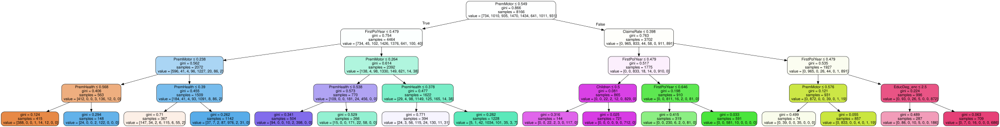

In [562]:
dot_data = export_graphviz(dt, out_file=None, 
                           feature_names=X.columns.to_list(),
                           filled=True,
                           rounded=True,
                           special_characters=True)  
graphviz.Source(dot_data)